<style>
    div.output_area pre {
        white-space: pre-wrap !important;
        word-break: break-word;
    }
    div.input_area pre {
        white-space: pre-wrap !important;
        word-break: break-word;
    }
</style>

In [2]:
# Data and numerical packages
import pandas as pd
import numpy as np

# Machine learning & modeling
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, root_mean_squared_error
from scipy.optimize import curve_fit
from scipy.interpolate import interp1d

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Progress bar
import tqdm

# File and system utilities
from pathlib import Path
import sys
from io import StringIO
# import display, image
from IPython.display import display, Image

# Set up base paths
NOTEBOOK_PATH = Path(__file__).resolve() if '__file__' in globals() else Path().resolve()
PROJECT_ROOT = NOTEBOOK_PATH.parent

# Data and output paths
RAW_DATASET_PATH = PROJECT_ROOT / '01_datasets' / 'raw'
PROCESSED_DATASET_PATH = PROJECT_ROOT / '01_datasets' / 'processed'
FIGURES_PATH = PROJECT_ROOT / '04_outputs' / '01_figures'
TABLES_PATH = PROJECT_ROOT / '04_outputs' / '02_tables'
SCRIPTS_PATH = PROJECT_ROOT / '03_scripts'


## 2 Turbine Telemetry Supply 



### 2.1 Turbine Data Exploration

#### 2.1.1 Handling Missing Data
Before any modeling or inference, it is critical to assess the quality and continuity of the turbine telemetry data. Our dataset spans from May 28, 2015 to January 11, 2018 and includes three key variables: turbine power output (turbine_power_kw), maximum setpoint (turbine_setpoint_kw), and wind speed at hub height (wind_baseline_ms).

We first checked for null (NaN) values: 2,702 were found in power output, 2,715 in setpoint, and 2,705 in wind speed. Though small relative to over 1 million rows, these values are not uniformly distributed and can distort modeling if unaddressed. Visual inspection showed gaps often occurred during active periods—suggesting sensor dropouts or ingestion delays, not downtime.

Next, we assessed implicit missingness by calculating timestamp differences. The most common interval was 60 seconds, confirming intended 1-minute resolution. However, 143 unique gaps were found, including extended losses spanning minutes to days—especially in early 2015 and during seasonal transitions, likely due to device or network issues.

Given multiple long gaps, including a 6-month loss in 2015, we dropped all 2015 data. This preserves annual completeness for seasonal and curtailment modeling and avoids bias in yearly comparisons.

[See Appendix 2.1.1 for code implementation](#appendix-2-1-1)



#### 2.1.2 Structuring Time Series
A small portion of entries had sub minute logging, often showing a zero-power reading followed quickly by a spike. These artifacts skewed rolling averages and misrepresented turbine activity. To detect these, we flagged ingestion delays where power was zero, wind exceeded 3 m/s, and a power spike above 5 kW occurred within the next two readings—identifying 269 such cases.

We also estimated the turbine’s operational cut-in speed using power outputs above 10 kW to avoid noise. The 10th percentile of wind speed in these cases was ~4.9 m/s—consistent with small-to-medium turbine specifications.

To support 30-minute averaging and power modeling, we forward-filled short, isolated gaps (less than 2–3 minutes) only if wind speed was non-zero and setpoint above 850 kW, avoiding interpolation during curtailment or shutdown periods. This selective imputation helped maintain rolling mean integrity.

To enforce uniform one-minute spacing, we grouped multiple entries per minute and retained only the last. We then reindexed the dataset to a continuous minute-by-minute timeline, exposing over 45,000 new missing entries useful for identifying outages and applying consistent imputation logic.

This cleaned, regularly spaced one minute dataset forms a reliable foundation for downstream resampling, curtailment detection, and alignment with residential demand analysis.

[See Appendix 2.1.2 for code implementation](#appendix-2-1-2)


#### 2.1.3 Period of Zero Turbine Power
To investigate periods where the turbine generated no power, we identified all timestamps where the turbine_power_kw value was zero and grouped consecutive such instances into distinct zero-output intervals. For each of these periods, we calculated the duration, the count of zero readings, as well as the corresponding wind speed and setpoint statistics. This helped us interpret whether the zero-output was due to operational decisions or natural conditions.

Our analysis revealed multiple causes for prolonged periods of zero turbine output. In some cases, both power and setpoint were zero, pointing to planned maintenance or scheduled downtime. Other periods showed high setpoints but zero output, suggesting curtailment due to grid limitations or safety-triggered shutdowns during extreme wind conditions. We also encountered instances of zero power with normal setpoints and wind speeds, which likely indicate sensor malfunctions or data logging issues.

These findings are critical for differentiating between expected turbine behavior and abnormal events, laying the groundwork for further curtailment and reliability analysis.

[See Appendix 2.1.3 for code implementation](#appendix-2-1-3)


### 2.2 Time Series Analysis

#### 2.2.1 STL Decomposition

To observe overall patterns in power generation over time, we aggregated the turbine data into monthly averages. This helped smooth out daily fluctuations and gave us a clearer picture of long-term behavior.

The analysis revealed a strong seasonal pattern in power output. Power generation tends to peak during winter months and drops noticeably during the summer. This seasonal variation is expected in a wind-based system and highlights how generation is closely tied to weather conditions in Orkney.

To explore these trends in more detail, we used time series decomposition to break down the data into three parts: the general trend, seasonal cycles, and remaining noise. The decomposition confirmed that we have a gradual increase in power generation over time,a clear, repeating seasonal effect, and a very little unexpected variability, meaning the data is stable and reliable.

These insights confirm that the turbine is performing as expected over the two-year period and help us understand when renewable energy is most available, an important factor when planning demand response strategies.

[See Appendix 2.2.1](#appendix-2-2-1)


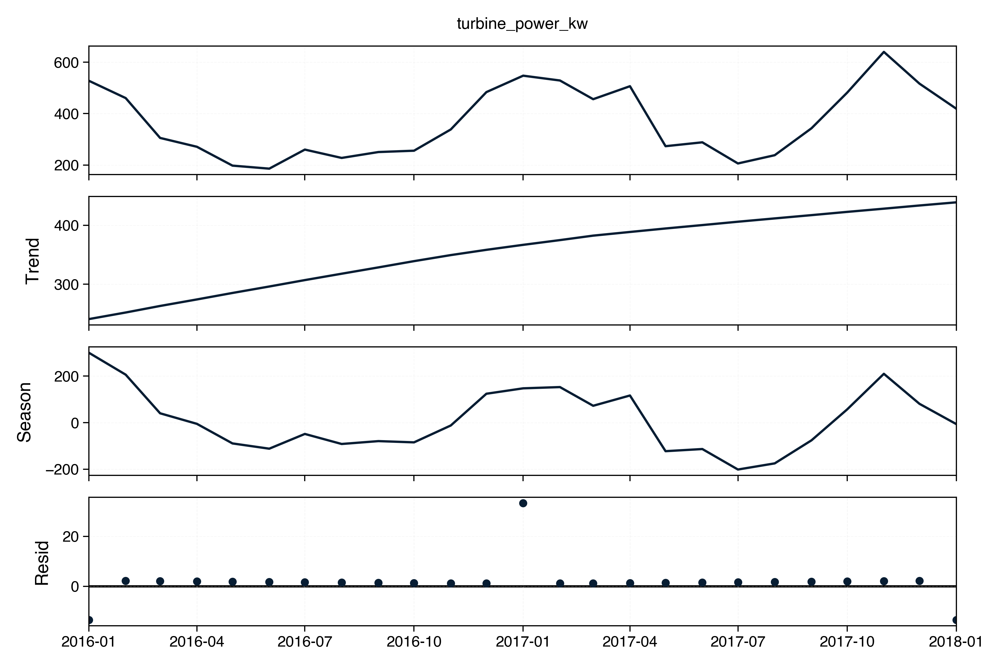

In [3]:
display(Image(str(FIGURES_PATH / 'figure_2-2-1.png')))

### 2.3 Power Curve and Wind Relationship

Understanding the relationship between wind speed and turbine power output is crucial for modeling turbine behavior and estimating energy generation potential. In this section, we explore this relationship using both parametric and non-parametric methods namely the Weibull distribution model and the binning method.

#### 2.3.1 Visualizing Wind Speed and Power Relationship

To begin, we plotted the turbine power output against wind speed using a dense scatter plot. This visualization clearly reveals the characteristic S-shaped power curve typical of wind turbines.

[See Appendix 2.3.1](#appendix-2-3-1)


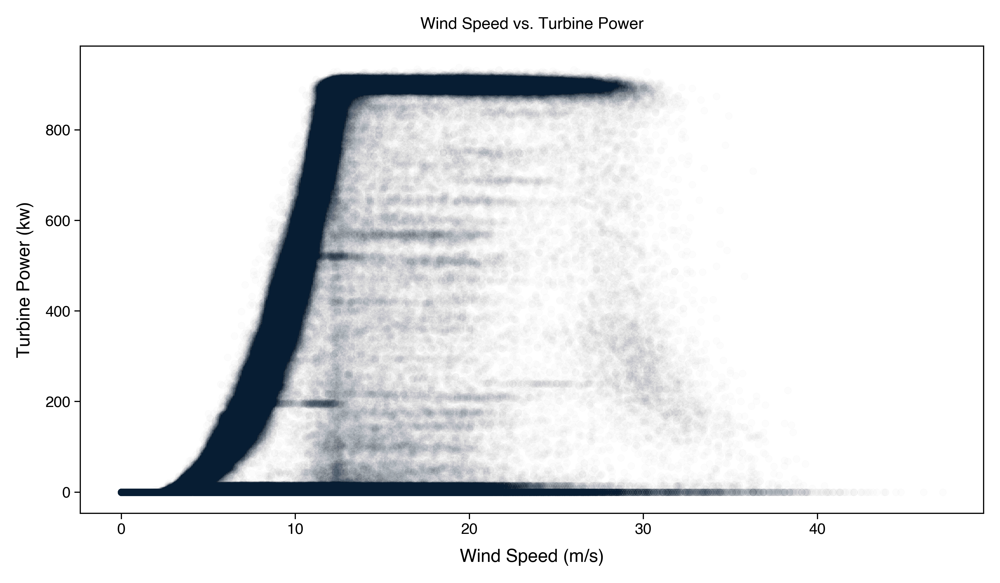

In [4]:
#Figure Placeholder: Dense Scatter Plot of Wind Speed vs Turbine Power
display(Image(str(FIGURES_PATH / 'figure_2-3-1.png')))

#### 2.3.2 Power Curve Estimation

To enhance clarity, a less-dense version of the scatter plot is presented alongside, where lower opacity and point filtering provide a cleaner view of the power curve pattern.

[See Appendix 2.3.2](#appendix-2-3-2)


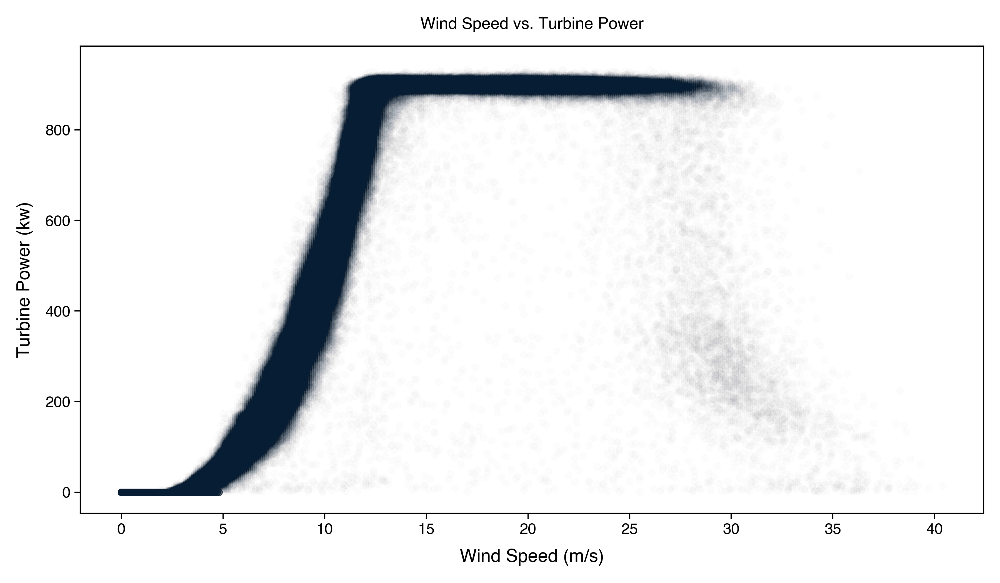

In [5]:
display(Image(str(FIGURES_PATH / 'figure_2-3-2.png')))

From the visual analysis of the wind speed versus power output, we can clearly distinguish four operational regions of the turbine. At wind speeds below approximately 4 to 5 meters per second, the turbine does not produce any power. This is known as the cut-in region, where the wind force is insufficient to overcome mechanical inertia and initiate power generation. As the wind speed increases beyond this point, the turbine enters the cubic growth region, typically between 5 and 11 meters per second. In this phase, the power output rises rapidly, following a cubic relationship with wind speed, due to increasing rotational speed and energy capture.

Once the wind speed exceeds approximately 11 meters per second, the turbine reaches its rated region, where the power output stabilizes near its maximum capacity which is around 900 kilowatts in our case. Here, turbine control mechanisms like blade pitch adjustment or generator regulation are employed to maintain constant output and prevent mechanical stress. Finally, when wind speeds exceed the safe operational threshold, generally between 25 to 28 meters per second, the turbine undergoes a cut-out shutdown. This safety measure prevents potential damage from extreme wind conditions, resulting in a sharp drop in power output. These observed behaviors closely align with standard wind turbine performance characteristics and manufacturer specifications.


##### 2.3.2.1 Weibull Distribution Model

To derive the power curve using the baseline wind speed and power output we will use a derivation of weibull distribution model to measure the distribution.


$$
P(\nu) = P_r \left(1 - e^{- \left(\frac{\nu - v_0}{c}\right)^3} \right)
$$

Where:

* $\nu$ = wind speed
* $v_0$ = minimum wind speed (`cut_in_speed`)
* $c$ = scale parameter
* $P_r$ = rated power
  


[See Appendix 2.3.2 - Weibull Model](#weibull-model)


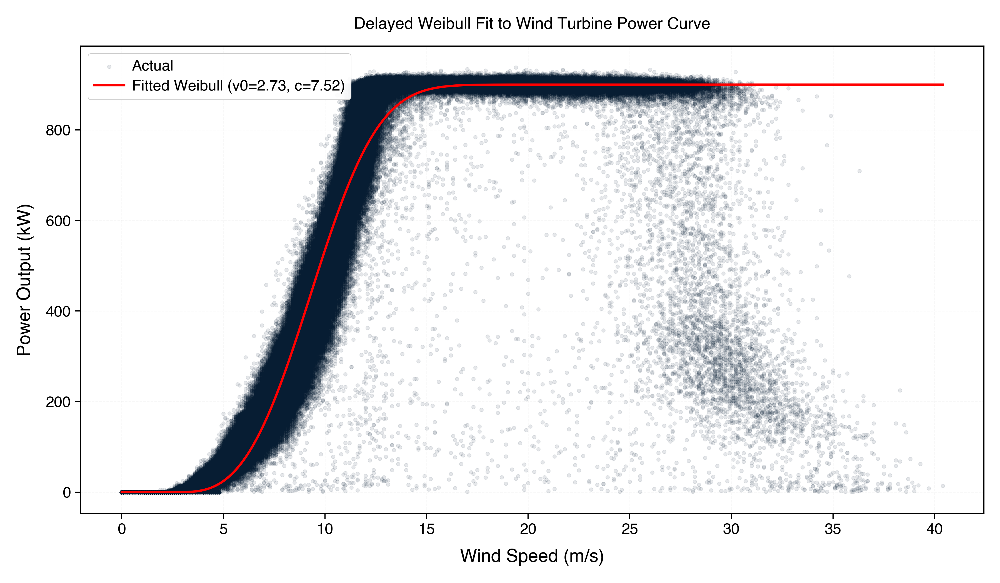

In [6]:
#Figure Placeholder: Light Scatter Plot of Wind Speed vs Turbine Power
display(Image(str(FIGURES_PATH / 'figure_2-3-2-1.png')))


##### 2.3.2.2 Binning Method

To further examine the relationship between wind speed and turbine power output, we employed a binning method to derive an empirical power curve. In this approach, we grouped wind speed values into discrete bins of 0.5 m/s intervals, calculating the mean wind speed and corresponding average power output within each bin. This smoothing technique is useful for reducing noise in scatter plots and reveals the underlying functional pattern of power generation more clearly. The resulting binned curve exhibited a characteristic S-shape, similar to theoretical power curves, confirming the validity of this non-parametric modeling technique.

[See Appendix 2.3.2 - Binning Model](#binning-model)


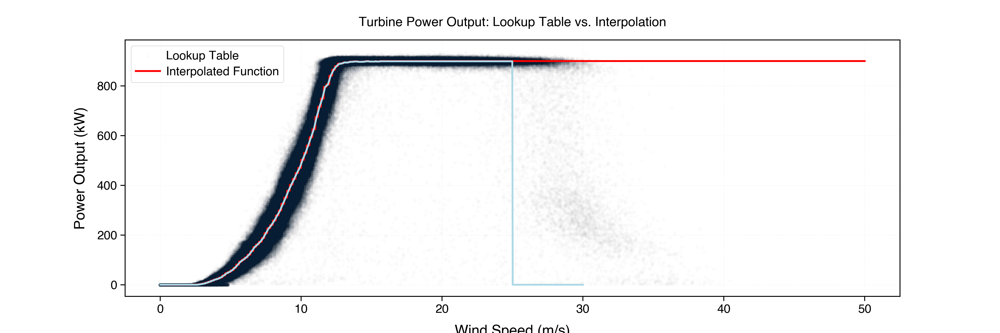

In [7]:
#place holder: Plot of the Estimated Turbine Power Curve (Binned Method) here

display(Image(str(FIGURES_PATH / 'figure_2-3-2-3.png')))

##### 2.3.2.3 Power Curve Model Comparison

To evaluate which method performed better, we compared the binning and Weibull models using standard error metrics: R² (coefficient of determination), RMSE (root mean squared error), MAE (mean absolute error), and MSE (mean squared error). The Weibull model achieved a higher R² value, indicating better explanatory power for the observed variance in power output. It also demonstrated lower RMSE and MSE values, implying fewer large prediction errors. Although the binning method had a slightly lower MAE indicating smaller average errors, the Weibull model outperformed in all other critical metrics.

In [8]:
#place holder: Table comparing Weibull and Binning method performance metrics
table_2_3_2_3 = pd.read_pickle(TABLES_PATH / 'table_2-3-2-3.pkl')
display(table_2_3_2_3)

,Metric,Value_weibull,Value_binning
0,R^2,0.961444,0.917183
1,RMSE,65.974801,96.692293
2,MAE,38.533740,33.660188
3,MSE,4352.674347,9349.399594


Given these results, the Weibull model was deemed the better choice for estimating the turbine power curve due to its stronger overall performance and greater generalizability beyond the training data.

#### 2.3.3 Cut-in and Cut-out Speed Estimation
To further characterize the turbine’s operational behavior, we estimated its cut-in and cut-out wind speed thresholds based on empirical data and quantile analysis. These thresholds define the minimum and maximum wind speeds at which the turbine actively generates power, and are essential for curtailment modeling and demand-response alignment.

We calculated the cut-in speed using the 5th and 10th percentiles of wind speeds where the power output was consistently above 0 kW. These thresholds corresponded to wind speeds of approximately 4.30 m/s and 4.90 m/s respectively. Below these levels, the turbine remains inactive, as the wind does not provide enough kinetic energy to overcome startup inertia or generate stable output.

Similarly, the cut-out speed, above which the turbine shuts down to prevent mechanical stress or damage—was estimated using the 95th and 99th percentiles of wind speed. These values were found to be approximately 23.90 m/s and 26.70 m/s, aligning with industry-standard safety thresholds. During such high-wind events, turbine controllers trigger shutdown protocols, leading to a sudden drop in power output despite high available wind energy.

The following visualization highlights these thresholds superimposed on the power curve, showing clearly where the turbine begins and ceases to generate power:

[See Appendix 2.3.3](#appendix-2-3-3)


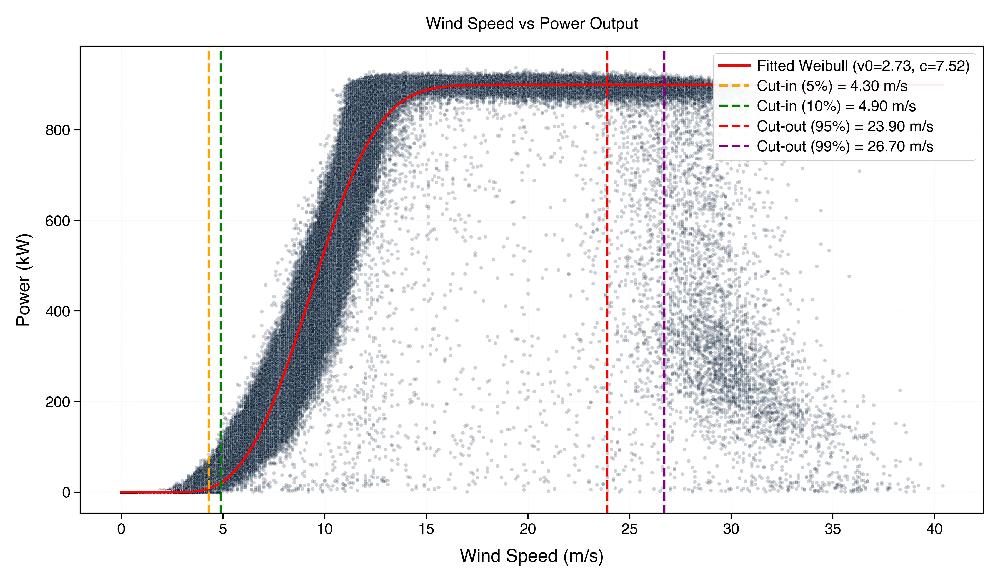

In [9]:
#placeholder : Figure showing Wind Speed vs Power with vertical lines for Cut-in and Cut-out thresholds
display(Image(str(FIGURES_PATH / 'figure_2-3-3.png')))

Understanding these bounds allows us to isolate periods of forced curtailment, where power is limited despite being within operational wind ranges from natural shutdowns due to environmental limits. This distinction is vital for accurately estimating curtailment losses and modeling demand response potential.

### 2.4 Relationship of Power and Setpoint

To assess turbine performance relative to its operational targets, we analyzed instances where the actual power output exceeded the turbine setpoint. On average, the power exceeded the setpoint by 17.8 kW, with a maximum deviation of 915 kW. These exceedances were observed in over 133,000 records, suggesting that such events are frequent and warrant closer examination.

To further contextualize these exceedances, we classified the data into percentage bins, representing how much the turbine power output surpassed the setpoint. The majority of cases fell within the 0–10% exceedance range, indicating mostly minor deviations. However, some instances showed much higher exceedances, particularly when the setpoint was artificially lowered, possibly due to curtailment or shutdown procedures.

Additionally, we observed instances where the setpoint dropped to zero while power output remained temporarily positive. This behavior typically signals a controlled turbine shutdown. The turbine, though commanded to stop, continues to generate power for a short duration due to the residual motion of the blades. These shutdown sequences were generally smooth and deliberate, aligning with scheduled maintenance or curtailment instructions.

In contrast, other cases displayed sharp drops and subsequent recoveries in setpoint, often accompanied by a delay in power response. These short-duration events are indicative of grid-driven curtailments, such as congestion management or frequency regulation, where setpoints are temporarily reduced and restored once the issue is resolved.

The distribution of these different types of curtailment across the dataset is summarized in the following figure:


[See Appendix 2.4](#appendix-2-4)



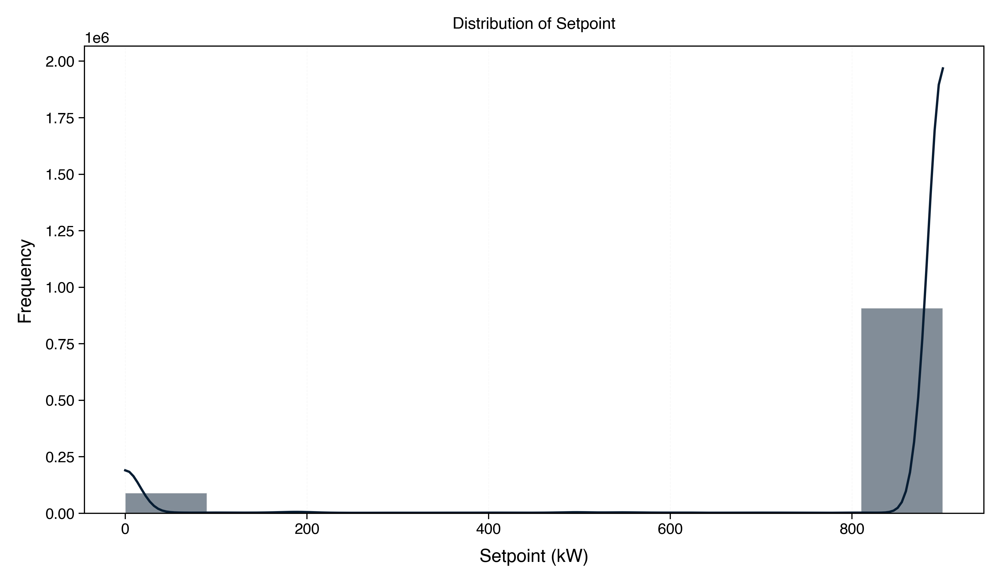

In [136]:
# Placeholder - Insert bar chart or stacked plot comparing curtailment categories across different years here
# note check the 2018 grapgh its not right since its only 11 days
display(Image(str(FIGURES_PATH / 'figure_2-5.png')))

This breakdown highlights how turbine control responses have evolved over time and helps quantify the impact of operational constraints on actual power delivery. These patterns form the foundation for the more detailed curtailment classification in the following section.

### 2.5 Resampling Dataset to 30 Minute

explain why we need to resample to half an hour here.

[See Appendix 2.5](#appendix-2-5)


#### 2.5.1 Theoretical (Potential) Power Output

bla bla bla
[See Appendix 2.5.1](#appendix-2-5-1)


### 2.6 Energy Calculation

To assess the actual impact of curtailment on energy output, we convert power values (in kilowatts) into energy (in kilowatt-hours). Since the data has been resampled to 30-minute intervals, each row represents half an hour of turbine activity. Hence, the energy generated or curtailed in each interval is calculated by multiplying the power value by 0.5. This gives a more realistic representation of how much potential energy was lost due to curtailment over time.

We compute three energy metrics:

- Actual Energy Output (kWh) from the turbine  
- Maximum Theoretical Energy (kWh) assuming no constraints (based on wind conditions)  


These metrics are defined using the following formulae:

$$
\text{Turbine Energy (kWh)} = \text{Turbine Power (kW)} \times 0.5
$$

$$
\text{Maximum Possible Energy (kWh)} = \text{Max Power (kW)} \times 0.5
$$


### 2.7 Curtailment
In the Orkney energy system, the Active Network Management (ANM) system plays a critical role in managing grid stability by limiting the amount of electricity that wind turbines can export to the mainland. This is done by dynamically assigning a setpoint to each turbine, which acts as a cap on power output. When the setpoint is below the turbine’s potential maximum, curtailment occurs.

To detect curtailment, we compute the curtailed power as the difference between the turbine’s theoretical maximum output (based on wind speed) and its actual output, whenever the setpoint is less than 900 kW. If the turbine is not curtailed (setpoint = 900 kW), curtailed power is defined as zero. Any negative differences are also zeroed to avoid misclassification.

[See Appendix 2.7](#appendix-2-7)


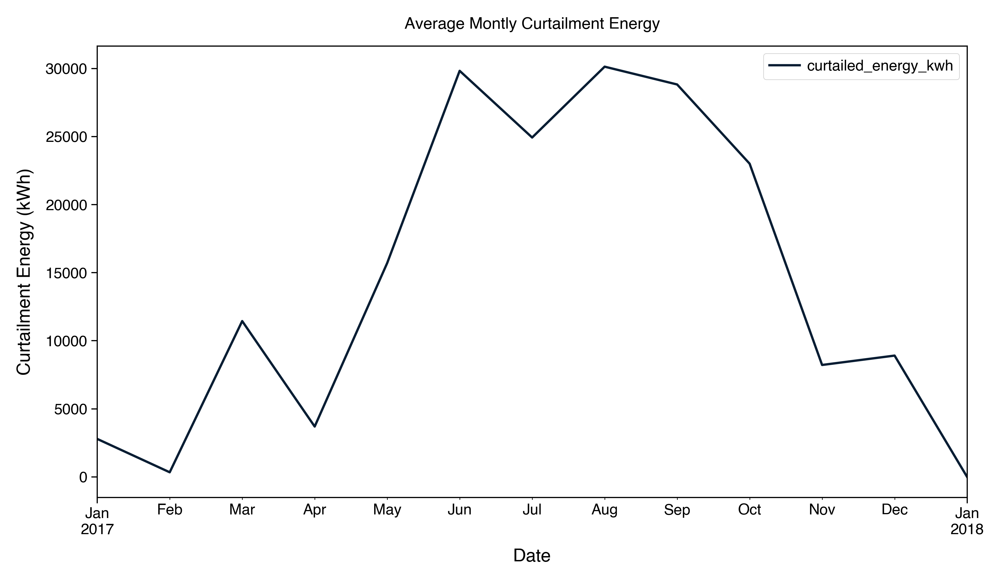

In [ ]:
# Placeholder: Average Monthly Curtailment Energy (Line Plot)
display(Image(str(FIGURES_PATH / 'figure_2-7_1.png')))

From the visual, it is evident that curtailed energy peaks during the summer months, likely due to a combination of stronger winds and tighter grid constraints during this period. In contrast, winter months experience relatively low curtailment, reflecting reduced generation potential or fewer export limitations.

To further understand the seasonal impact, we calculate the proportion of curtailed energy relative to the total available energy (curtailed + actual). This proportion is highest in summer (~45%), followed by autumn, while winter shows the least curtailment. This seasonal variation emphasizes the importance of adaptive grid control and highlights where efficiency improvements could be targeted.

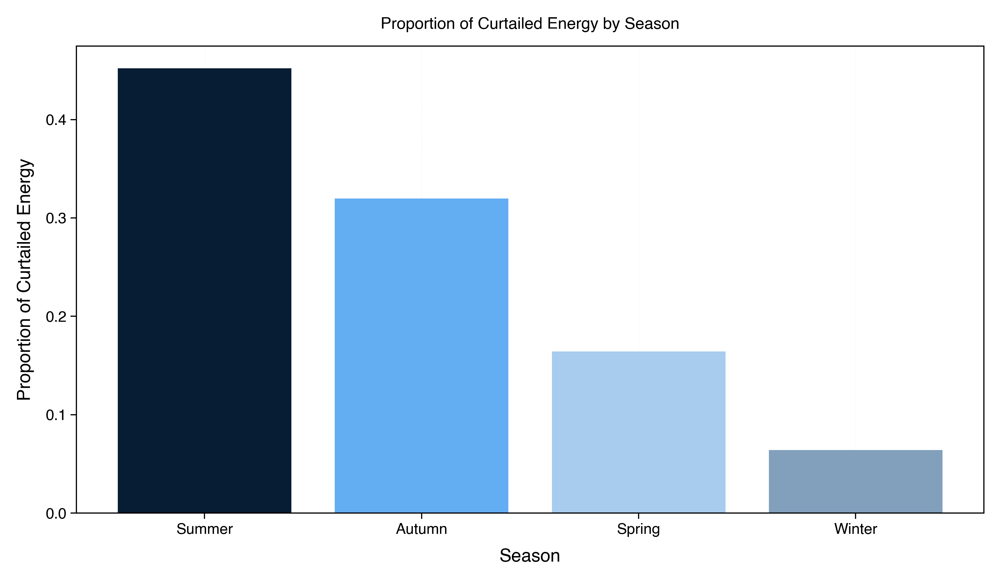

In [151]:
#Placeholder: Proportion of Curtailed Energy by Season (Bar Plot)
display(Image(str(FIGURES_PATH / 'figure_2-7_2.png')))

#### 2.7.1 Curtailment Patterns by Time
To understand curtailment behaviour, we analysed seasonal and monthly trends. The average hourly curtailment by season reveals that summer and autumn experience higher curtailment levels, particularly in the early afternoon. This may be due to stronger winds and limited export capacity during these times.

The monthly curtailment pattern shows a peak between June and September, aligning with periods of high wind generation and tighter grid constraints. Curtailment falls sharply in winter months, reflecting reduced turbine output and thus lower need for regulation.

[See Appendix 2.7.1](#appendix-2-7-1)


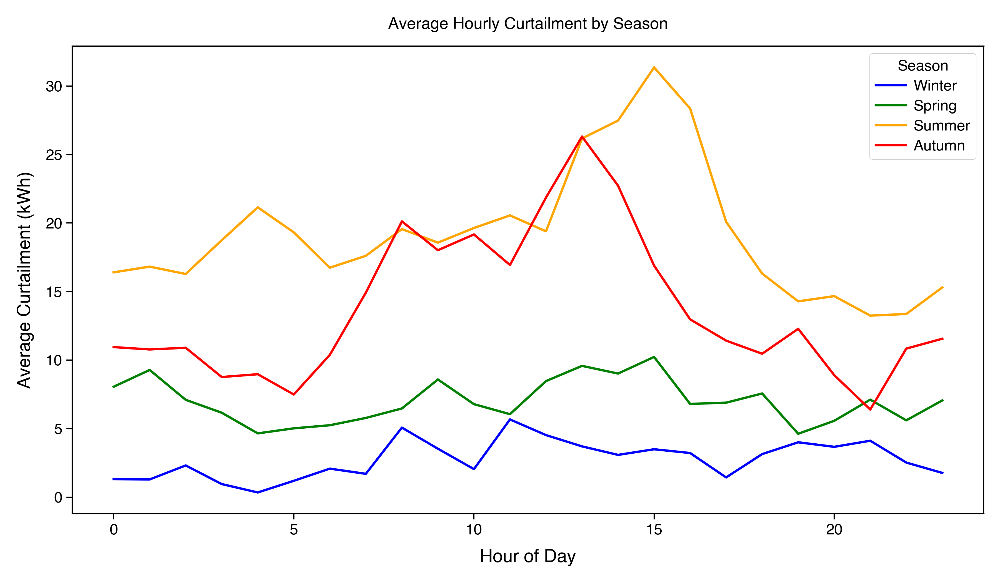

In [153]:
#place holder:Figure Average Hourly Curtailment by Season & Average Monthly Curtailment Power
display(Image(str(FIGURES_PATH / 'figure_2-7-1.png')))

#### 2.7.2 Monthly Output and Setpoint Trends
We compare actual power output with the maximum potential output to visualize curtailment across the year. The shaded gap between these lines quantifies lost energy due to grid limits. The difference is especially visible mid-year.

We also observe the average monthly setpoint values alongside the ideal 900 kW cap. Setpoints often fall below the maximum during curtailment-heavy periods, confirming that ANM restrictions are being actively applied.

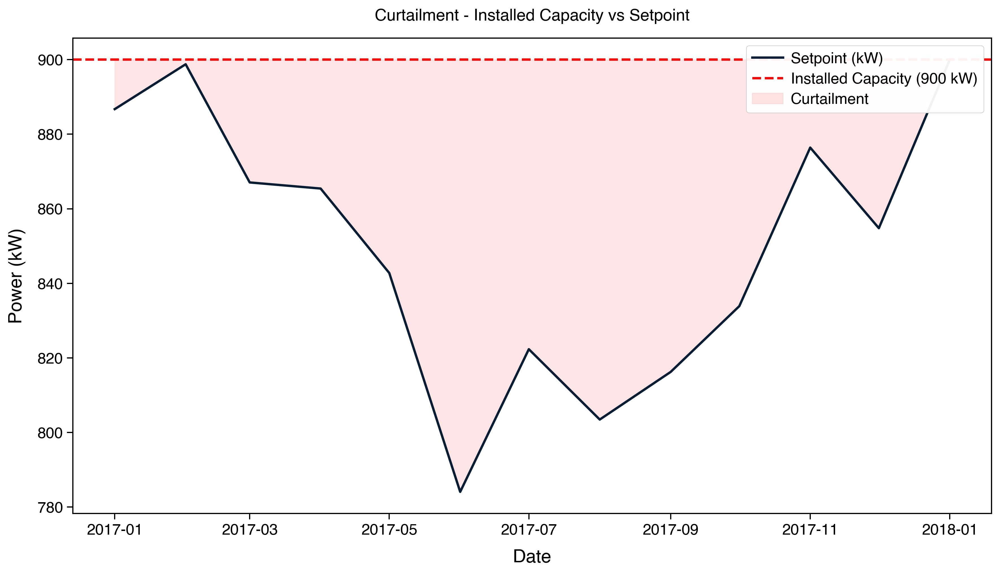

In [169]:
#placeholder : Actual vs Max Monthly Power Output with Curtailment Area & Curtailment Periods (Setpoint Trends with 900 kW Reference)
display(Image(str(FIGURES_PATH / 'figure_2-7-2.png')))

### 2.7.3 Curtailment Type Breakdown
Curtailment is categorised into:

- Fully curtailed: setpoint is 0 kW (no export allowed)

- Marginally curtailed: setpoint between 0 and 900 kW (partially restricted)

Our data shows that marginal curtailment dominates, comprising nearly 13% of observations, compared to ~3% that are fully curtailed. This indicates that the system prioritises partial limitations over complete shutdowns when regulating power.

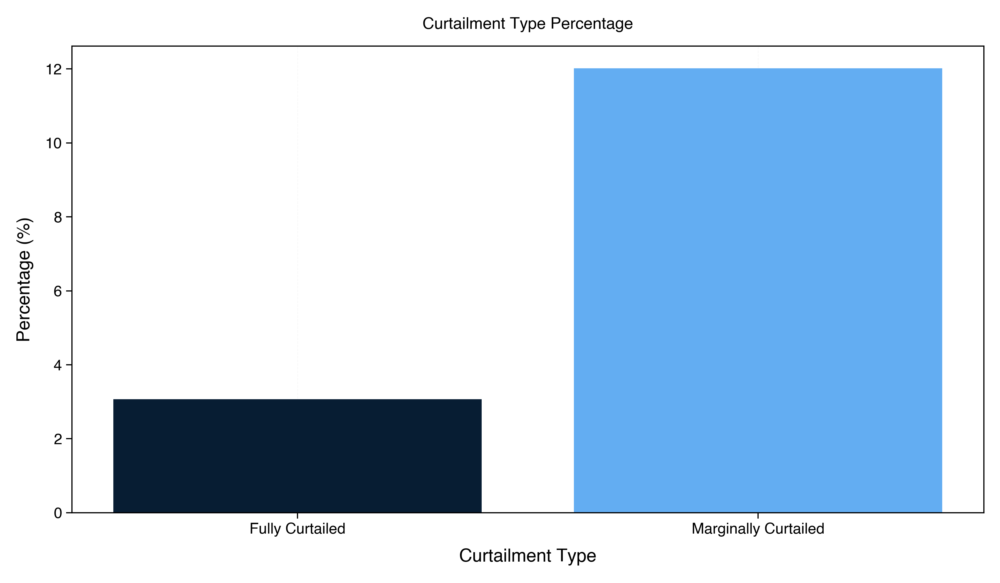

In [155]:
# Placeholder: Curtailment Type Breakdown by Percentage
display(Image(str(FIGURES_PATH / 'figure_2-7-3.png')))

### 2.7.4 Curtailment Proportion and Load Factor
The curtailment proportion indicates that approximately 11.03% of the potential turbine output is lost due to ANM restrictions. In contrast, the turbine load factor, a measure of actual generation vs full capacity is around 45.72%, suggesting that despite curtailments, the turbines still operate at a reasonable efficiency for an intermittently regulated system.

[See Appendix 2.7.4](#appendix-2-7-4)


## 2.8 Scaling Turbine Dataset

In [16]:
#Placeholder: Bar Chart or Table of Annual Energy & Curtailment

### 2.8.1 Scale Turbine with LIFO Logic

In this section, we simulate the Last In First Out (LIFO) curtailment policy implemented by the Active Network Management (ANM) system in Orkney. Under this system, newer turbines (commissioned later) are curtailed before older turbines whenever network constraints require reduced generation. This results in asymmetric curtailment across the fleet, with older turbines experiencing higher effective load factors over time due to their preferential dispatch.

##### Assumptions:

To create a simplified and consistent simulation:

- We use a normalized time series based representative data from Ore Brae Wind Farm, a turbine with:

    - Installed Capacity (IC) = 900 kW
    - Commissioning Date = 21/09/2011
    - Baseline Load Factor (LF_baseline) = 0.457228, calculated as:

$$
LF_{baseline} = \frac{\bar{P}_{OreBrae}}{IC_{OreBrae}} = \frac{411.5}{900} \approx 0.457228
$$

- The normalized generation profile is scaled to each turbine’s installed capacity using:

$$
P_{i,t} = P_{normalized,t} \times IC_i
$$

Each turbine is assigned a `relative_position` based on its commissioning order relative to Ore Brae:

- `relative_position` = 0: Baseline (Ore Brae)
- `relative_position` < 0: Older turbines → higher priority, less curtailment
- `relative_position` > 0: Newer turbines → lower priority, more curtailment

To simulate the impact of LIFO on generation, we adjust the load factor of each turbine based on its relative position. Specifically, we apply a linear multiplier to the baseline load factor:

$$
LF_i = LF_{baseline} \times (1 - r_i \cdot \delta)
$$

Where:

- $r_i$: relative_position of turbine $i$
- $\delta$: load factor change per position step (e.g., 0.02, or 2% per step)
- LF is clipped between 0.2 and 1.3 of baseline for realism

This adjustment simulates the cumulative disadvantage that newer turbines face under LIFO dispatch.

The adjusted generation profile is then rescaled to match the desired average power output implied by the new load factor:

$$
\hat{P}_{i,t}^{scaled} = LF_i \times IC_i
$$

$$
P_{i,t}^{scaled} = \min \left( P_{i,t}^{setpoint}, \, P_{i,t} \times \left( \frac{\hat{P}_{i,t}^{target}}{P_{i,t}^{original}} \right) \right)
$$


Finally, we aggregated the scaled turbine outputs by timestamp to generate a unified time series of system-wide power generation and curtailment, allowing comparison between baseline and LIFO dispatch scenarios.

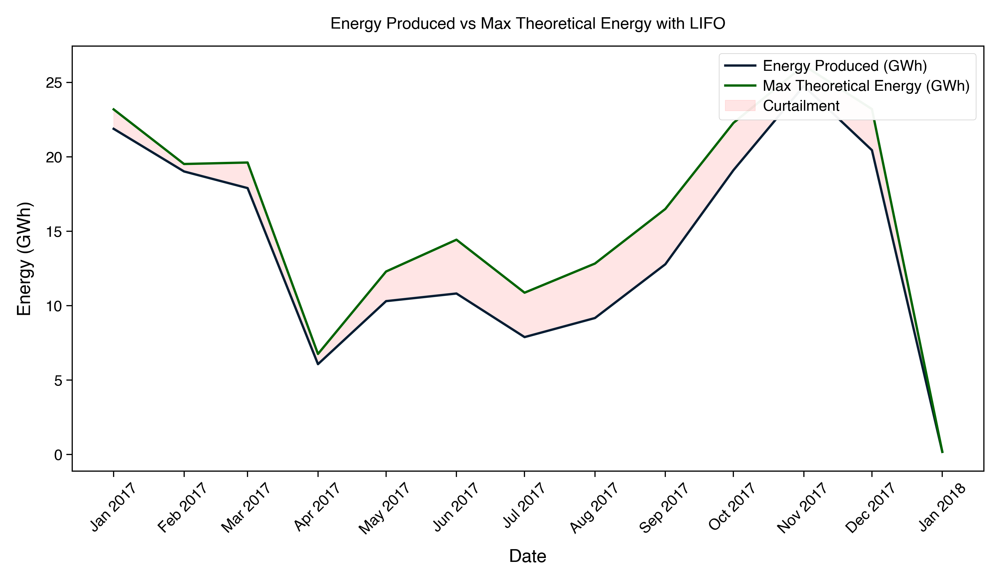

In [178]:
#Placeholder: Curtailment Comparison Plot – LIFO vs Standard
display(Image(str(FIGURES_PATH / 'figure_2-8-1.png')))

### DELETE SCRAPING PART (WE DONT NEED IT CAUSE WE'RE COMPARING BASELINE POWER AND THEORETICAL)

To address the gaps in our turbine telemetry dataset, we introduced external wind speed data scraped from timeanddate.com, specific to the Kirkwall region. Before using this data to impute missing values, we evaluated its quality by comparing it directly to the baseline wind speed measurements already present in our dataset.

We merged the scraped weather data with our 30-minute aggregated turbine dataset for the entire year 2017, aligning records on timestamp. This comparison allowed us to visually and statistically assess how well the two sources of wind measurements correlate.

---

The resulting scatter plot shows a strong linear relationship between scraped and baseline wind speeds. However, the scraped wind speed values consistently appear lower than their baseline counterparts. This bias could be attributed to several plausible causes, including
the geographic differences in measurement sites (e.g., elevation or surrounding terrain), variations in sensor placement and exposure,

Instrumentation differences between the turbine sensors and public weather stations.

Despite this systematic difference, the calculated Pearson correlation coefficient between the two sets of wind speed values is 0.84, indicating a strong and stable linear trend across the dataset. This high correlation suggests that the scraped wind data is reliable enough to be used for imputation, provided it is appropriately scaled.

Given the clear linear relationship and consistent underestimation by the scraped data, we proceeded with fitting a simple linear regression model. This model serves to adjust the scraped values to more closely reflect the turbine's baseline readings, enabling us to generate imputed values that maintain the statistical integrity of the original dataset.

---

After correcting the scraped wind speed values using linear regression, we proceeded to fill the missing values in the original baseline wind dataset. Specifically, we identified all time points where the wind_baseline_ms variable was missing and replaced those values with the corresponding predictions from the scaled and corrected wind_scraped_scaled_ms. This allowed us to preserve continuity in the dataset without resorting to dropping rows or interpolating based on less reliable assumptions.

To ensure transparency and traceability in the data integration process, we also created an additional column, wind_data_source, which explicitly tracks whether the wind speed value for a given timestamp came from the original baseline dataset or from the corrected scraped source. This distinction will be valuable in any subsequent analysis where the source of wind data may influence results or model behavior.

This approach ensured that no temporal information was lost, and all 30-minute intervals across the target period were retained for modeling and curtailment analysis.


## 3. Demand Side (Residential)
This section focuses on residential electricity usage in Orkney from January 1, 2017, to January 1, 2018. It aims to provide insights into household energy consumption patterns across different timeframes daily, seasonal, monthly, and hourly. This information is crucial to understand demand-side dynamics and to evaluate how well curtailment aligns with real energy needs.

### 3.1 Time Series Analysis
#### 3.1.1 Seasonal Decomposition

We used STL (Seasonal-Trend decomposition using Loess) to extract the seasonal, trend, and residual components of residential power demand. This helped interpret daily and seasonal variations across the year.


[See Appendix 3.1.1](#appendix-3-1-1)


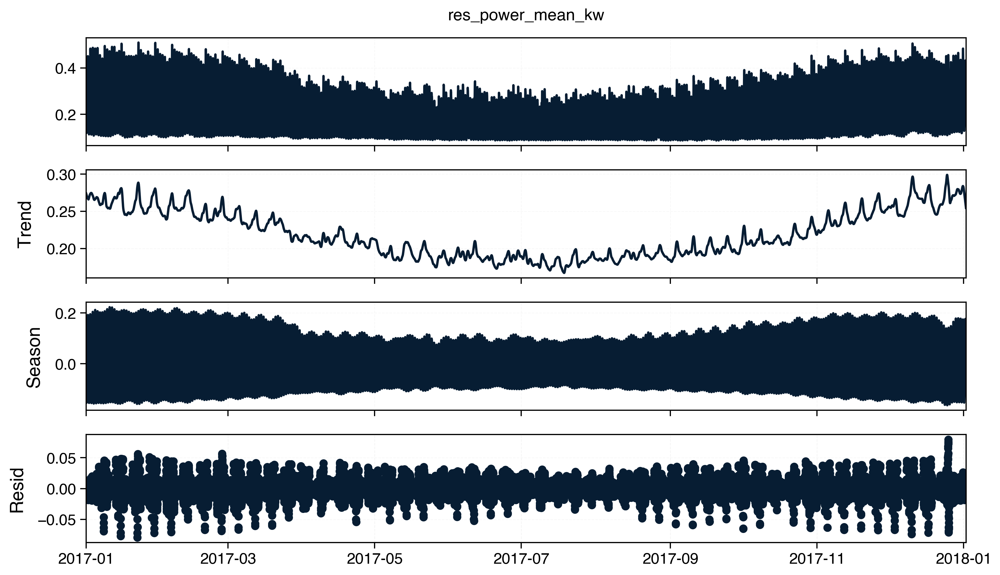

In [182]:
#placeholder STL decomposition diagram here.
display(Image(str(FIGURES_PATH / 'figure_3-1-1.png')))


#### 3.1.2 Seasonal Decomposition by Season

STL plots for each season reveal meaningful patterns: Winter demand gradually increases toward the end due to colder and darker conditions; Spring demand decreases steadily; Summer appears stable; Autumn shows an increase toward the end, opposite of Spring.

[See Appendix 3.1.2](#appendix-3-1-2)




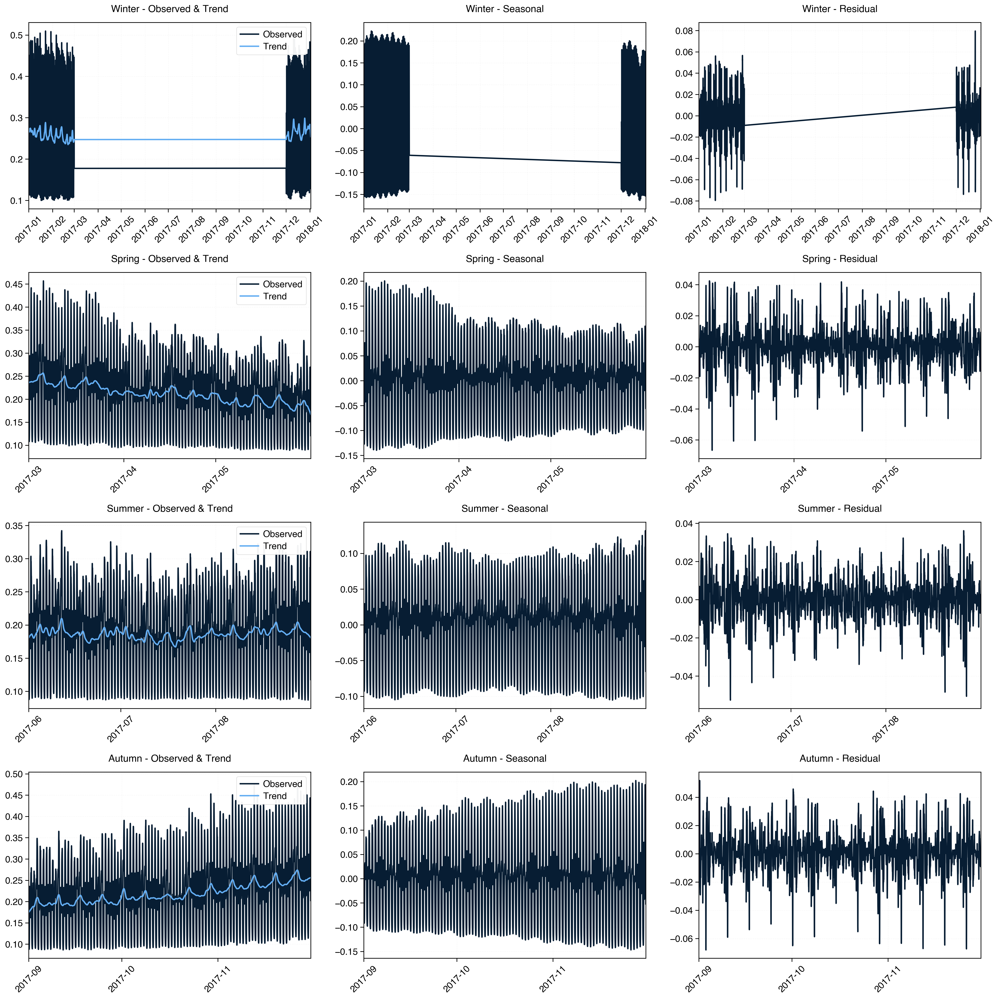

In [184]:
# Placeholder seasonal decomposition subplot grid here.
display(Image(str(FIGURES_PATH / 'figure_3-1-2.png')))


### 3.2 Demand Patterns

#### 3.2.1 Average Demand by Season

We calculated the average demand by season. Winter had the highest average demand, followed by Autumn, Spring, and Summer.

[See Appendix 3.2.1](#appendix-3-2-1)


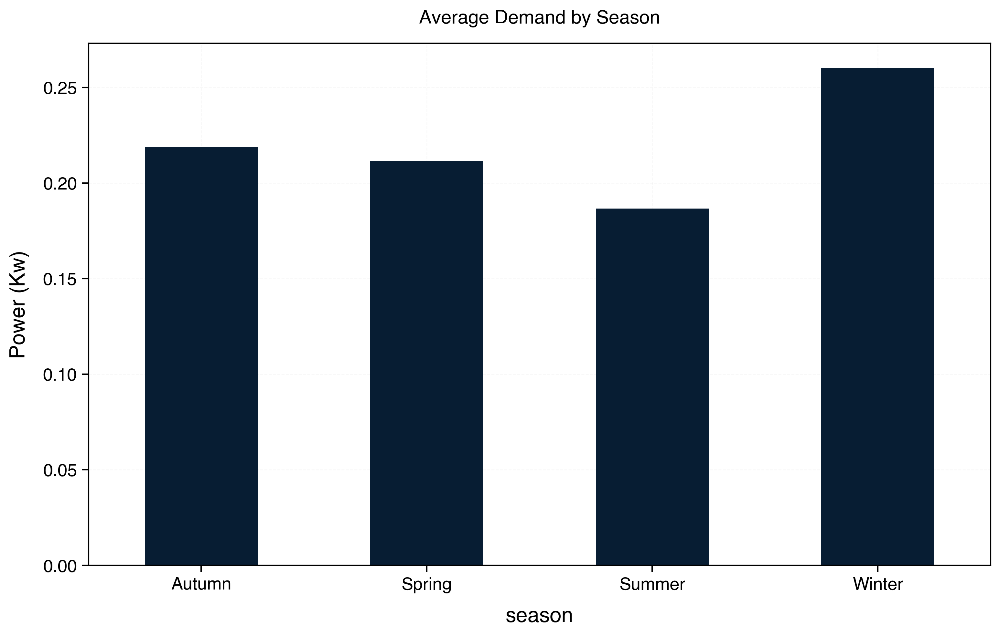

In [187]:
#placeholder bar chart of average demand by season.
display(Image(str(FIGURES_PATH / 'figure_3-2-1.png')))

#### 3.2.2 Average Demand by Month

The trend observed seasonally is reinforced monthly, with the highest demand in colder months and lowest in summer.

[See Appendix 3.2.2](#appendix-3-2-2)





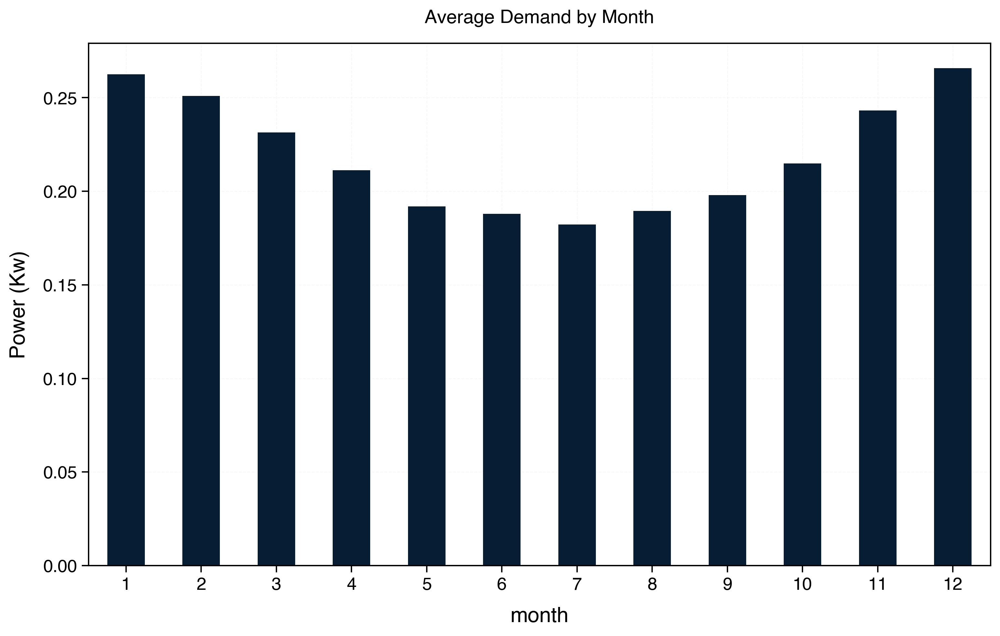

In [190]:
# Place holder: bar chart of average demand by month.
display(Image(str(FIGURES_PATH / 'figure_3-2-2.png')))

#### 3.2.3 Average Demand by Hour

Hourly average shows a distinct pattern: demand dips in early morning hours and peaks between 4 PM and 7 PM, consistent with heating and evening activity patterns.

[See Appendix 3.2.3](#appendix-3-2-3)


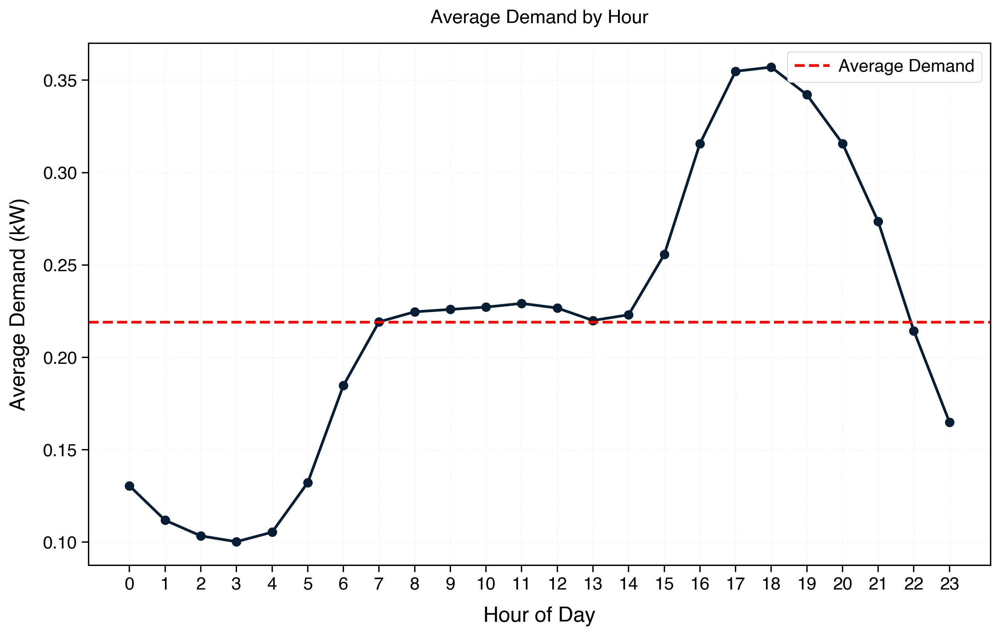

In [193]:
#Placeholder line chart of hourly demand with average line.
display(Image(str(FIGURES_PATH / 'figure_3-2-3.png')))

### 3.3 Energy Conversion
To align demand with energy metrics, we converted residential power usage to energy (kWh). This allows a fair comparison with turbine energy production and curtailed energy.

We also scaled up to total household levels (based on 10,358 households) to estimate total residential demand.

Key results:

- Annual total residential demand: 19.93 GWh

- Average daily demand: ~5.26 kWh per household

- Max daily demand: ~7.14 kWh

- Min daily demand: ~4.01 kWh

In [23]:
#placeholder line chart of hourly demand with average line. (optional if needed)

## 4. Demand Side Response with Quantum Heaters
### 4.1 System Overview
The Quantum Heater (QHeater) model simulates residential heating systems configured to absorb curtailed renewable energy or charge during off-peak hours. It is based on the real-world implementation from the Heat Smart Orkney (HSO) project, where smart storage heaters and hot water cylinders are integrated with Kaluza’s platform for dynamic control.

The system consists of:

- A grid-connected turbine generating electricity.

- A Kaluza platform enabling smart demand-side response.

- Storage heaters and hot water cylinders connected via a Wi-Fi-enabled “Dynamo” module.




### 4.1 Overview

As explored in previous chapters, the Orkney network frequently experiences wind energy curtailment due to supply-demand imbalances and grid constraints. Despite abundant wind generation, this clean energy is often wasted because demand cannot respond quickly enough to absorb the excess.

To address this, we simulate the use of smart-controlled electric heating systems that shift household energy usage to coincide with periods of curtailment. The system centers around a coordination platform — **Kaluza** — which receives real-time curtailment data from the grid's Active Network Management (ANM) system.

Kaluza's cloud platform processes this data and sends charging signals via the internet to in-home **Smart Hubs**, which control **Quantum Heaters** (or other types of flexible storage heaters). These heaters can then charge during periods of low demand or high wind availability, thereby reducing curtailment and improving energy efficiency.

The diagram below illustrates this architecture:

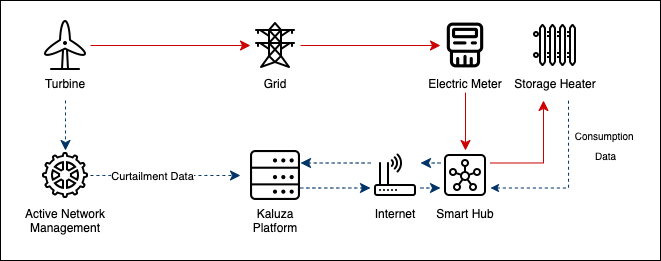

In [ ]:
display(Image(str(FIGURES_PATH / 'AIB_diagram.drawio.png')))

### 4.2 Simulation Design and Operating Logic


The simulation models half hourly heating behavior over a full year, accounting for:

* **Household adoption rate** (0–100%)
* **Seasonal heating variation**
* **Charging logic** based on curtailment or off-peak availability
* **Storage depletion** during heating hours
* **Energy absorption constraints** (e.g., max input/output power)

The system uses a **hysteresis logic** approach to simulate realistic heater behavior: heaters charge when storage drops below a threshold and curtailment is available, and discharge during active heating periods. Scenarios are run for both curtailment-only and off-peak charging strategies.

Each household in the simulation is assumed to operate one Quantum Heater, and the aggregated effect is scaled up based on adoption rate.

The selection of the 1250W Quantum Heater model in this simulation is grounded in the typical heating requirements of UK homes. Based on guidance from the Energy Saving Trust and standard heating design rules, a well-insulated room generally requires approximately **100W of heat per square metre**. According to the [UK Technical Housing Standard (2015)](https://www.gov.uk/government/publications/technical-housing-standards-nationally-described-space-standard/technical-housing-standards-nationally-described-space-standard#:~:text=10.,f.), a double (or twin) bedroom must have a minimum floor area of **11.5 m²**, implying a peak heating requirement of:

$$
11.5 \, \text{m}^2 \times 100 \, \text{W/m}^2 = 1150 \, \text{W}
$$

The 1250W Quantum Heater model (QM125) delivers **1.25 kW of standard heat output**, with an input rating of **2.76 kW** and a **storage capacity of 19.32 kWh**, making it well-suited to meet the heating needs of individual rooms or to partially serve a small flat. It represents a balanced mid-range option within Dimplex’s available models and is appropriate for assessing demand flexibility without overestimating adoption impact or grid load.

In addition to peak-load sizing logic, seasonal energy demand supports the suitability of this model. According to the [European Environment Agency (2024)](https://www.eea.europa.eu/en/analysis/maps-and-charts/unit-consumption-of-space-heating?activeTab=570bee2d-1316-48cf-adde-4b640f92119b), the UK’s climate-corrected space heating consumption is **125 kWh/m²/year**. Assuming a typical heated room (e.g. living room or bedroom) of **11.5 m²**, the estimated annual heating energy required is:

$$
125 \, \text{kWh/m}^2/\text{year} \times 11.5 \, \text{m}^2 = 1{,}437.5 \, \text{kWh/year}
$$

If we assume heating occurs over **6 hours per day** for **6 months of the year** (≈180 days), the average required heating power during active periods is:

$$
\frac{1{,}437.5 \, \text{kWh}}{180 \times 6 \, \text{hours}} \approx 1.33 \, \text{kW}
$$

This closely aligns with the 1250W output of the QM125, validating its use as a representative model for simulating smart, flexible residential heating in Orkney.

[See Appendix 4.2](#appendix-4-2)



### 4.3 Charging Profile Analysis
Simulation outputs include time series plots for key QHeater metrics:

- Charging Energy (kWh)

- Expected Heating Demand

- Storage Energy

- Depleted Energy

Two charging scenarios were explored:

- Off-Peak Charging: QHeaters charge during predefined off-peak hours regardless of curtailment availability.

- Curtailment Charging: QHeaters only charge when excess wind energy would otherwise be curtailed.

The charging profiles (e.g., Day 2 plots) show distinct behavior in both cases—off-peak charging offers consistent overnight charging, while curtailment-based charging varies significantly with supply availability.

[See Appendix 4.3](#appendix-4-3)



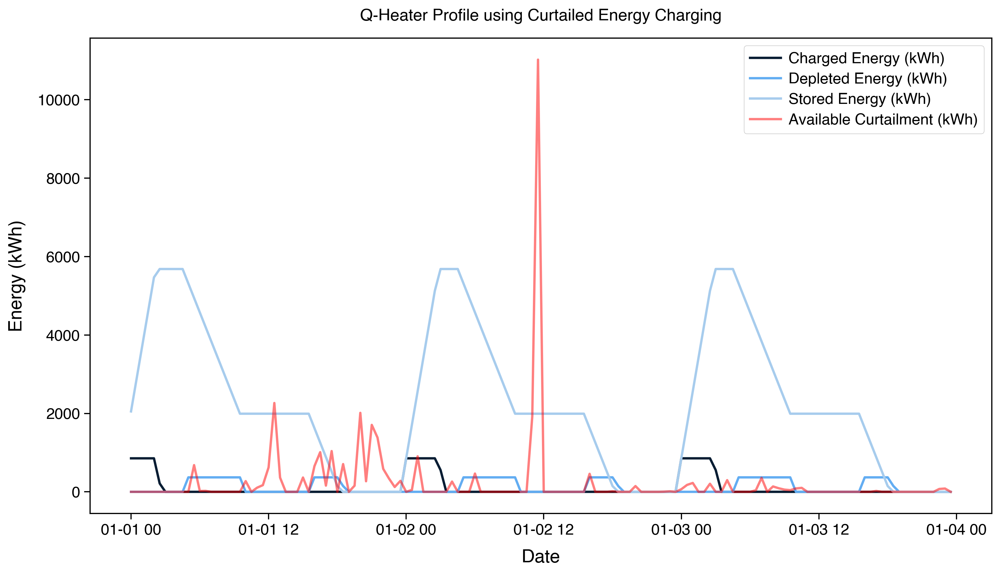

In [201]:
#placeholder
display(Image(str(FIGURES_PATH / 'figure_4-3.png')))

### 4.4 Daily and Annual Impact
We aggregated charging energy on a daily basis to compare absorption potential:

- Theoretical (off-peak) vs Curtailment charging: Curtailment energy absorption is highly variable and seasonal, peaking during windy months and dropping in summer.

- Seasonal variation: Winter sees the highest average charging hours (6.39 hours/day) under curtailment mode.

- Annual performance:
    - Heating demand fulfilled using curtailment: ~92%
    - Unrealised heating demand under curtailment: ~217 MWh
    - Associated cost using curtailment:
        - At 20% of normal rate: ~£80.65/year
        - At standard rate: ~£62.70/year

[See Appendix 4.4](#appendix-4-4)


In [204]:
table_6_4 = pd.read_pickle(TABLES_PATH / 'table_6-4.pkl')
display(table_6_4)

,Value
Parameter,
Annual heater energy consumption per household using curtailment energy (kWh),2745.618252
Daily average heater energy consumption per household using curtailment energy (kWh),7.522242



### 6.5 Sensitivity Analysis
A sensitivity analysis was conducted to evaluate the effect of varying QHeater adoption rates on energy absorption. Key findings:

- Charging energy scales linearly with adoption rate (e.g., 0% yields 0 GWh, 100% yields ~15.37 GWh annually)

- Absorbed curtailed energy shows an inverse relationship—more DSR participation means less curtailment waste

The dual-axis plot confirms this trend: charging energy increases with adoption, while unabsorbed curtailment energy decreases, highlighting the system's effectiveness as adoption grows.

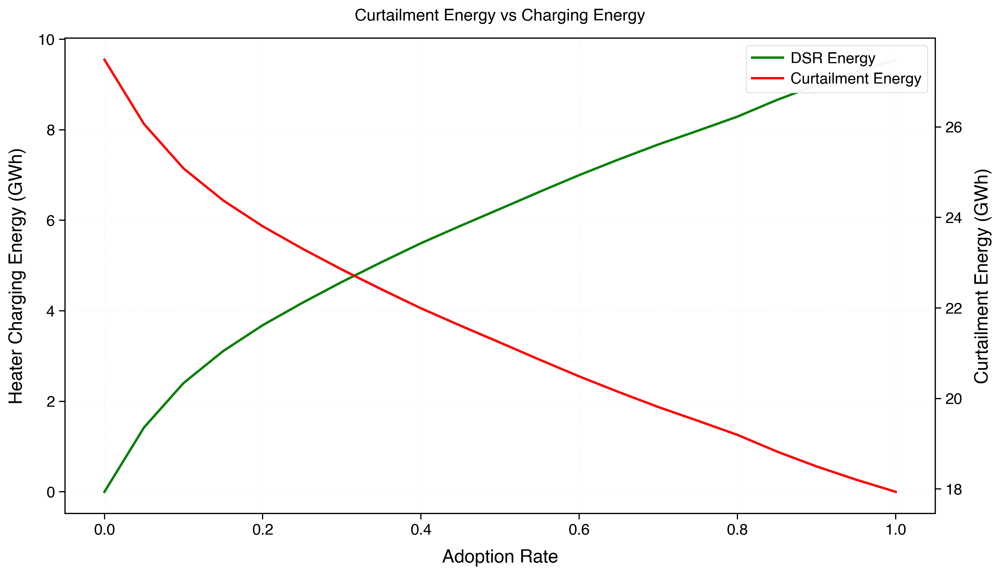

In [210]:
#placeholder the X diagram
display(Image(str(FIGURES_PATH / 'figure_6-5.png')))

The QHeater simulation demonstrates that large-scale deployment of smart heaters can significantly mitigate wind energy curtailment while addressing residential heating needs. Curtailment-based charging, though seasonal, provides substantial coverage for expected demand, and off-peak charging can further complement this strategy.

The model provides a flexible framework to evaluate other adoption rates, charging strategies, or regional demand scenarios.

## 7 Stakeholder Ecosystem


For the project to succeed, it is essential that all stakeholders are aligned with and supportive of Kaluza’s proposed solution. Each stakeholder group plays a critical role in the deployment, adoption, and long-term viability of the system. Therefore, we carefully considered the unique interests, motivations, and potential concerns of each group to design a solution that delivers value to all parties involved.
Our strategy prioritizes stakeholder satisfaction and mutual benefit. By ensuring that every stakeholder, from consumers and wind farmers to government bodies and suppliers sees clear advantages in participating, we can foster the cooperation and engagement needed for successful implementation. The following sections outline how our approach addresses the needs of each stakeholder in the ecosystem.


### 7.1 Wind Farmers


For wind farmers, there are two aspects that they care about. First, because of the high amount of energy produced by wind turbines, most of this energy is curtailed (meaning that it is wasted), so it is in their best interest to use such wasted resource. The other aspect is making extra revenue. Since the demand is not even close to the supply and operating costs are negligible, we can say that every extra Kwh sold at any price is considered extra revenue to wind farmers.

Our suggested solution has two parts for the wind farmers. The first part is that we - as kaluza - will take 20% of the revenue generated for every extra Kwh used at curtailment time, which is controled by our technology. The second part is that we will be converting consumers who depended on sources other than wind energy for their heating. These consumers are mostly in fuel-poverty, so the price of electricity is already high for them, and the switching costs include the price of the heater and the device. So, Kaluza will invest and buy them both the heater and the device. To cover for this significantly high investment, Kaluza will take additional royalty (60%) for a fixed period of time (say 2 years), which ensures that they are paid back fo their investment. After this period is over, the royalty on curtailment will go back to the normal 20% at curtailment.

This solution assumes that wind farmers want to minimize curtailment and that they would appreciate any extra revenue that could be generated.

### 7.2 Households

In Orkney, 63% of households are classified as being in fuel poverty, a figure significantly higher than the Scottish national average at only 24.9%. This is likely due to a combination of factors, including higher energy consumption, which is approximately 83% greater than the Scottish average, and lower average incomes, which are estimated to be £5,000 below the Scottish average. (Orkney Islands Council,2016) Given this context, we assume that a significant portion of consumers are currently under consuming energy, particularly for heating. This under-consumption is not due to a lack of need, but rather due to the high cost of electricity, which prevents households from using the amount of energy they require to maintain comfortable living conditions.

The households in Orkney’s main interest in this project would be the decrease in average price of electracy per Kwh which they would benefit by using the Kaluza device, especially for households relying on expensive heating methods such as oil. This project will aid in making bills more affordable for the general population and reducing the rates of fuel poverty which is highly beneficial to residents of Orkney.


### 7.3 Kaluza (Platform Provider)


Kaluza’s core objective in this project is to maximize the adoption rate of its smart energy devices across Orkney. The more households equipped with the device, the greater the impact on energy efficiency, consumer savings, grid flexibility and ultimately revenue for Kaluza.

From a commercial perspective, the primary goal is to generate sustainable revenue and achieve a faster break-even point. Reaching financial break-even quickly ensures the long-term viability of the solution, enabling Kaluza to continue expanding without dependence on external funding.

Ultimately, Kaluza aims to operate as a self-sufficient and scalable business, where device deployment not only delivers value to stakeholders (consumers, wind farmers, and the grid) but also ensures profitability and reinvestment into further innovation and growth.


### 7.4 Government


The government’s primary interest lies in advancing green energy initiatives, reducing carbon emissions, and addressing fuel poverty all of which are central to national and regional policy goals, particularly in areas like Orkney where fuel poverty rates are among the highest in the UK.

In this project, the government plays a critical enabling role by supporting the transition from fossil fuel based heating (such as oil) to renewable energy sources, especially wind. One of the most impactful ways the government can contribute is through financial incentives such as grants or subsidies to cover the upfront cost of purchasing and installing new storage heaters for low-income households.

This initiative aligns with broader public goals:

-	Decarbonization through reduced reliance on oil
-	Social equity by lowering energy costs for vulnerable groups
-	Energy innovation by supporting flexible demand technologies

Given the strong alignment with government priorities and existing green funding programs (e.g. the Net Zero Innovation Portfolio, Heat Network Fund), this project is well-positioned to receive public sector support.


# 8 Customer Segments

### 8.1 Key Demographics and Behaviour


To build a robust customer segmentation framework for Kaluza's service deployment in Orkney, we conducted an in-depth analysis of the region's population, income distribution, and household energy habits. One of the most critical findings is that 63% of Orkney's population lives in fuel poverty, making affordability and infrastructure compatibility key considerations in our segmentation strategy. An household in fuel poverty is one which over 10% of its income is used in paying for energy bills which is the case for majority of the households in Orkney.

Given the significant variation in heating infrastructure across households, the final segmentation is based on heating system type, a factor that directly affects both the cost of implementation and potential energy savings. The three primary heating infrastructure types identified are: oil heating, storage electric heating, and general electric heating (non-storage).
Brief overview of key customer groups considered for the solution.



### 8.2 Segment Breakdown

#### 8.2.1 Segment A: Oil Heater Users

Approximately 36% of Orkney households rely on oil as their primary heating source. This group represents the highest proportion of fuel-poor residents, primarily due to the volatile and relatively high costs associated with oil-based heating. Additional sources such as solid fuel (14%) and mixed systems (9%) are also prevalent. For the purposes of our analysis, we group these households with oil users, as they exhibit similar behavioural patterns and economic constraints (Orkney Islands Council, 2016).

These households stand to benefit significantly from Kaluza’s smart energy solution, particularly in terms of reducing heating-related energy costs and improving access to clean energy. Their current reliance on carbon-intensive fuel places them in a unique position of need and opportunity, making them a high-priority segment within our rollout strategy.

However, transitioning this group to electric heating will require substantial infrastructure changes, including the replacement of existing heating systems with electric storage heaters and the installation of Kaluza’s smart control devices. These requirements introduce both financial and logistical barriers, which could limit natural adoption. As such, targeted government intervention and support will be essential to enable uptake in this segment and to align with broader policy goals such as fuel poverty reduction and carbon emissions mitigation.





#### 8.2.2 Segment B: Electric Heater Users

This segment comprises households in Orkney that use electric heaters without any storage heating capabilities, representing approximately 31% of the local population (Orkney Islands Council, 2016). These users currently rely on conventional electric heating systems, which are often less efficient and more expensive to operate compared to smart storage solutions.

To participate in Kaluza’s system, these households would require a transition to storage heaters, in addition to the installation of the Kaluza smart energy device. This dual requirement presents a notable barrier to adoption, both in terms of upfront installation complexity and perceived value.

Unlike oil users, households in this segment are already using electricity, and many may not qualify for government funding, particularly if they are not classified as fuel poor. Despite these challenges, this group remains a strategic growth opportunity for Kaluza, with the right support structures in place, this segment could represent a scalable market for expanding the reach of smart energy technologies in Orkney.






#### 8.2.3 Segment C: Storage Heater Users

Around 1,000 households in Orkney (10% of population) currently use storage heaters, including, modern quantum models compatible with the Kaluza device (Okrney Renewable Energy Forum,2018).These users are generally more energy-stable and capable of managing their heating costs. However, many of these households are on fixed energy tariffs, meaning they cannot take full advantage of the load-shifting benefits that storage heaters are designed to offer.

 The introduction of the Kaluza device and dynamic pricing would allow these users could finally unlock the financial and energy efficiency benefits their infrastructure is capable of delivering. This segment offers a quick win for deployment, requiring minimal installation changes and showing high potential for immediate value creation. The main motivation for users in this segment is to be able to use more energy at lower average price.


## 9 Business Models

### 9.1 Overview of Business Model


The development of Kaluza’s business model involved testing several variations to identify the most viable and scalable approach. A central consideration was the substantial financial investment required for both Kaluza and customers, particularly in scenarios where adoption depends on installing both a smart device and a new heating system. To address this, the model incorporates different adoption rate scenarios to reflect varying levels of market uptake.
Kaluza’s operational costs are set at £136,000 per year. This figure includes the core expenses of device installation, maintenance, and marketing. As the number of households served increases, these costs are scaled proportionally. In some versions of the model, Kaluza also covers the cost of heaters and devices, which significantly increases the total expenditure and raises the financial barrier for scaling without external support or revenue offsets.
To ensure the business remains financially sustainable, the model integrates multiple revenue streams. These include royalties collected from wind energy producers, which are based on the energy savings or curtailed generation recovered through demand response. In addition, revenue is generated from customer subscriptions, providing ongoing access to smart features and support. Some models also include direct sales of the Kaluza device, allowing customers to purchase the hardware outright.
By considering all possible options in this approach we balance the need to offer affordable solutions to households, especially those at risk of fuel poverty, with the long-term goal of making Kaluza’s operations commercially viable as adoption grows.


| Model    | Customer Contribution                                     | Kaluza Contribution                                                                      | Expected Adoption Rate | Explanation                                                                                                                |
|----------|-----------------------------------------------------------|-------------------------------------------------------------------------------------------|-------------------------|----------------------------------------------------------------------------------------------------------------------------|
| Model 1  | Customer pays for both the Kaluza device and the compatible heater | Kaluza covers only operational support                                                   | Low                     | High upfront costs make this model inaccessible for most users, especially those in fuel poverty.                         |
| Model 2  | Customer pays for only the Kaluza device                  | Kaluza covers cost of the heater and installation                                        | Medium to Low           | Reduces burden on consumers but still may be too costly for lower-income households.                                      |
| Model 3  | Customer pays nothing upfront                             | Kaluza funds device, heater, installation; explores subsidy or royalty models            | High                    | Eliminates financial barrier, making it highly attractive; likely to drive mass adoption and pilot success.              |


### 9.1  Model Overview




## 9.1 Model Description


The core aim of this business model is to maximize adoption of smart, low-carbon heating systems across Orkney. High adoption rates are essential to the commercial viability of Kaluza’s model, Kaluza would need around 500 households to adopt the into the business for yearly revenue to match estimated operating cost. The more households that adopt the system, the greater the revenue generated. As such, the business model is explicitly designed to prioritise adoption as the key lever for profitability.

The model is shaped by the diverse infrastructure and behavioural characteristics of our customer segments. These barriers significantly reduce the likelihood of voluntary uptake unless financial support is provided. Given the low-income levels and high fuel poverty rates across the region, it unlikely that households would pay for devices or heaters upfront. Our modelling clearly shows that without financial intervention from Kaluza, adoption would remain low, and the business would struggle to scale or break even.


To address this, the preferred model subsidises both the heater and Kaluza demand response device, removing the biggest barrier to adoption. This allows households to transition to modern, efficient heating without upfront cost, while also enabling Kaluza to engage them in smart energy management from day one however this differs by customer segments.

-	Oil heaters: Kaluza provides free device and free quantum heater.
-	Electric heaters:  Kaluza provides free device, but the customer pays for heaters.
-	Storage heaters:  Customers must buy the Kaluza device.


### 9.2 Cost Structure

Cost Structure
Kaluza’s business model involves two core cost components: annual operational expenses and per-household costs for devices and heating systems The annual operational cost is estimated at £136,000. This figure includes all overheads necessary to maintain, install, and support the system at scale. Specifically, it covers the salaries of three technicians (at an average Scottish wage of £30,000), cloud hosting infrastructure, general administrative expenses, and a marketing budget. The breakdown is as follows:

| Expense Category            | Amount (£) |
|----------------------------|------------|
| Cloud Hosting              | £6,000     |
| Technician Salaries        | £90,000    |
| Other Operational Expenses | £10,000    |
| Marketing                  | £30,000    |
| **Total**                  | **£136,000** |


This operational budget is designed to support Kaluza’s rollout goals efficiently.

The second component is the cost of household upgrades and devices. Using this model the estimated costs of adopting each household would be £809. This figure covers installation of two Kaluza demand response devices and two quantum storage heaters which is taken to be the average for households in Orkney. For the sake of modelling, we cap Kaluza’s added capital to be £177,800, this allows for the adoption of 200 households per year.  Bringing the total cost per year to be £313,000.

### 9.3 Revenue Streams

Kaluza’s business model generates revenue from multiple streams, tailored to the specific characteristics of each customer segment. This diversified approach aims to ensure both short-term cost recovery and long-term financial sustainability.

The primary and most consistent source of revenue comes from royalties collected from wind farm partners. These royalties are based on the use of curtailed wind energy, with different collection rates applied depending on the heating segment:

* ⁠For electric and storage heater users, Kaluza receives 20% of the value of curtailed wind energy utilized through demand response.

*  ⁠For oil-heated households, a higher royalty rate of 60% is applied during the first five years. This higher share reflects Kaluza’s greater upfront investment in this segment. After five years, the royalty rate for oil users is reduced to 20%, bringing it in line with other customer groups.

In addition to royalties, the model includes a subscription-based revenue stream. To encourage early adoption and minimize barriers, a nominal fee of £1 per month is charged to all participating households during the first five years. This ensures customers are familiar with a subscription model from the outset. After year five, the subscription increases to £5 per month, helping to offset the reduction in royalty income from the oil segment as the higher initial rates phase out.

Together, these revenue streams of royalties and subscriptions, form a robust financial foundation for the business, balancing fairness across segments while supporting cost recovery and long-term growth.

### 9.4 Stakeholder Impact Analytics
A sustainable and successful implementation of Kaluza’s solution depends on delivering measurable value to all key stakeholders. Below is a breakdown of how each group benefits from the proposed model:

#### 9.4.1 Wind farmers
Wind farmers stand to benefit significantly from the Kaluza model through reduced curtailment and the ability to monetize surplus generation that would otherwise go to waste. By aligning local heating demand with periods of high wind output, these producers gain access to a new, dependable revenue stream. Even after sharing revenue with Kaluza 60% in the case of oil-heated households and 20% for other customer segments, wind farmers still enjoy greater annual income compared to scenarios without Kaluza’s intervention. The system not only offsets curtailment losses but also enhances earnings stability while contributing to greater grid flexibility.



#### 9.4.2 Households

Each household segment benefits differently, based on their current heating infrastructure:


##### 9.4.2.1 Oil Heater Users
il-heated households stand to gain the most from adopting Kaluza’s smart heating solution. With average energy costs significantly higher than electric alternatives, these homes could see their monthly bills drop from £86.48 to £66.90 and 43.41% reduction in price per kWh. Beyond individual savings, switching from oil to electric heating offers broader environmental benefits by reducing carbon emissions. This segment also presents a unique opportunity for Kaluza to introduce households to the electricity market for the first time, increasing long-term platform engagement and loyalty.

##### 9.4.2.2 Storage Heater Users

This segment benefits from existing compatibility with electric heating infrastructure, allowing seamless integration of Kaluza devices. While total energy consumption may increase post-adoption, the ability to shift usage to low-cost periods results in a 25.67% decrease in the effective price per kilowatt-hour. Although absolute monthly bills may rise slightly (from £75.84 to £84.84), the long-term savings potential and improved heating flexibility offer a compelling value proposition. Adoption is expected to be moderate, influenced by customer sensitivity to upfront costs and the visibility of savings.

##### 9.4.2.3 Electric Heater Users (Non-Storage)

Although the introduction of the Kaluza device and dynamic pricing allows access to cheaper electricity on a per-unit basis, users in this segment experience an increase in their overall energy bills from £75.84 to £84.84. This is primarily due to a rise in usage, even though the average price per kilowatt-hour decreases by 25.67%. Importantly, adoption in this group demands a full heating system upgrade in addition to device installation, leading to high upfront costs. Consequently, the financial return is distributed over a longer time horizon typically more than ten years which may discourage immediate uptake. Despite these challenges, the segment holds potential for future engagement if long-term benefits and sustainability outcomes are effectively communicated through targeted awareness and education efforts.

#### 9.4.3 Government

The Scottish Government plays a pivotal role in enabling the transition to cleaner, more affordable heating, particularly for oil-heated households. Through targeted financial support, the government can facilitate the conversion of 50% of these homes to electric heating by 2024. Such a shift is projected to avoid approximately 26,298 metric tonnes of CO₂ emissions, contributing meaningfully to national goals on net-zero emissions and fuel poverty alleviation. This initiative is well-aligned with broader policy objectives related to rural energy access, cost-effective heating, and the promotion of green innovation across Scotland.

### 9.6 Financial Projections

## 10. Strategic Considerations

### 10.1 Product Rollout Strategy

Kaluza’s product deployment will follow a phased rollout strategy, starting with a targeted pilot and scaling based on observed outcomes and strategic alignment with funding opportunities.



#### 10.1.1 Phase 1: Pilot Deployment
The initial rollout—Phase 1—will serve as a pilot phase to test the real-world effectiveness of the Kaluza system in Orkney. The primary goals at this stage are to:
-	Collect empirical data on energy bill savings
-	Demonstrate the technical and financial viability of the solution
-	Build a compelling case for public and private funding

During this phase, we plan to deploy devices to 2% of the total population, specifically targeting households using oil heating. These households face the highest energy costs and would benefit most from switching to smart electric heating. To eliminate barriers and encourage participation, Kaluza will:
-	Provide free storage heaters and Kaluza devices
-	Offer financial incentives up to £100 for participating in the year-long pilot
-	Cover installation and support costs
This trial will not only generate valuable usage and savings data but also serve as a marketing catalyst. Due to Orkney's close-knit community, we anticipate strong word-of-mouth effects, helping to build trust and momentum for future phases. Additionally, with proven results in hand, we will be well-positioned to apply for government grants and scale the project more broadly.

#### 10.1.2 Phase 2: Market Penetration and Expansion

Following the successful completion of the pilot phase, Phase 2 focuses on scaling adoption, securing funding, and streamlining operations to establish Kaluza's solution as a viable, self-sustaining energy initiative in Orkney. The business model places significant financial burden on Kaluza, as we know that majority of the population in Orkney would not have the disposable income to pay upfront for heaters and devices, placing Kaluza in a position to have to support these customers to attain a suitable level of adoption.

At this stage, our priority is to accelerate the rate of adoption by rolling out targeted marketing tactics informed by the insights and testimonials gathered during Phase 1. Leveraging the close-knit nature of the Orkney community, we will focus on trust-building strategies such as community ambassadors, real-life user stories, and clear communication of energy savings and environmental impact. These efforts are designed to build credibility and drive organic word-of-mouth growth.

A key goal in Phase 2 is to secure government funding, using our pilot results as a proof of concept. This funding will be essential to expand device deployment beyond the limits of Kaluza’s internal financing, which is currently estimated at £300,000 per year. By aligning our proposal with national priorities such as net-zero emissions, rural electrification, and fuel poverty reduction, at this stage we also aim to build strategic relationships, obtaining discounts from heater sales as well as partnerships with wind farmers in revenue sharing.
These all would help Kaluza in overcoming financial barriers and be crucial in the success of the business.


#### 10.1.3 Phase 3: Customer Retention

Phase 3 begins once Kaluza has established a strong presence in Orkney and achieved widespread adoption across key customer segments. At this point, the project generates sufficient revenue to cover its annual operational costs, driven by consistent usage and subscription income.

The primary focus in this phase shifts to maintaining customer loyalty and sustaining profitability. As planned, the royalty percentage collected from wind farmers is reduced, meaning that a portion of the revenue will now need to be offset through adjustments to the subscription model. After years of offering a low-cost or even free service during earlier phases, a modest increase in subscription fees may be introduced.

To ensure continued engagement, we will need to proactively manage customer expectations and communicate the ongoing value of the service. While some users may resist paying more after years of subsidised use, others who are accustomed to the benefits of smart energy management and lower bills are likely to remain loyal. These users have integrated Kaluza into their routines and may find it difficult to revert to traditional energy consumption habits or higher energy costs.

To strengthen loyalty and minimize churn, we will offer value-added features, such as personalized usage insights, advanced app capabilities, and loyalty rewards. These initiatives will reinforce the perception of value and support long-term customer retention.
Phase 3 represents a transition from expansion to consolidation, ensuring that Kaluza continues to deliver impact while evolving into a self-sustaining, profitable business model.


### 10.2 Partnership Strategy

To successfully scale our solution across Orkney and ensure long-term sustainability, Kaluza intends to establish strategic partnerships with two key stakeholders: heater suppliers and wind energy producers. These collaborations are essential for optimizing costs, unlocking supply-side benefits, and aligning incentives across the energy ecosystem.

1.	Bulk Procurement Partnerships with Heater Suppliers
To reduce upfront costs and increase affordability for consumers, Kaluza aims to negotiate a 15% discount on heaters through bulk purchasing agreements with manufacturers and suppliers. By aggregating demand across multiple households and regions, we can lower the unit cost of quantum storage heaters, enabling us to reach more fuel-poor households while maintaining our financial viability.
2.	 Revenue-Sharing Agreements with Wind Farmers
Wind farmers stand to benefit significantly from increased energy demand during periods of curtailment. Kaluza’s devices create this demand by shifting household heating loads to times of excess supply as well as bringing in new demand from previously oil using households. To align interests, we propose a tiered royalty model based on consumer segment and infrastructure type:
•	Electric and Storage Heater Users:
For households already using electricity, the demand increase is a direct result of Kaluza’s smart-shifting technology. In these cases, Kaluza proposes a 20% royalty share from the additional curtailed energy revenue generated. The remaining 80% goes to the wind farmers.

•	Oil Heater Conversions:
For consumers switching from oil to electric heating, Kaluza will collect 50–60% of the revenue from curtailed energy usage. Without Kaluza’s intervention, these consumers would not shift to electricity, meaning wind farmers would earn nothing from this segment. After Kaluza recoups its costs, the royalty rate is reduced to 20%, in line with other segments.
In all cases, wind farmers gain more revenue than they would have without Kaluza’s involvement, even after revenue sharing. By creating demand during low-cost periods and converting previously unreachable customers (e.g., oil users), this partnership creates a win-win scenario, new revenue streams for wind farmers and affordable, green energy for consumers.
This partnership strategy ensures that all parties benefit proportionally from their contributions, while accelerating Orkney’s transition to a cleaner, more resilient energy future.



## 10 Marketing and Outreach Strategy

Effectively reaching and engaging Orkney’s community is crucial to ensuring successful adoption of the Quantum Heater solution. Our marketing and outreach strategy is tailored to the island’s unique demographic profile, strong community ties, and existing renewable energy culture. The approach is rooted in trust-building, education, and visibility through locally resonant channels.

### 10.1 Demographic Alignment and Community Integration

Orkney’s population has a high proportion of individuals aged over 50 (around 49%), with 23.6% aged 65 or older. This age distribution, coupled with a tight-knit community of just over 10,500 households (as of 2018), makes it essential to design outreach efforts that prioritize simplicity, familiarity, and local credibility. The fact that nearly 300 people are employed in the renewable energy sector presents a ready-made early adopter audience, particularly useful during the pilot phase.


### 10.2 Local Media Channels and Visibility
We plan to leverage trusted local media to increase awareness. Community newspaper The Orcadian and BBC Radio Orkney—which airs daily from 7:30–8:00 AM and again in the evening are popular among all age groups. These platforms provide opportunities for:

- Sponsored segments on heating innovation

- Informative advertisements about the Kaluza device

- Reviews and testimonials from early users in later phases

In parallel, we’ll collaborate with environmental organizations such as Greener Orkney and community events like the Orkney Folk Festival to host informational sessions. These partnerships help increase visibility while anchoring our message in existing community networks.

### 10.3 Pilot Program and Word-of-Mouth

Leveraging word of mouth during the pilot rollout will help us target renewable energy workers and members of active community organizations. This audience is both energy-conscious and influential in their networks, making them ideal for initial adoption. Our outreach will include:

- Demonstrations and device walk-throughs during workshops

- Localized educational sessions with Q&A

- Early reviews and success stories shared via newsletters and social media

Given Orkney’s strong word-of-mouth culture, our strategy includes enabling satisfied users to organically spread awareness. This is supported by future plans to include local voices in user testimonial campaigns.


### 10.4 Community-Based Engagement Activities
We aim to foster local trust through community workshops conducted in partnership with local groups. These will focus on demystifying the technology, answering questions, and presenting real-life savings outcomes. Our outreach messaging will emphasize control, convenience, and warmth during colder seasons.

Referral incentives will be introduced to encourage early adopters to refer friends and family. This community-driven model helps scale adoption in a natural and trusted manner. Additionally, we will consider highlighting local champions as Kaluza Ambassadors who can share their experience and support peer adoption.




### 10.5 Content Marketing and Digital Support

To complement our community-first approach, a broader digital campaign will be launched, emphasizing educational content. This includes:

- Blogs and explainer videos highlighting the benefits of curtailed energy

- Social media storytelling showcasing “warmer homes” and real user journeys

- Partnerships with local Instagram, LinkedIn influencers and sustainability advocates to broaden visibility

This content strategy is designed to inform, inspire, and reduce friction in decision-making for new users who are unfamiliar with the technology.



## 11 Government Support and Subsidies


To support the rollout of the *Heat Smart Orkney* initiative, we plan to raise **£1.5 million** over a five-year period (2018–2022), targeting the installation of smart heating solutions in **500 households each year**. These funds will be used to procure and deploy smart electric and oil heating devices, associated control hardware, and relevant support infrastructure required for installation and household enablement.

We aim to secure a significant portion of this funding through government programmes that align with the Scottish Government’s climate, energy efficiency, and rural innovation goals.(Scottish Government, 2017; Local Energy Scotland, 2018)




#### Annual Funding Plan (2018–2022)

|   Year |   Households Supported | Annual Funding Requirement   | Cumulative Cost   |
|--------|------------------------|-------------------------------|-------------------|
|   2018 |                    500 | £300,000                      | £300,000          |
|   2019 |                    500 | £300,000                      | £600,000          |
|   2020 |                    500 | £300,000                      | £900,000          |
|   2021 |                    500 | £300,000                      | £1,200,000        |
|   2022 |                    500 | £300,000                      | £1,500,000        |


The full funding amount will be used to cover:

- Procurement of smart electric heaters  
- Smart control devices and associated connectivity  
- Installation services and basic maintenance tools  
- Consumer onboarding and usage support  
- Device monitoring and performance evaluation tools  


#### Proposed Government Funding Sources

| Fund                                                                | Source                         | Expected Contribution    | Purpose                                                                                                 |
|----------------------------------------------------------------------|--------------------------------|---------------------------|---------------------------------------------------------------------------------------------------------|
| Low Carbon Infrastructure Transition Programme (LCITP)             | Scottish Government and partners | £500,000 over 2 years     | Capital grants for low-carbon heating technologies in Scottish households                               |
| Local Energy Challenge Fund (LECF)                                  | Local Energy Scotland           | £450,000                  | Supports innovative local energy initiatives in rural and island areas, including smart heating deployments |
| Innovate UK – Energy Catalyst (Round 5)                             | Innovate UK                     | £150,000                  | Supports development and trial of domestic low-carbon tech such as smart-controlled heaters             |
| R&D Tax Relief (SME Scheme)                                         | HMRC                            | Approx. £100,000          | Claimable against development and deployment costs for smart control integration                        |


### Phased Funding Strategy

**2018–2019: Deployment and Set-Up**  
- Use LCITP and LECF to fund the acquisition and installation of smart heating devices in the first 1,000 homes  
- Engage local contractors for fitting and support, with emphasis on community coordination  

**2020–2022: Expansion and Optimisation**  
- Continue rollout to additional households using Innovate UK funds and R&D rebates  
- Invest in technology refinement, consumer feedback loops, and streamlined onboarding systems  
- Use insights to improve cost-efficiency and installation throughput  


### Alignment with National and Scottish Priorities

Our funding proposal is underpinned by strong alignment with both UK and Scottish Government priorities. The *Heat Smart Orkney* project directly addresses key policy objectives in the areas of decarbonisation, energy affordability, and rural community resilience.(Committee on Climate Change, 2017; Scottish Government, 2018)

Below is a summary of how the project contributes to national goals:


#### Alignment with National and Scottish Priorities

| National/Scottish Priority                   | Project Contribution                                                                                                                                         |
|---------------------------------------------|-------------------------------------------------------------------------------------------------------------------------------------------------------------|
| Net Zero by 2045 (Scotland)                 | Reduces emissions by enabling greater use of renewable electricity via controlled heating loads.                                                            |
| Energy Affordability and Fuel Poverty       | Lowers heating costs for households by shifting energy use to times of low-cost, surplus renewable generation.                                              |
| Support for Rural and Island Communities    | Specifically targets Orkney residents, helping them benefit from local wind generation and avoid costly alternatives.                                       |
| Smart Energy Technology Adoption            | Deploys connected, controllable heating solutions that can later integrate with broader flexibility strategies.                                             |


## 12 Risks, Challenges, and Future Outlook


### 12.1 Strategic and Adoption Risks




#### 12.1.1 Customer Acceptance and Trust

A key risk lies in consumer hesitation to adopt a new, unfamiliar heating technology. Building trust through transparent communication, pilot programs, and demonstrated cost savings will be critical to driving adoption, particularly in rural and conservative communities.



#### 12.1.2	Segment-Specific Barriers

Adoption incentives vary widely across user groups:
*	Oil users have the highest switching cost but also the most to gain from reduced fuel bills. To overcome adoption friction, we propose offering free heater units.
*	Quantum heater users face minimal barriers and are the most likely early adopters.
*	Electric heater users may lack financial incentive to switch, especially without subsidies or upgraded infrastructure, limiting immediate uptake.




#### 12.1.3 Competitor Risk
The emerging landscape of smart energy technologies could invite competition from other startups or established energy firms. Continuous innovation, rapid deployment, and strategic partnerships will be essential to maintain our competitive edge.


### 12.2 Operational and Infrastructure Risks


#### 12.2.1	Turbine Maintenance and Demand Matching
Meeting the anticipated rise in electricity demand requires reliable wind turbine performance. However, risks such as maintenance delays, technician shortages, or aging infrastructure could hinder output. Investing in preventive maintenance and workforce development will be essential.



#### 12.2.2 	Rapid Scaling and Deployment Readiness
Fast adoption could outpace our operational readiness. We must prepare in advance for bulk manufacturing, logistics, installation staffing, and real-time software updates to avoid delays and customer dissatisfaction.

### 12.3 Financial and Technical Risks







#### 12.3.1	Government Support and Grant Uncertainty
Our model assumes partial funding through public grants. A shortfall in government support could hinder free heater distribution and reduce affordability. Parallel efforts to attract private capital or institutional backing will be explored.



#### 12.3.2	Cash Flow Management in Early Phases
The upfront costs for equipment, especially for oil-based heating conversions, may create cash flow challenges. Staggered rollout and cost-sharing models can reduce strain during the break-even period.



#### 12.3.3	Product Reliability and Energy Use Uncertainty
As with any new tech, operational issues (device failures, inaccurate activation, software bugs) are possible. Inaccurate assumptions on energy consumption could also impact financial projections. These risks will be mitigated via a monitored pilot phase and ongoing system refinement based on real-world feedback.

### 12.4 Scope for Improvement and Future Readiness



#### 12.4.1	Monitoring and Learning from Pilot Programs
Early deployments will generate crucial data on customer behavior, energy use, and technical performance. These insights will guide future iterations, pricing models, and grid integration strategies.



#### 12.4.2 Stakeholder Alignment
Future success depends on coordinated engagement with local councils, energy providers, and community organizations to ensure policy support, infrastructure readiness, and user education.


#### 12.4.3	Sustainability and Scalability
As part of our long-term roadmap, we aim to align with Scotland’s net-zero goals, integrate battery storage and solar PV where feasible, and position our solution as a modular energy management system adaptable to other regions.

# Appendix

In [28]:
# Color and Style
plt.style.use('ggplot')
custom_colors = ['#071d33', '#63adf2', '#a7cced', '#82a0bc', '#2f4b26']
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=custom_colors)
sns.set_palette(custom_colors)

# Figure & Font
plt.rcParams.update({
    'figure.facecolor': 'white',
    'axes.facecolor': 'white',
    'font.family': ['Helvetica', 'Arial', 'sans-serif'],
    'font.size': 13,
    'text.antialiased': True,
})

# Axes & Grid
plt.rcParams.update({
    'axes.edgecolor': 'black',
    'axes.labelcolor': 'black',
    'axes.labelpad': 10,
    'axes.titleweight': 'bold',
    'axes.titlesize': 14,
    'axes.titlepad': 15,
    'grid.color': '#E5E5E5',
    'grid.linestyle': '--',
    'grid.linewidth': 0.6,
    'grid.alpha': 0.3,
})

# Ticks
plt.rcParams.update({
    'xtick.color': 'black',
    'ytick.color': 'black',
    'xtick.direction': 'out',
    'ytick.direction': 'out',
    'xtick.major.size': 5,
    'ytick.major.size': 5,
    'xtick.major.width': 1,
    'ytick.major.width': 1,
})

# Legends
plt.rcParams.update({
    'legend.frameon': True,
    'legend.facecolor': 'white',
    'legend.framealpha': 0.95,
    'legend.edgecolor': '#CCCCCC',
    'legend.loc': 'upper right',
    'legend.borderaxespad': 0.5,
    'legend.labelspacing': 0.4,
    'legend.handlelength': 2.0,
    'legend.handletextpad': 0.5,
})

# Lines
plt.rcParams['lines.linewidth'] = 2

<a id="appendix-2-1-1"></a>
### Appendix 2.1.1 – Handling Missing Data

In [29]:
df_tt = pd.read_csv(RAW_DATASET_PATH / 'Turbine_telemetry.csv')

df_tt['Timestamp'] = pd.to_datetime(df_tt['Timestamp'], format='%Y-%m-%d %H:%M:%S') # convert to datetime

# rename columns for clarity
df_tt.rename(columns={
    'Power_kw': 'turbine_power_kw',
    'Setpoint_kw': 'turbine_setpoint_kw',
    'Wind_ms': 'wind_baseline_ms'
}, inplace=True)

ts_tt = df_tt.set_index('Timestamp') #as a time series

ts_tt_og = ts_tt.copy() # keep original for later

print(f'Min Timestamp: {ts_tt.index.min()}')
print(f'Max Timestamp: {ts_tt.index.max()}\n')

print("Missing values in Turbine Data:")
pd.DataFrame(ts_tt.isna().sum()).rename(columns={0: 'Missing values'}).T


Min Timestamp: 2015-05-28 00:00:23
Max Timestamp: 2018-01-11 06:14:32

Missing values in Turbine Data:


,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms
Missing values,2702,2715,2705


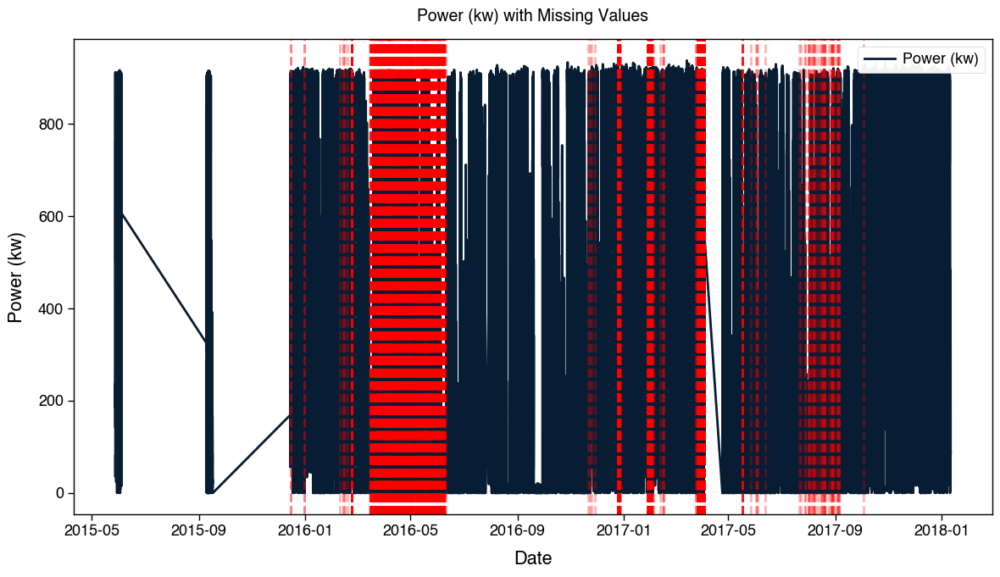

In [30]:
is_nan = ts_tt['turbine_power_kw'].isna()

fig, ax = plt.subplots(figsize=(12, 7))
ax.plot(ts_tt.index, ts_tt['turbine_power_kw'], label='Power (kw)')

is_nan = ts_tt['turbine_power_kw'].isna()
for t in ts_tt.index[is_nan]:
    ax.axvline(x=t, color='red', linestyle='--', alpha=0.3)

ax.set_title('Power (kw) with Missing Values')
ax.set_xlabel('Date')
ax.set_ylabel('Power (kw)')
ax.legend()
ax.grid()
plt.tight_layout()
plt.show()

In [31]:
ts_tt['delta'] = ts_tt.index.diff()
ts_tt_diff = pd.DataFrame(ts_tt['delta'].value_counts()).reset_index().sort_values('count', ascending=False)

# What is the most common time difference?
most_common_diff = ts_tt_diff.head(1)
print(f'Most common time difference is {most_common_diff["delta"][0].seconds} seconds with {most_common_diff["count"][0]:,.1f} occurrences {round(most_common_diff["count"][0] / len(ts_tt) * 100, 2)}% of the data')
print(f'Unique time differences: {len(ts_tt_diff)}')


ts_tt_diff.head(5)

Most common time difference is 60 seconds with 1,051,543.0 occurrences 98.31% of the data
Unique time differences: 143


,delta,count
0,0 days 00:01:00,1051543
1,0 days 00:00:59,6914
2,0 days 00:01:01,4305
3,0 days 00:00:01,2740
4,0 days 00:00:04,1124


In [32]:
ts_tt['prev_timestamp'] = ts_tt.index.to_series().shift(1)

ts_tt['delta'] = ts_tt.index.to_series().diff()
ts_tt['prev_delta'] = ts_tt['delta'].shift(1)

irregular_context = ts_tt[ts_tt['delta'] != pd.Timedelta(minutes=1)].copy()

irregular_context['Timestamp'] = irregular_context.index

irregular_context = irregular_context[['prev_timestamp', 'Timestamp', 'delta']]
irregular_context = irregular_context.sort_values(by='delta', ascending=False).reset_index(drop=True)

display(irregular_context.head(10))

,prev_timestamp,Timestamp,delta
0,2015-06-03 23:59:23,2015-09-10 00:00:30,98 days 00:01:07
1,2015-09-16 23:59:30,2015-12-14 21:03:10,88 days 21:03:40
2,2017-04-03 15:08:44,2017-04-24 03:20:06,20 days 12:11:22
3,2016-07-26 08:30:36,2016-07-29 21:38:56,3 days 13:08:20
4,2015-12-15 20:15:47,2015-12-17 13:47:31,1 days 17:31:44
5,2016-01-13 09:37:34,2016-01-14 09:20:34,0 days 23:43:00
6,2016-09-20 19:03:37,2016-09-21 14:21:37,0 days 19:18:00
7,2017-12-13 22:25:32,2017-12-14 05:31:32,0 days 07:06:00
8,2017-05-17 02:01:07,2017-05-17 08:38:50,0 days 06:37:43
9,2016-09-20 05:13:37,2016-09-20 11:49:37,0 days 06:36:00


There are two types of missing data in our turbine telemetry dataset:

1. **Rows with NaN values in one or more columns**, and
2. **Missing timestamps** — periods where data was not recorded or is entirely absent.

Upon inspection, we found that the data for **2015 is incomplete**, with approximately six months missing. Notably, the available data only begins in **May 2015**, meaning the year is not fully represented.
To ensure the integrity and consistency of our analysis, we have decided to **exclude 2015 from the dataset**, as it does not provide a complete annual record.

In [33]:
ts_tt = ts_tt[ts_tt.index.year != 2015].copy()

ts_tt[(ts_tt['delta'] < pd.Timedelta(minutes=1)) & (ts_tt['prev_delta'] < pd.Timedelta(minutes=1))].head(5)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta
Timestamp,,,,,,
2016-02-08 20:18:34,895.0,900.0,12.1,0 days 00:00:18,2016-02-08 20:18:16,0 days 00:00:42
2016-02-08 20:19:16,0.0,900.0,13.3,0 days 00:00:42,2016-02-08 20:18:34,0 days 00:00:18
2016-02-08 20:19:34,722.0,900.0,11.4,0 days 00:00:18,2016-02-08 20:19:16,0 days 00:00:42
2016-02-08 20:20:16,0.0,900.0,12.4,0 days 00:00:42,2016-02-08 20:19:34,0 days 00:00:18
2016-02-08 20:20:34,793.0,900.0,11.9,0 days 00:00:18,2016-02-08 20:20:16,0 days 00:00:42


<a id="appendix-2-1-2"></a>
### Appendix 2.1.2 – Structuring Time Series

Moreover, since 98% of our dataset have a 1 minute sampling interval and we find that sampling rate under 1 minute shows a delay in data ingestion where turbine power is set to 0 where a couple of second later it reveals the actual power. If we resample it rightaway it will skew our turbine power result when we take an average of it.
\
\
So, we need to find the cut-in speed that can reveal where there should have been a power but our dataset do not capture it

In [34]:
cut_in_speed = ts_tt[(ts_tt.loc[:, 'turbine_power_kw'] >= 10.)].loc[:, 'wind_baseline_ms'].quantile(0.1)

print(f'Cut-in speed: {cut_in_speed:.2f} m/s')

# Define a threshold for what counts as "real" turbine activity
ts_tt_ingestion_delay = ts_tt.copy()
real_power_threshold = 5

# Shift to get the next 2 data points
ts_tt_ingestion_delay['next_power'] = ts_tt_ingestion_delay['turbine_power_kw'].shift(-1)
ts_tt_ingestion_delay['next2_power'] = ts_tt_ingestion_delay['turbine_power_kw'].shift(-2)

# Likely ingestion delay if:
# - Current power is zero
# - Wind speed is above cut-in (e.g., 3 m/s)
# - A significant (> threshold) power reading occurs within next 2 steps
ts_tt_ingestion_delay['likely_delay'] = (
    (ts_tt_ingestion_delay['turbine_power_kw'] == 0) &
    (ts_tt_ingestion_delay['wind_baseline_ms'] >= cut_in_speed) &
    (ts_tt_ingestion_delay['delta'] != pd.Timedelta(minutes=1)) &
    (
        (ts_tt_ingestion_delay['next_power'] >= real_power_threshold) |
        (ts_tt_ingestion_delay['next2_power'] >= real_power_threshold)
    )
)

print(f"Total likely ingestion delay: {ts_tt_ingestion_delay['likely_delay'].sum()}")

display(ts_tt_ingestion_delay[ts_tt_ingestion_delay.likely_delay == True].head())


Cut-in speed: 4.90 m/s
Total likely ingestion delay: 258


,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta,next_power,next2_power,likely_delay
Timestamp,,,,,,,,,
2016-02-08 20:18:16,0.0,900.0,6.3,0 days 00:00:42,2016-02-08 20:17:34,0 days 00:01:00,895.0,0.0,True
2016-02-08 20:19:16,0.0,900.0,13.3,0 days 00:00:42,2016-02-08 20:18:34,0 days 00:00:18,722.0,0.0,True
2016-02-08 20:20:16,0.0,900.0,12.4,0 days 00:00:42,2016-02-08 20:19:34,0 days 00:00:18,793.0,721.0,True
2016-03-15 00:18:54,0.0,900.0,7.6,0 days 00:00:17,2016-03-15 00:18:37,0 days 00:01:00,81.0,0.0,True
2016-03-15 00:19:54,0.0,900.0,7.2,0 days 00:00:17,2016-03-15 00:19:37,0 days 00:00:43,79.0,79.0,True


In [35]:
# ts_tt 2016-02-08 20:18:16	
ts_tt[ts_tt.index <= '2016-02-08 20:19:00'].tail(2)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta
Timestamp,,,,,,
2016-02-08 20:18:16,0.0,900.0,6.3,0 days 00:00:42,2016-02-08 20:17:34,0 days 00:01:00
2016-02-08 20:18:34,895.0,900.0,12.1,0 days 00:00:18,2016-02-08 20:18:16,0 days 00:00:42


Our analysis identified 258 likely ingestion delays. We subsequently investigated whether any single minute contained more than two ingestion events.

In [36]:
# check for multiple ingestion in 1 minute
ts_tt_ingestion_delay['minute'] = ts_tt_ingestion_delay.index.floor('min')

# Count how many rows exist in each 1-minute bucket
minute_counts = ts_tt_ingestion_delay['minute'].value_counts()

# Filter for minutes that have multiple ingestions
multi_ingest_minutes = minute_counts[minute_counts > 1]

df_multi_ingest_minutes = pd.DataFrame(multi_ingest_minutes).rename(columns={'minute': 'count'}).sort_values('count', ascending=False)

print(f"Total minutes with more than 2 ingestions: {len(df_multi_ingest_minutes[df_multi_ingest_minutes['count']>2])}")
print(f"Total minutes with 2 ingestions: {len(df_multi_ingest_minutes[df_multi_ingest_minutes['count']==2])}")
display(df_multi_ingest_minutes.head(10))


# ts_tt_multi_ingest = ts_tt[ts_tt['minute'].isin(multi_ingest_minutes.index)]
# ts_tt_multi_ingest.head()


Total minutes with more than 2 ingestions: 182
Total minutes with 2 ingestions: 3201


,count
minute,
2016-12-27 07:46:00,19
2017-09-05 02:37:00,19
2017-05-17 08:50:00,19
2017-05-17 08:52:00,19
2016-12-27 07:35:00,19
2017-05-17 08:59:00,19
2017-11-09 03:56:00,18
2017-05-17 08:47:00,18
2016-07-21 03:34:00,18


Notably, there are cases where more than two ingestion events occur within the same minute. This anomaly warrants closer inspection.

In [37]:
# check at timestamp 2017-05-17 08:50:00
ts_tt_ingestion_delay[ts_tt_ingestion_delay.minute == '2017-05-17 08:50:00']

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta,next_power,next2_power,likely_delay,minute
Timestamp,,,,,,,,,,
2017-05-17 08:50:02,371.0,900.0,8.6,0 days 00:00:04,2017-05-17 08:49:58,0 days 00:00:03,357.0,NaN,False,2017-05-17 08:50:00
2017-05-17 08:50:04,357.0,900.0,8.7,0 days 00:00:02,2017-05-17 08:50:02,0 days 00:00:04,NaN,360.0,False,2017-05-17 08:50:00
2017-05-17 08:50:07,NaN,900.0,8.8,0 days 00:00:03,2017-05-17 08:50:04,0 days 00:00:02,360.0,356.0,False,2017-05-17 08:50:00
2017-05-17 08:50:08,360.0,NaN,NaN,0 days 00:00:01,2017-05-17 08:50:07,0 days 00:00:03,356.0,373.0,False,2017-05-17 08:50:00
2017-05-17 08:50:11,356.0,900.0,8.7,0 days 00:00:03,2017-05-17 08:50:08,0 days 00:00:01,373.0,381.0,False,2017-05-17 08:50:00
2017-05-17 08:50:15,373.0,900.0,9.2,0 days 00:00:04,2017-05-17 08:50:11,0 days 00:00:03,381.0,359.0,False,2017-05-17 08:50:00
2017-05-17 08:50:18,381.0,900.0,9.5,0 days 00:00:03,2017-05-17 08:50:15,0 days 00:00:04,359.0,350.0,False,2017-05-17 08:50:00
2017-05-17 08:50:22,359.0,900.0,9.7,0 days 00:00:04,2017-05-17 08:50:18,0 days 00:00:03,350.0,340.0,False,2017-05-17 08:50:00
2017-05-17 08:50:26,350.0,900.0,9.4,0 days 00:00:04,2017-05-17 08:50:22,0 days 00:00:04,340.0,332.0,False,2017-05-17 08:50:00


There is also a case where in one minute interval the ingestion is corrupted, where Power and Setpoint and wind is seperately ingested

In [38]:
# check 2017-09-04 17:12:32
ts_tt[ts_tt.index <= '2017-09-04 17:13:00'].tail(2)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta
Timestamp,,,,,,
2017-09-04 17:12:32,NaN,900.0,6.7,0 days 00:00:59,2017-09-04 17:11:33,0 days 00:01:00
2017-09-04 17:12:33,150.0,NaN,NaN,0 days 00:00:01,2017-09-04 17:12:32,0 days 00:00:59


In [39]:
ts_tt['minute'] = ts_tt.index.floor('min')
# Filter minutes with exactly 2 ingestions
two_ingest_minutes = ts_tt['minute'].value_counts()
two_ingest_minutes = two_ingest_minutes[two_ingest_minutes == 2].index

df_two = ts_tt[ts_tt['minute'].isin(two_ingest_minutes)]

# Define key columns to check
key_cols = ['turbine_power_kw', 'turbine_setpoint_kw', 'wind_baseline_ms']

# Group by minute and inspect combinations
def is_mismatched_pair(group):
    if len(group) != 2:
        return False

    mask = group[key_cols].notna()

    # If both rows are partially filled and together form a complete row
    row1, row2 = mask.iloc[0], mask.iloc[1]

    # Case: Each row is partially filled (at least one True and one False)
    if all([
        (1 <= row1.sum() < 3),
        (1 <= row2.sum() < 3),
        ((row1 | row2).sum() == 3)
    ]):
        return True
    return False

# Apply to find all mismatch minutes
mismatched_minutes = df_two.groupby('minute').filter(is_mismatched_pair)

mismatched_minutes.tail(4)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta,minute
Timestamp,,,,,,,
2017-09-04 17:31:32,NaN,900.0,NaN,0 days 00:00:59,2017-09-04 17:30:33,0 days 00:01:00,2017-09-04 17:31:00
2017-09-04 17:31:33,150.0,NaN,6.9,0 days 00:00:01,2017-09-04 17:31:32,0 days 00:00:59,2017-09-04 17:31:00
2017-09-04 17:32:32,NaN,900.0,7.1,0 days 00:00:59,2017-09-04 17:31:33,0 days 00:00:01,2017-09-04 17:32:00
2017-09-04 17:32:33,170.0,NaN,NaN,0 days 00:00:01,2017-09-04 17:32:32,0 days 00:00:59,2017-09-04 17:32:00


There are three cases of data ingestion error we encountered:
1. Ingestion Delay,
    * Two readings in the same minute.
    * One has **0.0 `turbine_power_kw`** but valid wind speed & setpoint.
    * Followed shortly (a few seconds) by a valid power reading.
2. Ingestion Burtst (>2 in the same minute)
    * Multiple readings per minute.
    * Possibly includes `NaN` rows and inconsistent data quality.
3. Ingestion Corrupted
    * A row has **`NaN` in its rows**.
    * Followed by a row with valid timestamp but **missing other key values** (`wind_baseline_ms`, `setpoint`, etc.).
    * Implies **data misalignment** or ingestion out-of-order.


For each cases we will take the last Non-NaN rows as our data. For corrupted ingestion we will try to forward fill this rows. We found that the delay is 1s for these occurences



#### Forward Filling Dataset

In [40]:
ts_tt = ts_tt.sort_index()

# Shift previous row values
ts_tt['prev_power'] = ts_tt['turbine_power_kw'].shift(1)
ts_tt['prev_setpoint'] = ts_tt['turbine_setpoint_kw'].shift(1)
ts_tt['prev_wind'] = ts_tt['wind_baseline_ms'].shift(1)
ts_tt['delta'] = ts_tt.index.to_series().diff()

# Find rows where:
# - delta is 1 second
# - current row has power but missing setpoint or wind
# - previous row has missing power but has setpoint/wind
mask = (
    (ts_tt['delta'] == pd.Timedelta(seconds=1)) &
    (ts_tt['turbine_power_kw'].notna()) &
    ((ts_tt['turbine_setpoint_kw'].isna()) | (ts_tt['wind_baseline_ms'].isna())) &
    (ts_tt['prev_power'].isna()) &
    ((ts_tt['prev_setpoint'].notna()) | (ts_tt['prev_wind'].notna()))
)

# Fill current row's missing values with previous row
ts_tt.loc[mask, 'turbine_setpoint_kw'] = ts_tt.loc[mask, 'prev_setpoint']
ts_tt.loc[mask, 'wind_baseline_ms'] = ts_tt.loc[mask, 'prev_wind']

# Drop the previous row (which is redundant now)
rows_to_drop = ts_tt.index[mask] - pd.Timedelta(seconds=1)
ts_tt = ts_tt.drop(index=rows_to_drop)


In [41]:
ts_tt.isna().sum()

turbine_power_kw          2
turbine_setpoint_kw      14
wind_baseline_ms       1852
delta                     1
prev_timestamp            0
prev_delta                0
minute                    0
prev_power             2699
prev_setpoint          2482
prev_wind              2629
dtype: int64

By forward filling our dataset we reduce the missing turbine_power_kw substantially down to 2 rows. However, setpoint and wind still has a lot of missing values

In [42]:
ts_tt[ts_tt.wind_baseline_ms.isna()].head(5)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta,minute,prev_power,prev_setpoint,prev_wind
Timestamp,,,,,,,,,,
2016-01-31 12:42:34,424.0,NaN,NaN,0 days 00:15:00,2016-01-31 12:27:34,0 days 00:01:00,2016-01-31 12:42:00,175.0,900.0,6.6
2016-02-09 16:13:16,897.0,900.0,NaN,0 days 00:00:01,2016-02-09 16:13:15,0 days 00:00:59,2016-02-09 16:13:00,NaN,900.0,NaN
2016-02-13 17:06:16,198.0,900.0,NaN,0 days 00:00:01,2016-02-13 17:06:15,0 days 00:01:00,2016-02-13 17:06:00,NaN,900.0,NaN
2016-02-13 18:59:16,264.0,900.0,NaN,0 days 00:00:01,2016-02-13 18:59:15,0 days 00:00:59,2016-02-13 18:59:00,NaN,900.0,NaN
2016-02-15 15:20:16,0.0,900.0,NaN,0 days 00:00:01,2016-02-15 15:20:15,0 days 00:00:59,2016-02-15 15:20:00,NaN,900.0,NaN


In [43]:
ts_tt[ts_tt.turbine_setpoint_kw.isna()].head(5)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta,minute,prev_power,prev_setpoint,prev_wind
Timestamp,,,,,,,,,,
2016-01-14 09:20:34,331.0,NaN,8.3,0 days 23:43:00,2016-01-13 09:37:34,0 days 00:01:00,2016-01-14 09:20:00,901.0,900.0,14.5
2016-01-23 09:46:34,252.0,NaN,8.1,0 days 00:19:00,2016-01-23 09:27:34,0 days 00:01:00,2016-01-23 09:46:00,176.0,900.0,6.9
2016-01-23 13:18:34,199.0,NaN,7.4,0 days 00:19:00,2016-01-23 12:59:34,0 days 00:01:00,2016-01-23 13:18:00,142.0,900.0,6.9
2016-01-31 12:42:34,424.0,NaN,NaN,0 days 00:15:00,2016-01-31 12:27:34,0 days 00:01:00,2016-01-31 12:42:00,175.0,900.0,6.6
2016-02-20 11:36:16,901.0,NaN,16.5,0 days 00:27:00,2016-02-20 11:09:16,0 days 00:01:00,2016-02-20 11:36:00,895.0,900.0,16.9


In [44]:
ts_tt[ts_tt.turbine_setpoint_kw.isna() & ts_tt.wind_baseline_ms.isna()]

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,delta,prev_timestamp,prev_delta,minute,prev_power,prev_setpoint,prev_wind
Timestamp,,,,,,,,,,
2016-01-31 12:42:34,424.0,NaN,NaN,0 days 00:15:00,2016-01-31 12:27:34,0 days 00:01:00,2016-01-31 12:42:00,175.0,900.0,6.6
2016-10-25 08:35:52,0.0,NaN,NaN,0 days 00:16:00,2016-10-25 08:19:52,0 days 00:01:00,2016-10-25 08:35:00,0.0,0.0,7.9
2017-05-26 10:20:07,40.0,NaN,NaN,0 days 00:12:00,2017-05-26 10:08:07,0 days 00:01:00,2017-05-26 10:20:00,17.0,900.0,4.4


The missing values in the `turbine_setpoint_kw` column mostly appear after long, irregular time gaps in the data. These gaps indicate **silent periods** where no measurements were recorded, and we cannot reliably infer whether the setpoint remained the same during that time.

Because of this uncertainty, **forward filling would be misleading**, as it would assume the previous setpoint value was still valid throughout the gap. Instead, it's more appropriate to **leave these values as missing** or handle them explicitly during analysis (e.g. filtering them out or marking them as unreliable), rather than imputing potentially incorrect data.


#### Resampling Dataset to 1 Minute

From our analysis, we found that data is expected to arrive at 1-minute intervals for 98% of the dataset. However, we also identified silent gaps,periods where no data was ingested, indicating potential missing records. To address this, we began by cleaning the dataset to resolve cases of multiple ingestions within a single minute. Our approach was to retain only the last recorded value within each 1-minute window. Since we had already forward-filled partially corrupted rows, we can be confident that these final entries contain complete and reliable information. With the cleaned data in place, we then introduced a continuous set of timestamps to account for and explicitly represent missing intervals.

In [45]:
ts_tt_clean = ts_tt.groupby('minute').tail(1).copy()
ts_tt_clean = ts_tt_clean.set_index('minute')

#rename index to Timestamp
ts_tt_clean.index.name = 'Timestamp'

# drop delta, prev_delta, prev_timestamp, prev_power, prev_setpoint, prev_wind
ts_tt_clean = ts_tt_clean.drop(columns=['delta', 'prev_delta', 'prev_power', 'prev_setpoint', 'prev_wind','prev_timestamp'])

ts_tt_clean['turbine_power_baseline_missing'] = ts_tt_clean['turbine_power_kw'].isna()

ts_tt_1min = ts_tt_clean.copy()

# check for missing values
display(ts_tt_clean.isna().sum())

#recalculate delta, prev_delta, prev_timestamp, prev_power, prev_setpoint, prev_wind
ts_tt_clean['prev_timestamp'] = ts_tt_clean.index.to_series().shift(1)
ts_tt_clean['delta'] = ts_tt_clean.index.to_series().diff()
ts_tt_clean['prev_delta'] = ts_tt_clean['delta'].shift(1)
ts_tt_clean['prev_power'] = ts_tt_clean['turbine_power_kw'].shift(1)
ts_tt_clean['prev_setpoint'] = ts_tt_clean['turbine_setpoint_kw'].shift(1)
ts_tt_clean['prev_wind'] = ts_tt_clean['wind_baseline_ms'].shift(1)



turbine_power_kw                     2
turbine_setpoint_kw                 13
wind_baseline_ms                  1842
turbine_power_baseline_missing       0
dtype: int64

In [46]:
# introduce complete timestamp
ts_tt_1min = ts_tt_1min.reindex(pd.date_range(start=ts_tt_1min.index.min(), end=ts_tt_1min.index.max(), freq='1min'))
ts_tt_1min['turbine_power_baseline_missing'] = ts_tt_1min['turbine_power_kw'].isna()

display(ts_tt_1min.isna().sum())

#calculate percentage of missing values
missing_percentage = ts_tt_1min.isna().mean() * 100
print("Percentage of missing values in each column:")
print(missing_percentage[missing_percentage > 0])

turbine_power_kw                  45020
turbine_setpoint_kw               45031
wind_baseline_ms                  46860
turbine_power_baseline_missing        0
dtype: int64

Percentage of missing values in each column:
turbine_power_kw       4.217666
turbine_setpoint_kw    4.218697
wind_baseline_ms       4.390045
dtype: float64


<a id="appendix-2-1-3"></a>
### Appendix 2.1.3 – Period of Zero Turbine Power



In [47]:
# Create a boolean column where power is 0
ts_tt_1min['power_zero'] = ts_tt_1min['turbine_power_kw'] == 0

# Identify start of a new zero-power period
ts_tt_1min['zero_group'] = (ts_tt_1min['power_zero'] != ts_tt_1min['power_zero'].shift()).cumsum()

# Filter only zero-power periods
zero_periods = ts_tt_1min[ts_tt_1min['power_zero']].copy()

# Group by the identified zero period
grouped = zero_periods.groupby('zero_group')

# Compute duration and metadata
durations = grouped.agg(
    start_time=('turbine_power_kw', lambda x: x.index[0]),
    end_time=('turbine_power_kw', lambda x: x.index[-1]),
    duration=('turbine_power_kw', lambda x: x.index[-1] - x.index[0] + pd.Timedelta(minutes=1)),  # add 1 min if sampled by minute
    count=('turbine_power_kw', 'count'),
    max_wind=('wind_baseline_ms', 'max'),
    min_wind=('wind_baseline_ms', 'min'),
    avg_wind=('wind_baseline_ms', 'mean'),
    avg_setpoint=('turbine_setpoint_kw', 'mean')
)
durations.sort_values('duration', ascending=False, inplace=True)

durations.head(5)


,start_time,end_time,duration,count,max_wind,min_wind,avg_wind,avg_setpoint
zero_group,,,,,,,,
4920,2016-06-29 03:55:00,2016-06-30 15:09:00,1 days 11:15:00,2115,11.7,0.0,6.047754,0.000000
434,2016-02-03 05:26:00,2016-02-04 09:56:00,1 days 04:31:00,1711,21.7,0.0,6.331502,888.953828
4918,2016-06-28 08:18:00,2016-06-29 03:53:00,0 days 19:36:00,1176,12.3,2.4,7.330357,0.000000
426,2016-02-01 13:39:00,2016-02-02 06:45:00,0 days 17:07:00,1027,38.1,5.2,17.087439,900.000000
8420,2016-12-25 11:48:00,2016-12-26 02:21:00,0 days 14:34:00,874,41.5,6.1,19.669050,900.000000


Extended zero-power periods can occur due to different operational or technical reasons

In [48]:
# to show where the zero power periods are
# here the zero periods show there is no enough wind
ts_tt_1min['2016-06-29 03:55:00':'2016-06-30 15:09:00'].tail(10)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,turbine_power_baseline_missing,power_zero,zero_group
2016-06-30 15:00:00,0.0,0.0,7.2,False,True,4920
2016-06-30 15:01:00,0.0,0.0,6.5,False,True,4920
2016-06-30 15:02:00,0.0,0.0,7.4,False,True,4920
2016-06-30 15:03:00,0.0,0.0,7.2,False,True,4920
2016-06-30 15:04:00,0.0,0.0,8.5,False,True,4920
2016-06-30 15:05:00,0.0,0.0,7.9,False,True,4920
2016-06-30 15:06:00,0.0,0.0,8.4,False,True,4920
2016-06-30 15:07:00,0.0,0.0,7.9,False,True,4920
2016-06-30 15:08:00,0.0,0.0,7.2,False,True,4920
2016-06-30 15:09:00,0.0,0.0,6.1,False,True,4920


<a id="appendix-2-2-1"></a>
### Appendix 2.2.1 – STL Decompositon



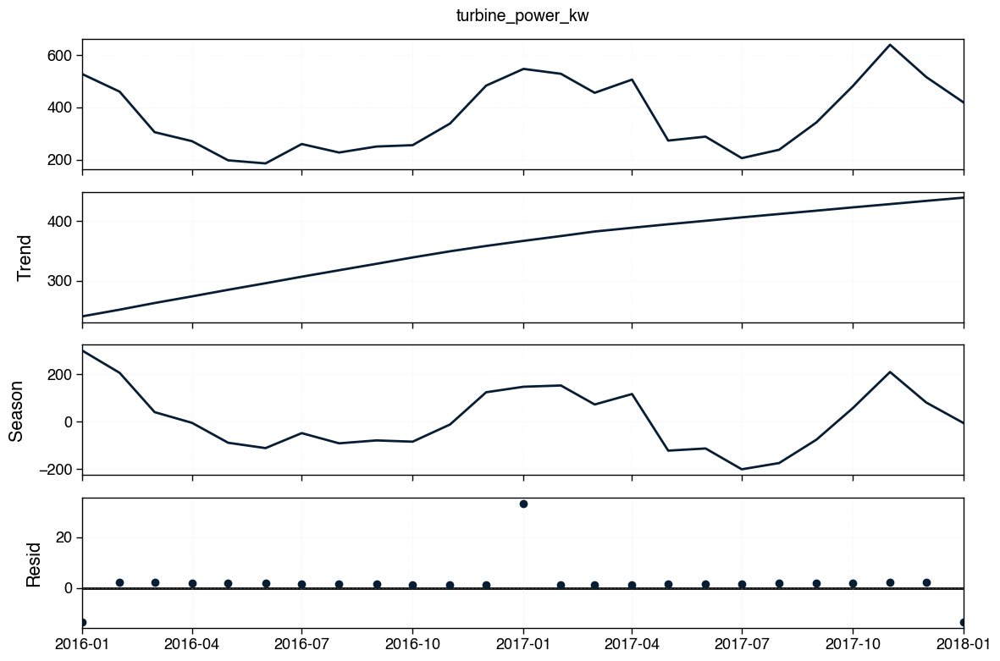

In [49]:
# STL decomposition for monthly_resample
from statsmodels.tsa.seasonal import STL

monthly_resample = ts_tt_1min.resample('MS').mean()
stl = STL(monthly_resample['turbine_power_kw'], seasonal=13)
res = stl.fit()

# Plot with custom size and layout
fig = res.plot()
fig.set_size_inches(12, 8)  # width, height in inches
plt.tight_layout()
plt.grid(True, axis='x', linestyle='--', alpha=0.4)
plt.savefig(FIGURES_PATH / 'figure_2-2-1.png', dpi=300)
plt.show()


<a id="appendix-2-3"></a>
### Appendix 2.3 – Power Curve Analysis



<a id="appendix-2-3-1"></a>
### Appendix 2.3.1 – Visualizing Wind Speed and Power Relationship



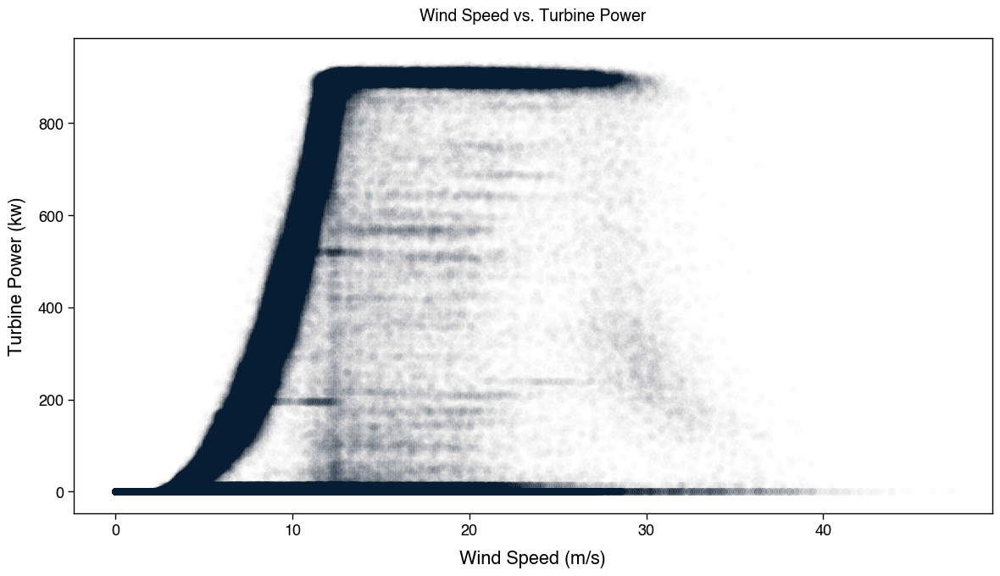

In [50]:
plt.figure(figsize=(12, 7))
plt.scatter(ts_tt_clean.wind_baseline_ms, ts_tt_clean.turbine_power_kw, alpha=0.01)
plt.title('Wind Speed vs. Turbine Power')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Turbine Power (kw)')
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-3-1.png', dpi=300)
plt.show()

<a id="appendix-2-3-2"></a>
### Appendix 2.3.2 – Empirical Power Curve Estimation and Model Comparison



In [51]:
df_power_curve = ts_tt_clean.drop(columns=['prev_timestamp','delta','prev_delta','prev_power','prev_setpoint','prev_wind']).copy()

To fit the wind and power to a curve using weibull distribution or binning method we need to properly filter out the data where curtailment occur both marginally and fully. As these points does not properly explain the correlation of wind and power

In [52]:
df_power_curve = df_power_curve[df_power_curve['turbine_setpoint_kw'] == 900]

We also need to exclude datapoints where wind speed is  above the cut-in point but there is no power. This could be that the turbine is manually switch off or there is a fault in the turbine.

In [53]:
cut_in_speed = ts_tt_clean[(ts_tt_clean.loc[:, 'turbine_power_kw'] >= 10.)].loc[:, 'wind_baseline_ms'].quantile(0.1) # 10% quantile

df_power_curve.loc[
    (df_power_curve.wind_baseline_ms >= cut_in_speed) & (df_power_curve.turbine_power_kw.abs() <= 1e-5),
    'turbine_power_kw'
] = np.nan

df_power_curve = df_power_curve.dropna(subset=['turbine_power_kw','wind_baseline_ms'])

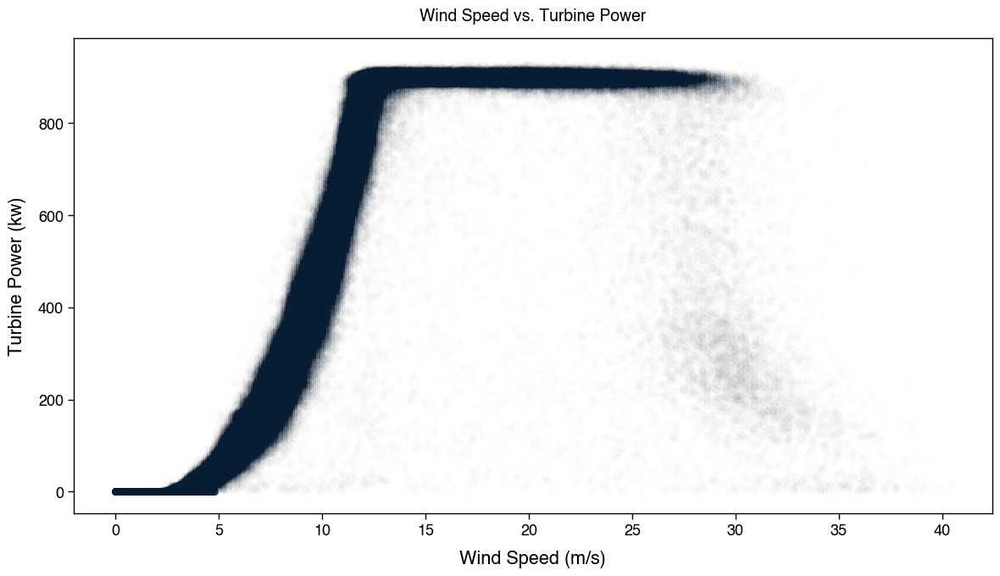

In [54]:
# plot the power curve
plt.figure(figsize=(12, 7))
plt.scatter(df_power_curve['wind_baseline_ms'], df_power_curve['turbine_power_kw'], alpha=0.01)
plt.title('Wind Speed vs. Turbine Power')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Turbine Power (kw)')
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-3-2.png', dpi=300)
plt.show()

The figure above illustrates the relationship between wind speed and turbine power output. As shown, the power curve exhibits a characteristic "S" shape, which reflects the physical behavior of a typical wind turbine.

At low wind speeds (below approximately 3–4 m/s), the turbine remains inactive due to insufficient wind force to overcome mechanical inertia and generate electricity. This region corresponds to the **cut-in wind speed**, below which power output is effectively zero.

As wind speed increases beyond the cut-in threshold, the turbine begins to operate, and power output rises rapidly. In this region, power output increases approximately with the **cube of wind speed**, which is consistent with the physics of wind energy capture, where $P \propto v^3$ under ideal conditions.

Once the wind speed reaches around 11–12 m/s, the turbine approaches its **rated power**. Beyond this point, the turbine is controlled to maintain a constant output—typically through blade pitch adjustment or generator control—to prevent mechanical overload. This plateau is the **rated region** of the turbine.

At very high wind speeds (typically above 25 m/s), the turbine shuts down as a safety measure to avoid structural damage. This is known as the **cut-out wind speed**, after which power output drops sharply back to zero. In the plot, this can be seen as a drop-off in data density beyond 25–30 m/s.

The scattered points beyond the rated wind speed region may represent transient or abnormal operating conditions, measurement noise, or incomplete curtailment during high winds.

<a id="weibull-model"></a>
#### Weibull Distribution Model

To derive the power curve using the baseline wind speed and power output we will use a derivation of weibull distribution model to measure the distribution. 


$$
P(\nu) = P_r \left(1 - e^{- \left(\frac{\nu - v_0}{c}\right)^3} \right)
$$

Where:

* $\nu$ = wind speed
* $v_0$ = minimum wind speed (`cut_in_speed`)
* $c$ = scale parameter
* $P_r$ = rated power

In [55]:
def delayed_weibull(v:float, v0:float, c:float, pr:float):
    """
    Weibull model for wind speed distribution.
    
    Parameters:
    pr (float): Power rating of the turbine in kW. (or setpoint in our case i think)
    v (float): Wind speed in m/s.
    v0 (float): Scale parameter of the Weibull distribution in m/s.
    
    Returns:
    float: Power output in kW.
    """
    v = np.asarray(v)
    power = np.zeros_like(v)
    mask = v > v0
    power[mask] = pr * (1 - np.exp(-((v[mask] - v0) / c) ** 3))
    return power


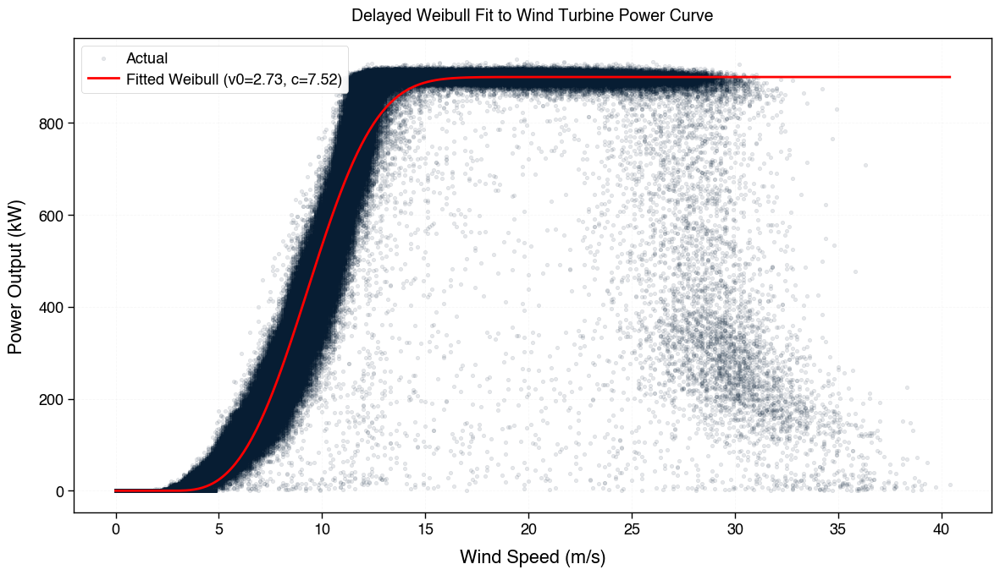

(np.float64(2.7333188761004665), np.float64(7.524894149118479))

In [56]:
wind = df_power_curve['wind_baseline_ms'].values
power = df_power_curve['turbine_power_kw'].values

# Initial guesses for v0 and c
initial_guess = [2.7, 6.5]

# Fit curve
popt, pcov = curve_fit(lambda v, v0, c: delayed_weibull(v, v0, c, pr=900), wind, power, p0=initial_guess)

# Predicted values using fitted parameters
v0_fit, c_fit = popt
predicted_power = delayed_weibull(wind, v0_fit, c_fit, pr=900)

# Plot actual vs fitted curve
v_sorted = np.sort(wind)

predicted_sorted = delayed_weibull(v_sorted, v0_fit, c_fit, pr=900)

plt.figure(figsize=(12, 7))
plt.scatter(wind, power, label='Actual', s=10, alpha=0.1,)
plt.plot(v_sorted, predicted_sorted, color='red', label=f'Fitted Weibull (v0={v0_fit:.2f}, c={c_fit:.2f})')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Power Output (kW)')
plt.title('Delayed Weibull Fit to Wind Turbine Power Curve')
plt.legend(loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-3-2-1.png', dpi=300)
plt.show()

v0_fit, c_fit

In [57]:
weibull_compare = pd.DataFrame({
    'Wind Speed (m/s)': wind,
    'Power Output (kW)': power,
    'Predicted Power Output (kW)': predicted_power
})

weibull_compare['Residuals'] = weibull_compare['Power Output (kW)'] - weibull_compare['Predicted Power Output (kW)']
weibull_compare['Residuals'] = weibull_compare['Residuals'].abs()

r_score = r2_score(weibull_compare['Power Output (kW)'], weibull_compare['Predicted Power Output (kW)'])
rmse = root_mean_squared_error(weibull_compare['Power Output (kW)'], weibull_compare['Predicted Power Output (kW)'])
mae = mean_absolute_error(weibull_compare['Power Output (kW)'], weibull_compare['Predicted Power Output (kW)'])
mse = mean_squared_error(weibull_compare['Power Output (kW)'], weibull_compare['Predicted Power Output (kW)'])

weibull_metrics = pd.DataFrame({
    'Metric': ['R^2', 'RMSE', 'MAE', 'MSE'],
    'Value': [r_score, rmse, mae, mse]
})

display(weibull_metrics)

,Metric,Value
0,R^2,0.961444
1,RMSE,65.974801
2,MAE,38.533740
3,MSE,4352.674347


<a id="Binning-model"></a>

#### Binning Model

/var/folders/9s/vnh0yrb52292pp21phjjlqpm0000gn/T/ipykernel_97903/4287350407.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  binned_curve = df_power_curve.groupby('wind_bin').agg(


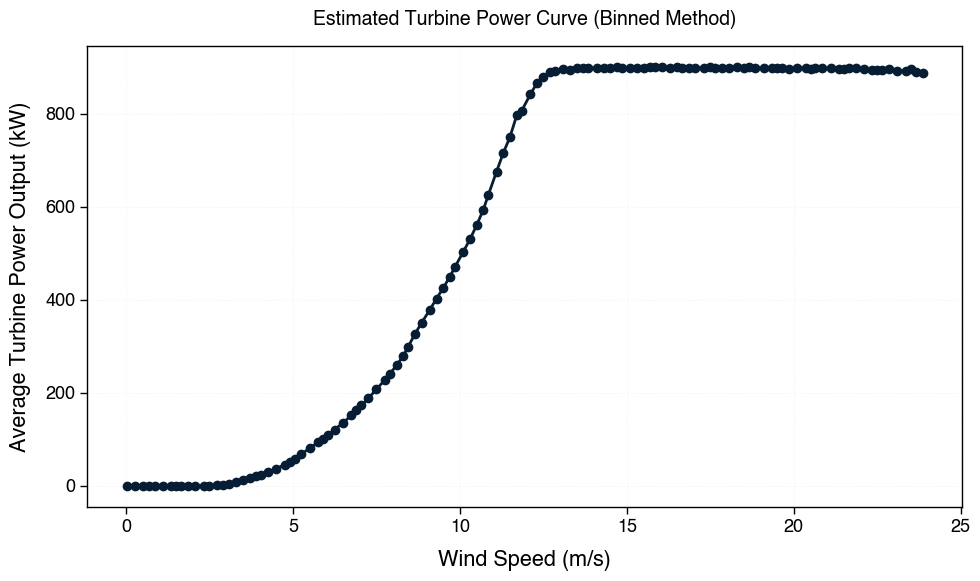

In [58]:
# Define bin width (e.g., 0.5 m/s) and bin edges
bin_width = 0.2
wind_min = cut_in_speed
wind_max = df_power_curve[df_power_curve.turbine_power_kw == df_power_curve.turbine_power_kw.quantile(0.90)].wind_baseline_ms.quantile(0.95)
bins = np.arange(0, wind_max + bin_width, bin_width)

# Assign each row to a wind speed bin
df_power_curve['wind_bin'] = pd.cut(df_power_curve['wind_baseline_ms'], bins=bins, right=False)

# Group by wind speed bin and calculate mean wind speed and power
binned_curve = df_power_curve.groupby('wind_bin').agg(
    mean_wind_speed=('wind_baseline_ms', 'mean'),
    mean_power_output=('turbine_power_kw', 'mean'),
    count=('turbine_power_kw', 'count')
).dropna()

# Plotting the estimated power curve and the power and wind
plt.figure(figsize=(10, 6))
plt.plot(binned_curve['mean_wind_speed'], binned_curve['mean_power_output'], marker='o', linestyle='-')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Average Turbine Power Output (kW)')
plt.title('Estimated Turbine Power Curve (Binned Method)')
plt.grid(True)
plt.tight_layout()
plt.show()

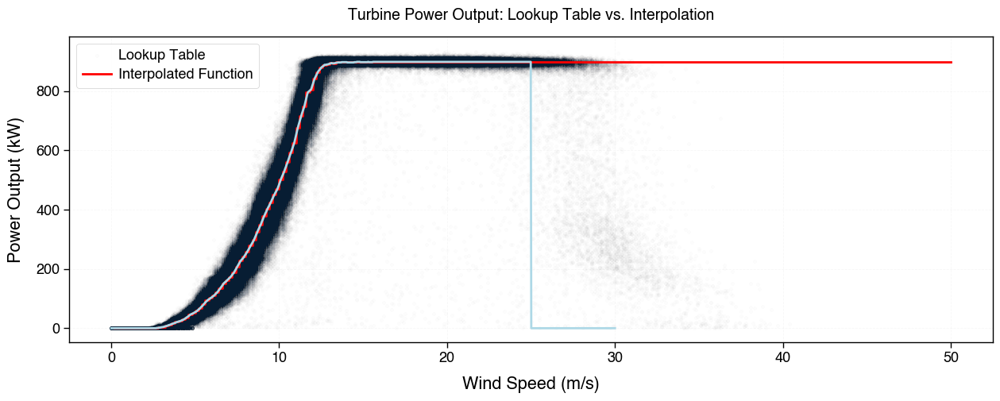

In [59]:
# Group and Aggregate Data
gp = df_power_curve.groupby('wind_bin',observed=True)
lutm = gp['turbine_power_kw'].mean().round(2)
luts = gp['turbine_power_kw'].std()

# Ensure Index is IntervalIndex
if not isinstance(lutm.index, pd.IntervalIndex):
    lutm.index = pd.IntervalIndex(lutm.index)
    luts.index = pd.IntervalIndex(luts.index)

# Extend to Gusts
# Add new interval for high wind gusts and set power to max
gust_interval = pd.Interval(15.8, 50)
lutm.loc[gust_interval] = 900

# Cap power output for all intervals ending at or after 15.8 m/s
lutm[[i.right >= 15.8 for i in lutm.index]] = 900

# Clean and Rebuild Index
# Filter out non-interval entries and enforce consistent closure
valid_intervals = [i for i in lutm.index if isinstance(i, pd.Interval)]
lutm = lutm.loc[valid_intervals]
lutm.index = pd.IntervalIndex(lutm.index, closed='right')

# # Plot Step Function of Lookup Table
# plt.figure(figsize=(15, 5))
# plt.step([i.right for i in lutm.index], lutm.values, where='pre')
# plt.xlabel("Wind Speed (m/s)")
# plt.ylabel("Power Output (kW)")
# plt.title("Turbine Power Curve Lookup Table")
# plt.grid(True)
# plt.show()

# Prepare for Interpolation
wind_ms = lutm.index.mid.values                # Bin centres
power_kw = lutm.values / lutm.max()            # Normalized power

# Define Interpolation Function
@np.vectorize
def turbine_max_power_kw(wind_speed_ms, max_power_kw=900, max_wind_speed_ms=25):
    """Interpolates power output based on wind speed using LUT."""
    if np.isnan(wind_speed_ms):
        return np.nan
    if wind_speed_ms > max_wind_speed_ms:
        return 0

    right_ind = np.searchsorted(wind_ms, wind_speed_ms)
    if right_ind == 0:
        return 0

    left_ind = right_ind - 1
    left_wind, right_wind = wind_ms[left_ind], wind_ms[right_ind]
    left_pow, right_pow = power_kw[left_ind], power_kw[right_ind]
    
    grad = (right_pow - left_pow) / (right_wind - left_wind)
    interp_power = left_pow + grad * (wind_speed_ms - left_wind)
    
    return interp_power * max_power_kw

# Compare Lookup Table with Interpolated Function
ws = np.linspace(0, 30, 1000)

plt.figure(figsize=(15, 5))
# plot the wind
plt.scatter(wind, power, label='Actual', s=10, alpha=0.01)
step_plot = plt.step(lutm.index.right, lutm.to_numpy(), color='red', where='pre')
line_plot = plt.plot(ws, turbine_max_power_kw(ws, max_wind_speed_ms=25), label='Interpolated Curve', color='lightblue')
plt.xlabel("Wind Speed (m/s)")
plt.ylabel("Power Output (kW)")
plt.title("Turbine Power Output: Lookup Table vs. Interpolation")
plt.legend(['Lookup Table', 'Interpolated Function'], loc='upper left')
plt.grid(True)
plt.savefig(FIGURES_PATH / 'figure_2-3-2-3.png', dpi=300)
plt.show()

In [60]:
pred_power_binning = turbine_max_power_kw(wind, max_wind_speed_ms=25)
binning_compare = pd.DataFrame({
    'Wind Speed (m/s)': wind,
    'Power Output (kW)': power,
    'Predicted Power Output (kW)': pred_power_binning
})

binning_compare['Residuals'] = binning_compare['Power Output (kW)'] - binning_compare['Predicted Power Output (kW)']
binning_compare['Residuals'] = binning_compare['Residuals'].abs()

b_r_score = r2_score(binning_compare['Power Output (kW)'], binning_compare['Predicted Power Output (kW)'])
b_rmse = root_mean_squared_error(binning_compare['Power Output (kW)'], binning_compare['Predicted Power Output (kW)'])
b_mae = mean_absolute_error(binning_compare['Power Output (kW)'], binning_compare['Predicted Power Output (kW)'])
b_mse = mean_squared_error(binning_compare['Power Output (kW)'], binning_compare['Predicted Power Output (kW)'])

binning_metrics = pd.DataFrame({
    'Metric': ['R^2', 'RMSE', 'MAE', 'MSE'],
    'Value': [b_r_score, b_rmse, b_mae, b_mse]
})

display(binning_metrics)

,Metric,Value
0,R^2,0.917183
1,RMSE,96.692293
2,MAE,33.660188
3,MSE,9349.399594


#### Method Comparison

In [61]:
# compare binning_metrics and weibull_metrics
comparison = pd.merge(weibull_metrics, binning_metrics, on='Metric', suffixes=('_weibull', '_binning'))

comparison.to_pickle(TABLES_PATH / 'table_2-3-2-3.pkl')
comparison.to_html(TABLES_PATH / 'table_2-3-2-3.html', index=False)

display(comparison)

,Metric,Value_weibull,Value_binning
0,R^2,0.961444,0.917183
1,RMSE,65.974801,96.692293
2,MAE,38.533740,33.660188
3,MSE,4352.674347,9349.399594


Based on the metrics provided, the Weibull model performs better overall compared to the binning method. The Weibull model has a higher R-squared value, which means it explains more of the variance in the data. It also has lower RMSE and MSE values, indicating smaller overall prediction errors, especially for large errors. Although the binning method has a slightly lower MAE, which means it has a lower average absolute error, this metric alone does not outweigh the benefits seen in the other three metrics. Therefore, the Weibull model is the better choice for this task.

In [62]:
ts_tt_1min.head()

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,turbine_power_baseline_missing,power_zero,zero_group
2016-01-01 00:00:00,904.0,900.0,17.0,False,False,1
2016-01-01 00:01:00,899.0,900.0,15.1,False,False,1
2016-01-01 00:02:00,911.0,900.0,18.1,False,False,1
2016-01-01 00:03:00,900.0,900.0,23.1,False,False,1
2016-01-01 00:04:00,903.0,900.0,19.4,False,False,1


<a id="appendix-2-3-3"></a>
### Appendix 2.3.3 – Cut-in and Cut-out Speed Estimation



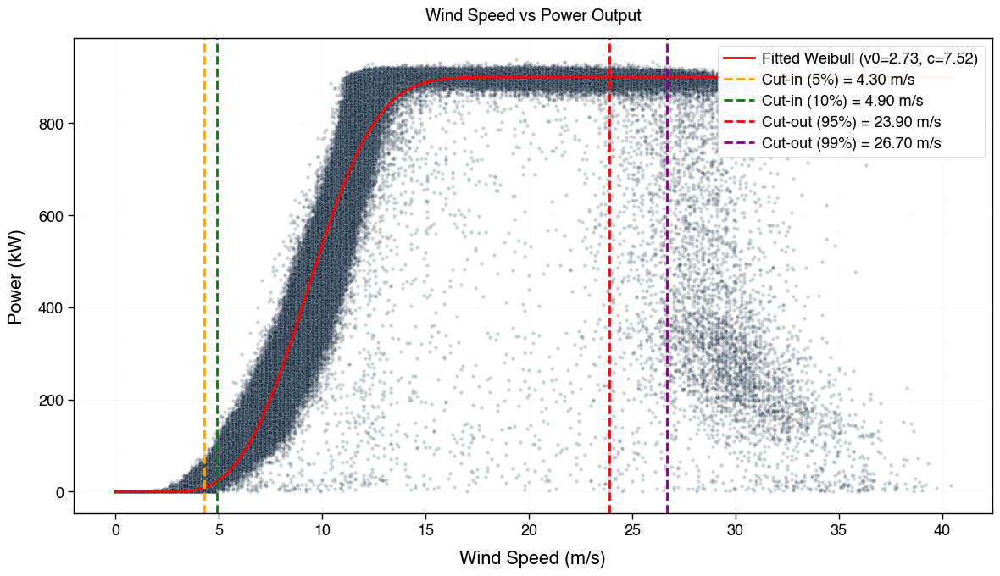

In [63]:
## Filter out rows with missing data

## Compute both quantiles for cut-in and cut-out
cutin_05 = df_power_curve[df_power_curve['turbine_power_kw'] >= 10]['wind_baseline_ms'].quantile(0.05)
cutin_10 = df_power_curve[df_power_curve['turbine_power_kw'] >= 10]['wind_baseline_ms'].quantile(0.10)
cutout_95 = df_power_curve[df_power_curve.turbine_power_kw == df_power_curve.turbine_power_kw.quantile(0.90)].wind_baseline_ms.quantile(0.95)
cutout_99 = df_power_curve[df_power_curve.turbine_power_kw == df_power_curve.turbine_power_kw.quantile(0.90)].wind_baseline_ms.quantile(0.99)

## Create scatter plot
plt.figure(figsize=(12, 7))
sns.scatterplot(data=df_power_curve, x='wind_baseline_ms', y='turbine_power_kw', alpha=0.2, s=10)
plt.plot(v_sorted, predicted_sorted, color='red', label=f'Fitted Weibull (v0={v0_fit:.2f}, c={c_fit:.2f})')

## Draw cut-in / cut-out lines
plt.axvline(cutin_05, color='orange', linestyle='--', label=f'Cut-in (5%) = {cutin_05:.2f} m/s')
plt.axvline(cutin_10, color='green', linestyle='--', label=f'Cut-in (10%) = {cutin_10:.2f} m/s')
plt.axvline(cutout_95, color='red', linestyle='--', label=f'Cut-out (95%) = {cutout_95:.2f} m/s')
plt.axvline(cutout_99, color='purple', linestyle='--', label=f'Cut-out (99%) = {cutout_99:.2f} m/s')

## Labels and legend
plt.title('Wind Speed vs Power Output')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Power (kW)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-3-3.png', dpi=300)
plt.show()

<a id="appendix-2-4"></a>
### Appendix 2.4 – Relationship of Power and Setpoint


In [ ]:
ts_tt_pow_setpoint = ts_tt_1min[ts_tt_1min['turbine_power_kw'] > ts_tt_1min['turbine_setpoint_kw']].copy()
ts_tt_pow_setpoint['exceeds_setpoint'] = (ts_tt_pow_setpoint['turbine_power_kw'] - ts_tt_pow_setpoint['turbine_setpoint_kw']).clip(lower=0)


print(f"Average turbine power exceeding setpoint: {ts_tt_pow_setpoint['exceeds_setpoint'].mean():.2f} kw")
print(f"Max turbine power exceeding setpoint: {ts_tt_pow_setpoint['exceeds_setpoint'].max():.2f} kw")
print(f"Min turbine power exceeding setpoint: {ts_tt_pow_setpoint['exceeds_setpoint'].min():.2f} kw")
print(f"\nTotal number of rows with turbine power greater than setpoint: {len(ts_tt_pow_setpoint)}")

Average turbine power exceeding setpoint: 17.80 kw
Max turbine power exceeding setpoint: 915.00 kw
Min turbine power exceeding setpoint: 1.00 kw

Total number of rows with turbine power greater than setpoint: 133849


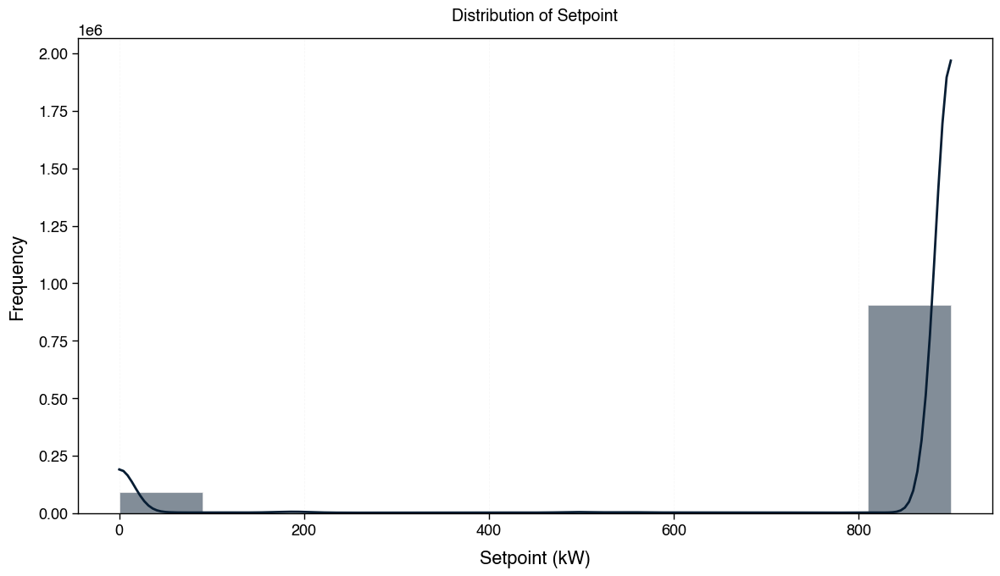

In [ ]:
# distribution of setpoint below 900 kW
plt.figure(figsize=(12, 7))
sns.histplot(ts_tt_1min['turbine_setpoint_kw'], bins=10, kde=True)
plt.title('Distribution of Setpoint')
plt.xlabel('Setpoint (kW)')
plt.ylabel('Frequency')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-5.png', dpi=300)
plt.show()

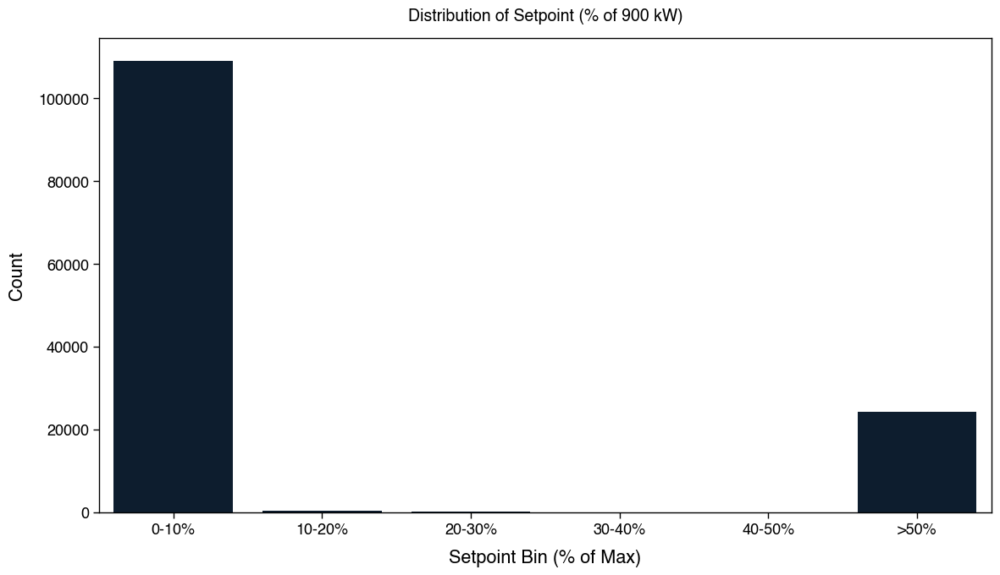

In [ ]:
# change to montly data from 2015-2018

ts_tt_pow_setpoint['exceedance_pct'] = (
    ts_tt_pow_setpoint['exceeds_setpoint'] / ts_tt_pow_setpoint['turbine_setpoint_kw']
)

# Update bin range
exceedance_bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, float('inf')]
exceedance_labels = ['0-10%', '10-20%', '20-30%', '30-40%', '40-50%', '>50%']

# Apply cut
ts_tt_pow_setpoint['exceedance_pct_bin'] = pd.cut(
    ts_tt_pow_setpoint['exceedance_pct'],
    bins=exceedance_bins,
    labels=exceedance_labels,
    include_lowest=True,
    right=True
)

# Plot
plt.figure(figsize=(12, 7))
sns.countplot(data=ts_tt_pow_setpoint, x='exceedance_pct_bin', order=exceedance_labels)
plt.title('Distribution of Setpoint (% of 900 kW)')
plt.xlabel('Setpoint Bin (% of Max)')
plt.ylabel('Count')
plt.grid(axis='y')
plt.tight_layout()
plt.show()

In [ ]:
ts_tt_pow_setpoint[(ts_tt_pow_setpoint.exceedance_pct>0.1)].head()

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,turbine_power_baseline_missing,power_zero,zero_group,exceeds_setpoint,exceedance_pct,exceedance_pct_bin
2016-01-14 09:49:00,374.0,0.0,9.1,False,False,109,374.0,inf,>50%
2016-01-14 10:33:00,10.0,0.0,9.1,False,False,111,10.0,inf,>50%
2016-01-16 20:23:00,33.0,0.0,4.2,False,False,155,33.0,inf,>50%
2016-01-17 04:00:00,75.0,0.0,4.7,False,False,159,75.0,inf,>50%
2016-01-17 06:28:00,6.0,0.0,10.3,False,False,161,6.0,inf,>50%


There are cases where it is exceeded by infinity where setpoint is 0 but there is still power. We are going to check the unresampled data on one of the timestamps of this

In [ ]:
ts_tt_og[ts_tt_og.index <= '2016-01-14 09:55:00'].tail(10)

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms
Timestamp,,,
2016-01-14 09:45:34,450.0,900.0,9.7
2016-01-14 09:46:34,373.0,900.0,9.1
2016-01-14 09:47:34,358.0,900.0,8.8
2016-01-14 09:48:34,400.0,900.0,9.8
2016-01-14 09:49:34,374.0,0.0,9.1
2016-01-14 09:50:34,0.0,0.0,10.3
2016-01-14 09:51:34,0.0,0.0,10.7
2016-01-14 09:52:34,0.0,0.0,10.5
2016-01-14 09:53:34,0.0,0.0,10.6


The data suggest that the turbine underwent a controlled shutdown, likely for maintenance or curtailment reasons. However, there is still some small amount of power generated.

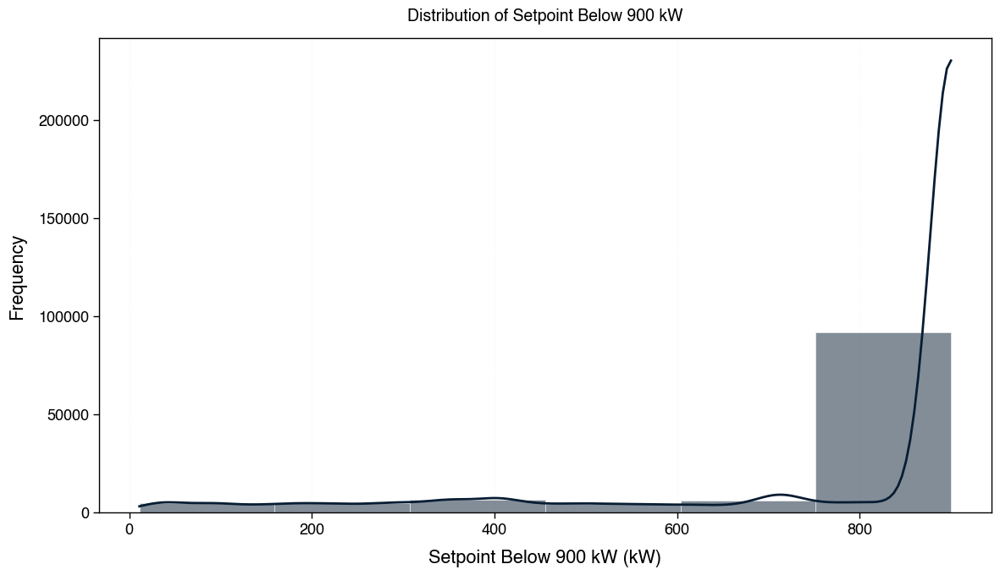

In [ ]:
# Checking the distribution of setpoint less than 900 kW
ts_tt_setpoint = ts_tt_1min[ts_tt_1min['turbine_setpoint_kw'] < 900].copy()
ts_tt_setpoint['below_setpoint'] = (900 - ts_tt_setpoint['turbine_setpoint_kw']).clip(lower=0)

# distribution of setpoint below 900 kW
plt.figure(figsize=(12, 7))
sns.histplot(ts_tt_setpoint['below_setpoint'], bins=6, kde=True)
plt.title('Distribution of Setpoint Below 900 kW')
plt.xlabel('Setpoint Below 900 kW (kW)')
plt.ylabel('Frequency')
plt.grid(axis='y')
plt.tight_layout()
plt.show()

<a id="appendix-2-5"></a>
### Appendix 2.5 – Resampling Dataset to 30 Minute


In [64]:
ts_tt_30min = ts_tt_1min.resample('30min').agg({
    'turbine_power_kw': 'mean',
    'turbine_setpoint_kw': 'mean',
    'wind_baseline_ms': 'mean',
    'power_zero': 'sum',
    'turbine_power_baseline_missing': ['any', 'sum'],  # 'any' = any True, 'sum' = how many Trues
})

# Rename the multi-level columns for clarity
ts_tt_30min.columns = [
    'turbine_power_kw',
    'turbine_setpoint_kw',
    'wind_baseline_ms',
    'turbine_power_zero_count',
    'any_missing',
    'missing_count'
]

# Add total row count per period (i.e., number of 1-min entries per 30-min window)
ts_tt_30min['row_count'] = ts_tt_clean.resample('30min').size()

#set index name as timestamp
ts_tt_30min.index.name = 'Timestamp'

ts_tt_30min = ts_tt_30min.loc['2017-01-01':'2018-01-01']

ts_tt_30min.isna().sum()

turbine_power_kw            1012
turbine_setpoint_kw         1012
wind_baseline_ms            1012
turbine_power_zero_count       0
any_missing                    0
missing_count                  0
row_count                      0
dtype: int64

In [65]:
# Find where turbine_power_kw is NaN
post_clean_nan_mask = ts_tt_30min['turbine_power_kw'].isna()

nan_streak = (post_clean_nan_mask != post_clean_nan_mask.shift()).cumsum()
nan_groups = ts_tt_30min[post_clean_nan_mask].groupby(nan_streak)

# Collect start time, end time, and number of periods for each group
results = []
for _, group_df in nan_groups:
    start = group_df.index[0]
    end = group_df.index[-1]
    length = len(group_df)
    results.append({"start_time": start, "end_time": end, "periods": length})

# Create summary DataFrame
summary = pd.DataFrame(results)

print("Turbine Power NaN Periods Summary:")
display(summary)
print(f"Total NaN periods of turbine power: {summary.periods.sum()}")
print(f"Total NaN periods of wind speed: {ts_tt_30min['wind_baseline_ms'].isna().sum()}")
print(f"Total NaN periods of setpoint: {ts_tt_30min['turbine_setpoint_kw'].isna().sum()}")


Turbine Power NaN Periods Summary:


,start_time,end_time,periods
0,2017-04-03 15:30:00,2017-04-24 02:30:00,983
1,2017-05-17 02:30:00,2017-05-17 08:00:00,12
2,2017-11-09 02:30:00,2017-11-09 03:00:00,2
3,2017-12-13 22:30:00,2017-12-14 05:00:00,14
4,2017-12-15 13:00:00,2017-12-15 13:00:00,1


Total NaN periods of turbine power: 1012
Total NaN periods of wind speed: 1012
Total NaN periods of setpoint: 1012


<a id="appendix-2-5-1"></a>
### Appendix 2.5.1 – Theoretical Power Output


In [66]:
ts_tt_30min['turbine_power_max_kw'] = delayed_weibull(
    ts_tt_30min['wind_baseline_ms'],
    v0_fit,
    c_fit,
    pr=900
)

# calculate hour, month, season, year, date
ts_tt_30min['hour'] = ts_tt_30min.index.hour
ts_tt_30min['month'] = ts_tt_30min.index.month
ts_tt_30min['season'] = ts_tt_30min.index.month % 12 // 3 + 1
ts_tt_30min['season'] = ts_tt_30min['season'].replace({
    1: 'Winter',
    2: 'Spring',
    3: 'Summer',
    4: 'Autumn'
})
ts_tt_30min['year'] = ts_tt_30min.index.year
ts_tt_30min['date'] = ts_tt_30min.index.date


ts_tt_30min.head()

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,turbine_power_zero_count,any_missing,missing_count,row_count,turbine_power_max_kw,hour,month,season,year,date
Timestamp,,,,,,,,,,,,,
2017-01-01 00:00:00,894.033333,900.0,13.820000,0,False,0,30,863.247344,0,1,Winter,2017,2017-01-01
2017-01-01 00:30:00,898.266667,900.0,16.106667,0,False,0,30,896.715935,0,1,Winter,2017,2017-01-01
2017-01-01 01:00:00,902.866667,900.0,16.380000,0,False,0,30,897.688692,1,1,Winter,2017,2017-01-01
2017-01-01 01:30:00,907.833333,900.0,17.083333,0,False,0,30,899.124320,1,1,Winter,2017,2017-01-01
2017-01-01 02:00:00,907.000000,900.0,16.800000,0,True,29,1,898.690062,2,1,Winter,2017,2017-01-01


This calculation estimates the turbine's maximum potential output for each 30-minute interval using the average wind speed and a fitted delayed Weibull power curve. While this provides a useful approximation for business modelling, it is important to note that wind speed and turbine power output are non-linearly related. Applying the power curve to an average wind speed can introduce bias, as it smooths out short-term fluctuations that may have significantly influenced actual turbine performance. As a result, the estimated maximum power may underestimate or overestimate the true potential output depending on how wind speeds varied within the interval. This approach also assumes ideal turbine operation with no curtailment or downtime, so it should be interpreted as an indicative upper bound rather than a precise measure of turbine capability.

<a id="appendix-2-6"></a>
### Appendix 2.6 – Energy Calculation

In [138]:
# turbine_power_kw	turbine_setpoint_kw turbine_power_max_kw convert to energy * 0.5
ts_tt_30min['turbine_energy_kwh'] = ts_tt_30min['turbine_power_kw'] * 0.5
ts_tt_30min['turbine_energy_max_kwh'] = ts_tt_30min['turbine_power_max_kw'] * 0.5

ts_tt_30min.head()

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,turbine_power_zero_count,any_missing,missing_count,row_count,turbine_power_max_kw,hour,month,season,year,date,turbine_energy_kwh,turbine_energy_max_kwh,curtailed_energy_kwh
Timestamp,,,,,,,,,,,,,,,,
2017-01-01 00:00:00,894.033333,900.0,13.820000,0,False,0,30,863.247344,0,1,Winter,2017,2017-01-01,447.016667,431.623672,0.0
2017-01-01 00:30:00,898.266667,900.0,16.106667,0,False,0,30,896.715935,0,1,Winter,2017,2017-01-01,449.133333,448.357967,0.0
2017-01-01 01:00:00,902.866667,900.0,16.380000,0,False,0,30,897.688692,1,1,Winter,2017,2017-01-01,451.433333,448.844346,0.0
2017-01-01 01:30:00,907.833333,900.0,17.083333,0,False,0,30,899.124320,1,1,Winter,2017,2017-01-01,453.916667,449.562160,0.0
2017-01-01 02:00:00,907.000000,900.0,16.800000,0,True,29,1,898.690062,2,1,Winter,2017,2017-01-01,453.500000,449.345031,0.0


<a id="appendix-2-7"></a>
### Appendix 2.7 – Monthly Output and Setpoint Trends


Total curtailed energy (kWh): 0.19 GWh


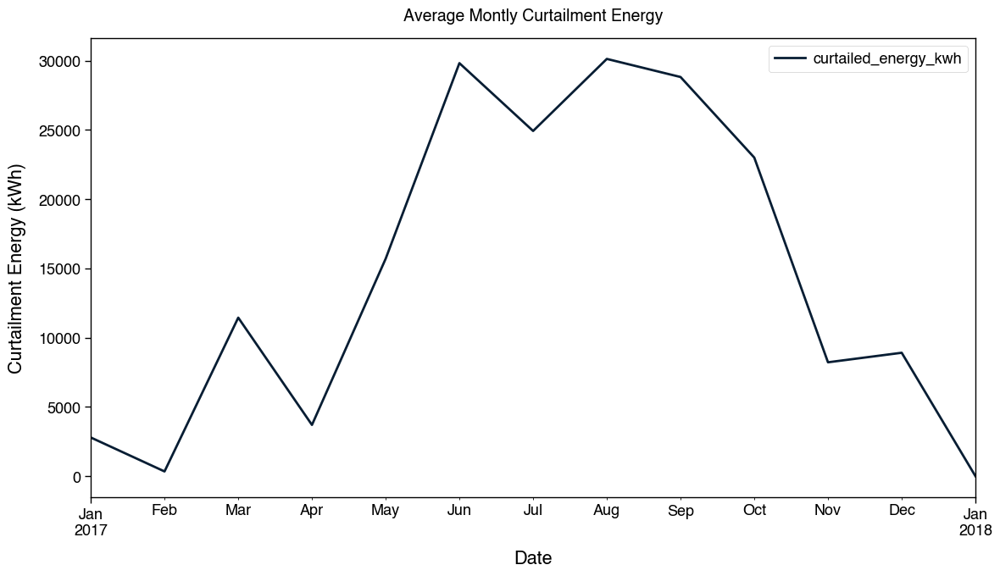

In [162]:
curtailed_energy_month = ts_tt_30min.resample('MS').agg({
    'curtailed_energy_kwh': 'sum',
    'turbine_energy_kwh': 'sum',
    'turbine_energy_max_kwh': 'sum',
    'turbine_setpoint_kw': 'mean',
    'season': 'first',
    'month': 'first'
})

print(f"Total curtailed energy (kWh): {(curtailed_energy_month['curtailed_energy_kwh'].sum()/10**6):,.2f} GWh")
curtailed_energy_month.plot(y=['curtailed_energy_kwh'], use_index=True, figsize=(12,7))
plt.title('Average Montly Curtailment Energy')
plt.xlabel('Date')
plt.ylabel('Curtailment Energy (kWh)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

,curtailed_energy_kwh,turbine_energy_kwh,turbine_energy_max_kwh,curtailment_over_power_prop,curtailment_prop
season,,,,,
Autumn,120121.348355,1.064345e+06,1.181302e+06,0.101686,0.319729
Spring,61702.476712,6.566614e+05,7.038371e+05,0.087666,0.164235
Summer,169798.544619,5.383733e+05,6.940989e+05,0.244632,0.451956
Winter,24074.671207,1.147063e+06,1.202934e+06,0.020013,0.064080


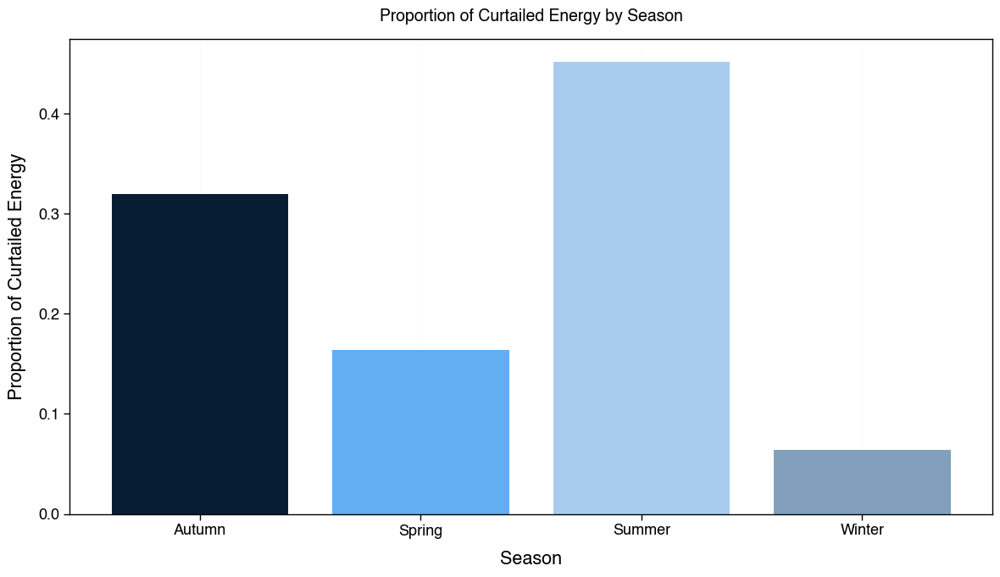

In [ ]:
# Proportion of curtailed energy by season
seasonal_curtailment = curtailed_energy_month.groupby('season').agg({
    'curtailed_energy_kwh': 'sum',
    'turbine_energy_kwh': 'sum',
    'turbine_energy_max_kwh': 'sum'
})
seasonal_curtailment['curtailment_over_power_prop'] = seasonal_curtailment['curtailed_energy_kwh'] / seasonal_curtailment['turbine_energy_max_kwh']
seasonal_curtailment['curtailment_prop'] = seasonal_curtailment['curtailed_energy_kwh'] / seasonal_curtailment['curtailed_energy_kwh'].sum()
display(seasonal_curtailment)

#plot seasonal curtailment
plt.figure(figsize=(12, 7))
plt.bar(seasonal_curtailment.index, seasonal_curtailment['curtailment_prop'], color=custom_colors[:len(seasonal_curtailment)])
plt.title('Proportion of Curtailed Energy by Season')
plt.xlabel('Season')
plt.ylabel('Proportion of Curtailed Energy')
plt.grid(axis='y')
plt.tight_layout()
plt.show()

<a id="appendix-2-7-1"></a>
### Appendix 2.7.1

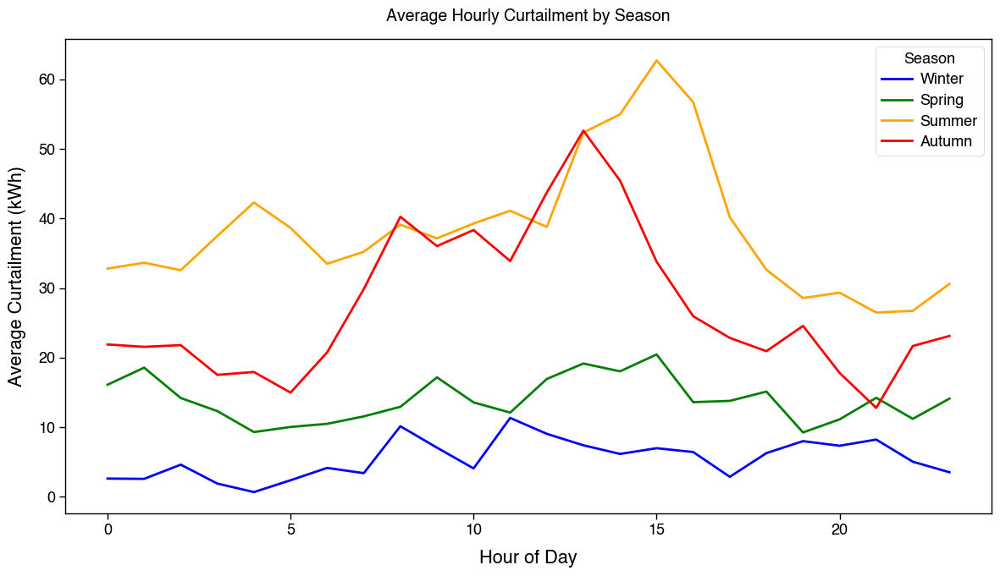

In [ ]:
# hourly average curtailment per season
hourly_seasonal_curtailment = ts_tt_30min.groupby(['season', 'hour'])['curtailed_energy_kwh'].mean().reset_index()

#plot into line chart
plt.figure(figsize=(12, 7))
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Winter']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Winter']['curtailed_energy_kwh'],
    label='Winter',
    color='blue'
)
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Spring']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Spring']['curtailed_energy_kwh'],
    label='Spring',
    color='green'
)
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Summer']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Summer']['curtailed_energy_kwh'],
    label='Summer',
    color='orange'
)
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Autumn']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Autumn']['curtailed_energy_kwh'],
    label='Autumn',
    color='red'
)
plt.title('Average Hourly Curtailment by Season')
plt.xlabel('Hour of Day')
plt.ylabel('Average Curtailment (kWh)')
plt.legend(title='Season')
plt.grid()
plt.tight_layout()
plt.show()

In [ ]:
pd.DataFrame([{
    'Average Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].mean(),
    'Standard Deviation Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].std(),
    'Max Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].max(),
    'Min Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].min(),
    'Average Maximum Energy (kWh)': ts_tt_30min['turbine_energy_max_kwh'].mean(),
}]).T.rename(columns={0: 'Value'})

,Value
Average Curtailment Energy (kWh),21.385305
Standard Deviation Curtailment Energy (kWh),81.924935
Max Curtailment Energy (kWh),450.000000
Min Curtailment Energy (kWh),0.000000
Average Maximum Energy (kWh),215.287540


<a id="appendix-2-7-2"></a>
### Appendix 2.7.2


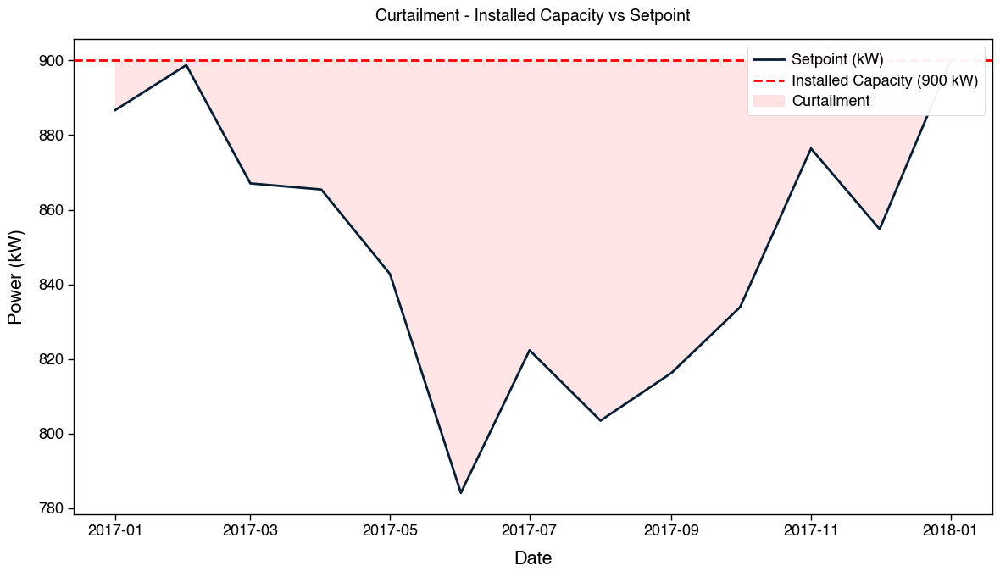

In [168]:
plt.figure(figsize=(12, 7))

plt.plot(curtailed_energy_month.index, curtailed_energy_month['turbine_setpoint_kw'], label='Setpoint (kW)')
# plt.plot(curtailed_energy_month.index, curtailed_energy_month['curtailed_power_kw'], label='Curtailment (kW)', color='red')
#shade the area between the two lines as curtailment
plt.axhline(y=900, color='red', linestyle='--', label='Installed Capacity (900 kW)')
plt.fill_between(
    curtailed_energy_month.index,
    900,
    curtailed_energy_month['turbine_setpoint_kw'],
    color='red',
    alpha=0.1,
    label='Curtailment'
)
plt.title('Curtailment - Installed Capacity vs Setpoint')
plt.xlabel('Date')
plt.ylabel('Power (kW)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH/'figure_2-7-2.png', dpi=300, bbox_inches='tight')
plt.show()
# plt.close()

<a id="appendix-2-7-3"></a>
### Appendix 2.7.3 – Curtailment Type Breakdown



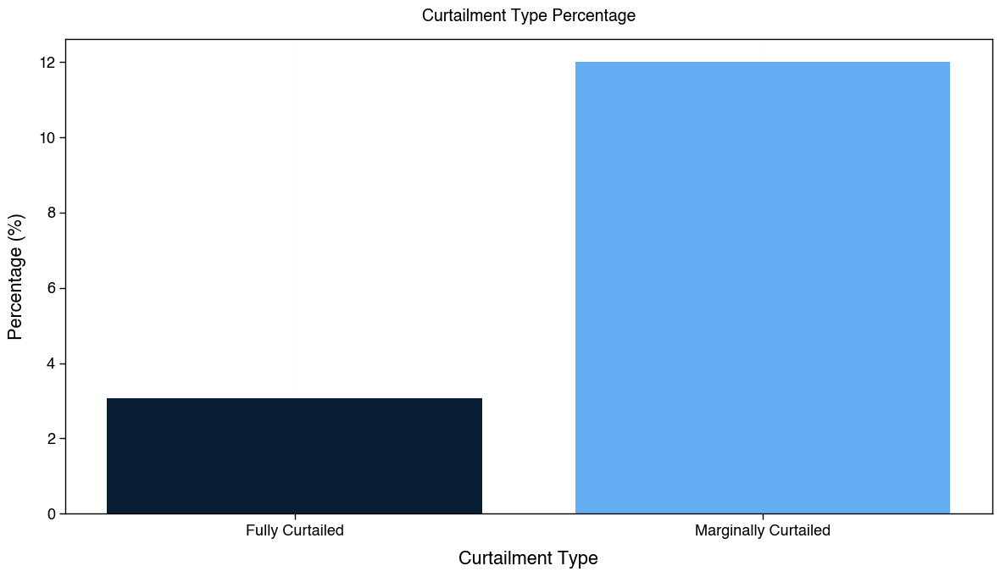

In [ ]:
fully_curtailed = ts_tt_30min[ts_tt_30min['turbine_setpoint_kw'] == 0].shape[0]
marginally_curtailed = ts_tt_30min[ts_tt_30min['turbine_setpoint_kw'] < 900].shape[0]
total_data = ts_tt_30min.shape[0]

curtailment_summary = pd.DataFrame({
    'Curtailment Type': ['Fully Curtailed', 'Marginally Curtailed'],
    'Count': [fully_curtailed, marginally_curtailed],
    'Percentage': [
        (fully_curtailed / total_data) * 100,
        (marginally_curtailed / total_data) * 100
    ]
})

#plot the curtailment summary
plt.figure(figsize=(12, 7))
plt.bar(
    curtailment_summary['Curtailment Type'],
    curtailment_summary['Percentage'],
    color=custom_colors[:len(curtailment_summary)]  # Slice to match number of bars
)
plt.title('Curtailment Type Percentage')
plt.xlabel('Curtailment Type')
plt.ylabel('Percentage (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()



<a id="appendix-2-7-4"></a>
### Appendix 2.7.4 – Curtailment Proportion and Load Factor



The **curtailment proportion** is a measure of how efficiently a wind turbine is operating relative to its maximum possible capacity. It is calculated by dividing the **average power output** by the **potential maximum capacity** of the turbine. This metric provides insight into the turbine's curtailment ration over time.


$$
\text{Curtailment Factor} = \frac{\text{Curtailed Output}}{\text{Turbine Generated Output}}
$$


In [ ]:
curtailment_factor = ts_tt_30min['curtailed_energy_kwh'].sum()/ts_tt_30min['turbine_energy_kwh'].sum()

print(f'Turbine Curtailment Proportion: {curtailment_factor:.2%}')


Turbine Curtailment Proportion: 11.03%


In [ ]:
# Turbine load factor
load_factor = ts_tt_30min['turbine_power_kw'].mean() / 900

print(f"Turbine Load Factor: {load_factor:.2%}")

Turbine Load Factor: 45.72%


<a id="appendix-2-8"></a>
### Appendix 2.8 - Scaling Turbine Dataset


The **Active Network Management (ANM)** system in Orkney was introduced to help integrate more renewable energy into the local grid, which is limited in how much electricity it can export to the mainland. Because of this constraint, the ANM system automatically adjusts how much power each wind turbine can send to the grid based on real-time conditions.

The ANM system works by assigning a **power setpoint** to each turbine. This setpoint determines the maximum power the turbine is allowed to export at any given time:

* **0 kW** – the turbine is **fully curtailed** (no power export allowed)
* **Between 0 and 900 kW (or below installed capacity)** – the turbine is **marginally curtailed** (partially restricted)
* **900 kW or the installed capacity** – the turbine is **not curtailed** (can operate freely)

To detect curtailment in the data, we define it as any time the turbine's setpoint is **less than 900 kW**.

To calculate how much energy is being curtailed:

1. We estimate the **maximum possible output** of the turbine based on wind speed using a power curve model.
2. We subtract the **actual power output** from this theoretical maximum.
3. If the turbine was **not curtailed** (setpoint ≥ 900 kW), we set curtailment to **zero**.
4. Any **negative values** (e.g., if the turbine output was slightly higher than expected) are clipped to **zero** to avoid counting false curtailment.

This method allows us to estimate how much wind energy is lost due to grid constraints and ANM control. It gives us insight into the trade-offs between maximizing renewable energy use and maintaining grid stability on a limited-capacity island like Orkney.


In [141]:
ts_tt_30min['curtailed_power_kw'] = (ts_tt_30min['turbine_energy_max_kwh'] - ts_tt_30min['turbine_energy_kwh']).where(ts_tt_30min['turbine_setpoint_kw']<900,0).clip(lower=0)
ts_tt_30min['curtailed_energy_kwh'] = ts_tt_30min['curtailed_power_kw'] * 0.5

ts_tt_30min[ts_tt_30min['row_count']<30].head()

,turbine_power_kw,turbine_setpoint_kw,wind_baseline_ms,turbine_power_zero_count,any_missing,missing_count,row_count,turbine_power_max_kw,hour,month,season,year,date,turbine_energy_kwh,turbine_energy_max_kwh,curtailed_energy_kwh,curtailed_power_kw
Timestamp,,,,,,,,,,,,,,,,,
2017-01-01 02:00:00,907.000000,900.0,16.800000,0,True,29,1,898.690062,2,1,Winter,2017,2017-01-01,453.500000,449.345031,0.0,0.0
2017-01-01 02:30:00,910.666667,900.0,17.000000,0,True,27,3,899.012554,2,1,Winter,2017,2017-01-01,455.333333,449.506277,0.0,0.0
2017-01-02 04:30:00,735.931034,900.0,11.482759,0,True,1,29,713.124654,4,1,Winter,2017,2017-01-02,367.965517,356.562327,0.0,0.0
2017-01-02 12:30:00,632.482759,900.0,10.668966,0,True,1,29,621.467198,12,1,Winter,2017,2017-01-02,316.241379,310.733599,0.0,0.0
2017-01-03 17:30:00,900.379310,900.0,22.975862,0,True,1,29,899.999997,17,1,Winter,2017,2017-01-03,450.189655,449.999998,0.0,0.0


Total curtailed energy (kWh): 0.19 GWh


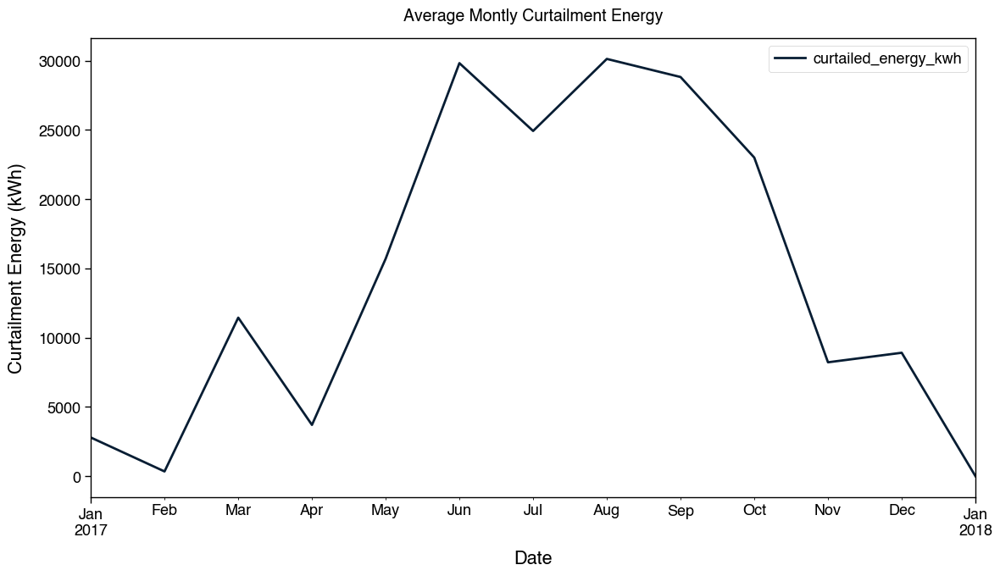

In [146]:
curtailed_energy_month = ts_tt_30min.resample('MS').agg({
    'curtailed_energy_kwh': 'sum',
    'turbine_energy_kwh': 'sum',
    'turbine_energy_max_kwh': 'sum',
    'season': 'first',
    'month': 'first'
})

print(f"Total curtailed energy (kWh): {(curtailed_energy_month['curtailed_energy_kwh'].sum()/10**6):,.2f} GWh")
curtailed_energy_month.plot(y=['curtailed_energy_kwh'], use_index=True, figsize=(12,7))
plt.title('Average Montly Curtailment Energy')
plt.xlabel('Date')
plt.ylabel('Curtailment Energy (kWh)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-7_1.png', dpi=300)
plt.show()

,curtailed_energy_kwh,turbine_energy_kwh,turbine_energy_max_kwh,curtailment_over_power_prop,curtailment_prop
season,,,,,
Summer,84899.272310,5.383733e+05,6.940989e+05,0.122316,0.451956
Autumn,60060.674178,1.064345e+06,1.181302e+06,0.050843,0.319729
Spring,30851.238356,6.566614e+05,7.038371e+05,0.043833,0.164235
Winter,12037.335603,1.147063e+06,1.202934e+06,0.010007,0.064080


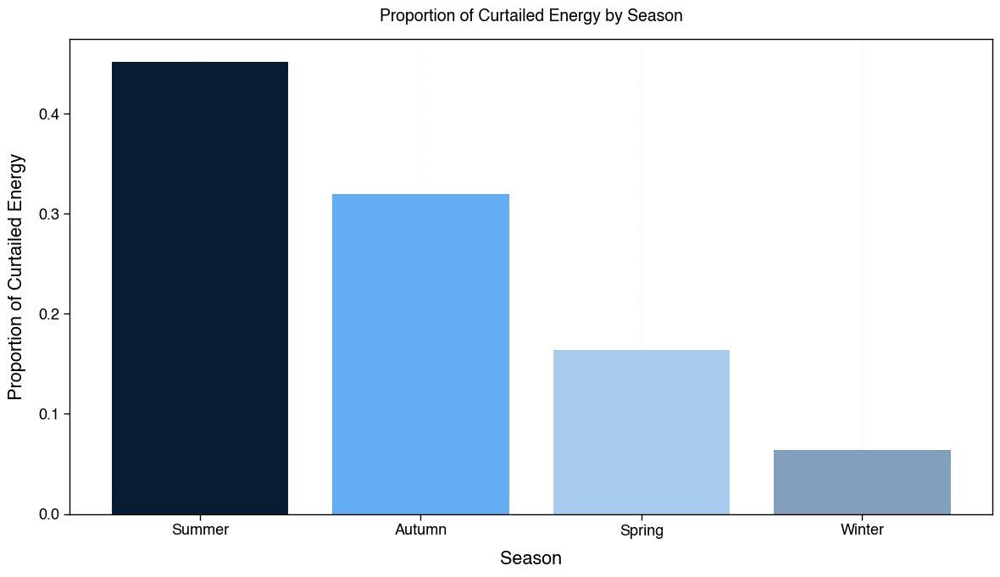

In [150]:
# Proportion of curtailed energy by season
seasonal_curtailment = curtailed_energy_month.groupby('season').agg({
    'curtailed_energy_kwh': 'sum',
    'turbine_energy_kwh': 'sum',
    'turbine_energy_max_kwh': 'sum'
})
seasonal_curtailment['curtailment_over_power_prop'] = seasonal_curtailment['curtailed_energy_kwh'] / seasonal_curtailment['turbine_energy_max_kwh']
seasonal_curtailment['curtailment_prop'] = seasonal_curtailment['curtailed_energy_kwh'] / seasonal_curtailment['curtailed_energy_kwh'].sum()
# sort by curtailment_prop
seasonal_curtailment = seasonal_curtailment.sort_values(by='curtailment_prop', ascending=False)
display(seasonal_curtailment)

#plot seasonal curtailment
plt.figure(figsize=(12, 7))
plt.bar(seasonal_curtailment.index, seasonal_curtailment['curtailment_prop'], color=custom_colors[:len(seasonal_curtailment)])
plt.title('Proportion of Curtailed Energy by Season')
plt.xlabel('Season')
plt.ylabel('Proportion of Curtailed Energy')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-7_2.png', dpi=300)
plt.show()

<a id="appendix-2-7-1"></a>
### Appendix 2.7.1 Curtailment Patterns by Time


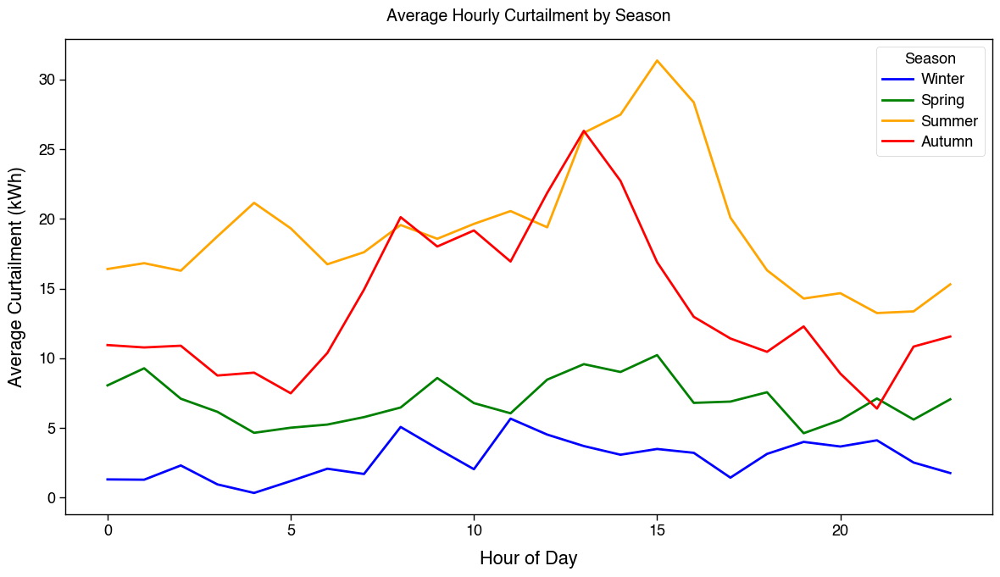

In [152]:
# hourly average curtailment per season
hourly_seasonal_curtailment = ts_tt_30min.groupby(['season', 'hour'])['curtailed_energy_kwh'].mean().reset_index()

#plot into line chart
plt.figure(figsize=(12, 7))
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Winter']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Winter']['curtailed_energy_kwh'],
    label='Winter',
    color='blue'
)
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Spring']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Spring']['curtailed_energy_kwh'],
    label='Spring',
    color='green'
)
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Summer']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Summer']['curtailed_energy_kwh'],
    label='Summer',
    color='orange'
)
plt.plot(
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Autumn']['hour'],
    hourly_seasonal_curtailment[hourly_seasonal_curtailment['season'] == 'Autumn']['curtailed_energy_kwh'],
    label='Autumn',
    color='red'
)
plt.title('Average Hourly Curtailment by Season')
plt.xlabel('Hour of Day')
plt.ylabel('Average Curtailment (kWh)')
plt.legend(title='Season')
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-7-1.png', dpi=300)
plt.show()

In [ ]:
pd.DataFrame([{
    'Average Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].mean(),
    'Standard Deviation Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].std(),
    'Max Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].max(),
    'Min Curtailment Energy (kWh)': ts_tt_30min['curtailed_energy_kwh'].min(),
    'Average Maximum Energy (kWh)': ts_tt_30min['turbine_energy_max_kwh'].mean(),
}]).T.rename(columns={0: 'Value'})

,Value
Average Curtailment Energy (kWh),21.385305
Standard Deviation Curtailment Energy (kWh),81.924935
Max Curtailment Energy (kWh),450.000000
Min Curtailment Energy (kWh),0.000000
Average Maximum Energy (kWh),215.287540


<a id="appendix-2-7-3"></a>
### Appendix 2.7.3 – Curtailment Type Breakdown



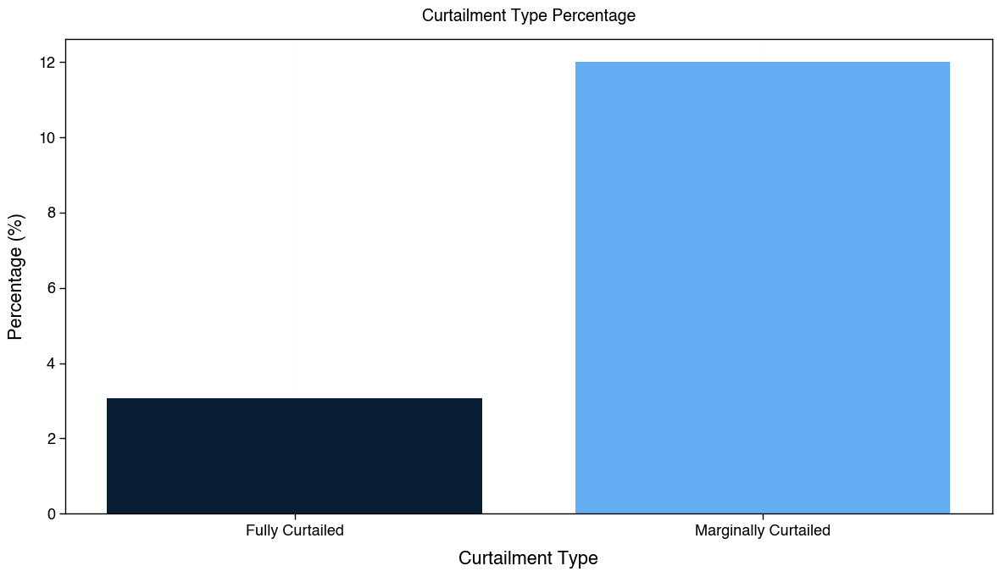

In [154]:
fully_curtailed = ts_tt_30min[ts_tt_30min['turbine_setpoint_kw'] == 0].shape[0]
marginally_curtailed = ts_tt_30min[ts_tt_30min['turbine_setpoint_kw'] < 900].shape[0]
total_data = ts_tt_30min.shape[0]

curtailment_summary = pd.DataFrame({
    'Curtailment Type': ['Fully Curtailed', 'Marginally Curtailed'],
    'Count': [fully_curtailed, marginally_curtailed],
    'Percentage': [
        (fully_curtailed / total_data) * 100,
        (marginally_curtailed / total_data) * 100
    ]
})

#plot the curtailment summary
plt.figure(figsize=(12, 7))
plt.bar(
    curtailment_summary['Curtailment Type'],
    curtailment_summary['Percentage'],
    color=custom_colors[:len(curtailment_summary)]  # Slice to match number of bars
)
plt.title('Curtailment Type Percentage')
plt.xlabel('Curtailment Type')
plt.ylabel('Percentage (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-7-3.png', dpi=300)
plt.show()



<a id="appendix-2-7-4"></a>
### Appendix 2.7.4 – Curtailment Proportion and Load Factor



The **curtailment proportion** is a measure of how efficiently a wind turbine is operating relative to its maximum possible capacity. It is calculated by dividing the **average power output** by the **potential maximum capacity** of the turbine. This metric provides insight into the turbine's curtailment ration over time.


$$
\text{Curtailment Factor} = \frac{\text{Curtailed Output}}{\text{Turbine Generated Output}}
$$


In [ ]:
curtailment_factor = ts_tt_30min['curtailed_energy_kwh'].sum()/ts_tt_30min['turbine_energy_kwh'].sum()

print(f'Turbine Curtailment Proportion: {curtailment_factor:.2%}')


Turbine Curtailment Proportion: 11.03%


In [ ]:
# Turbine load factor
load_factor = ts_tt_30min['turbine_power_kw'].mean() / 900

print(f"Turbine Load Factor: {load_factor:.2%}")

Turbine Load Factor: 45.72%


<a id="appendix-2-8"></a>
### Appendix 2.8 – Scaling Curtailment with Installed Capacity



| Location                                | ANM Zone | Commissioned | IC (kW) |
|-----------------------------------------|----------|--------------|---------|
| Thorfinn Wind Farm                      | 1a       | 01/04/2000   | 2,700   |
| Thorfinn Wind Energy Project (NM1500)   | 1a       | 01/04/2000   | 1,500   |
| Burgar Hill                             | 1a       | 01/11/2000   | 1,300   |
| Northfield Wind Energy Project Burray- A,C | 4a   | 01/02/2005   | 850     |
| Burgar Hill Wind Farm - A               | 1a       | 01/12/2006   | 5,000   |
| Birsay Energy                           | 1a       | 01/09/2009   | 900     |
| Gallow Hill, Westray                    | 1        | 11/09/2009   | 900     |
| Burgar Hill Renewables 1               | 1a       | 01/10/2009   | 2,300   |
| Flotta Wind Farm                        | 3        | 18/06/2010   | 2,000   |
| Hammars Hill                            | 1        | 23/08/2010   | 4,500   |
| Trumland Farm, Rousay                   | 1        | 18/02/2011   | 80      |
| Ore Brae Wind Farm                      | 3        | 21/09/2011   | 900     |
| Kingarly Hill Wind Turbine             | 1        | 22/09/2011   | 900     |
| Hatston Wind Turbine                   | Core     | 05/10/2011   | 900     |
| Braefoot Wind Farm                      | 2        | 21/10/2011   | 900     |
| Rothiesholm Head Wind Farm             | 2a       | 17/11/2011   | 900     |
| Thorkell Deerness                       | 4a       | 09/03/2012   | 910     |
| Cleat, Work Road, St. Ola              | Core     | 17/09/2012   | 83      |
| Spurness Wind Farm II                   | 2b       | 22/10/2012   | 10,000  |
| Fea, Holm                               | 4        | 06/11/2012   | 83      |
| Banks (Land Near), Rousay              | 1        | 26/11/2012   | 80      |
| Sandybanks, Eday                        | 1        | 27/11/2012   | 910     |
| Wasbister, South Ronaldsay             | 4a       | 28/11/2012   | 55      |
| Dalespot Hill                           | Core     | 29/01/2013   | 80      |
| Hammer, Skelwick, Westray              | 1        | 27/02/2013   | 500     |
| Barns of Ayre                           | 4        | 03/07/2013   | 2,730   |
| Scapa, St Ola                           | Core     | 26/09/2013   | 83      |
| Mount Pleasant, Haybrake Road South Ronaldsay | 4a | 08/10/2013   | 65      |
| Blackawall Cottage, Flotta             | 3        | 16/10/2013   | 83      |
| DG Westray                              | 1        | 17/10/2013   | 500     |
| Towerhill, St Ola                       | Core     | 03/03/2014   | 83.3    |
| East Hammer, Westray                   | 1        | 24/03/2014   | 55      |
| Rennibister, Firth                      | Core     | 28/03/2014   | 910     |
| New Holland, Holm                       | 4        | 20/11/2014   | 500     |
| Ludenhill Farm (Land Near)             | 1a       | 27/09/2016   | 500     |

Data on planning permissions granted by OIC16 show a total capacity of 6031.6kW for small turbines (under 50kW). The majority of these turbines are between 5 and 20kW as shown in (Figure 2.4).

[Orkney Energy Audit 2014](https://www.oref.co.uk/wp-content/uploads/2015/05/Orkney-wide-energy-audit-2014-Energy-Sources-and-Uses.pdf)

In [171]:
large_scale_turbines_table = '''
| Location                                | ANM Zone | Commissioned | IC (kW) |
|-----------------------------------------|----------|--------------|---------|
| Thorfinn Wind Farm                      | 1a       | 01/04/2000   | 2,700   |
| Thorfinn Wind Energy Project (NM1500)   | 1a       | 01/04/2000   | 1,500   |
| Burgar Hill                             | 1a       | 01/11/2000   | 1,300   |
| Northfield Wind Energy Project Burray- A,C | 4a   | 01/02/2005   | 850     |
| Burgar Hill Wind Farm - A               | 1a       | 01/12/2006   | 5,000   |
| Birsay Energy                           | 1a       | 01/09/2009   | 900     |
| Gallow Hill, Westray                    | 1        | 11/09/2009   | 900     |
| Burgar Hill Renewables 1               | 1a       | 01/10/2009   | 2,300   |
| Flotta Wind Farm                        | 3        | 18/06/2010   | 2,000   |
| Hammars Hill                            | 1        | 23/08/2010   | 4,500   |
| Trumland Farm, Rousay                   | 1        | 18/02/2011   | 80      |
| Ore Brae Wind Farm                      | 3        | 21/09/2011   | 900     |
| Kingarly Hill Wind Turbine             | 1        | 22/09/2011   | 900     |
| Hatston Wind Turbine                   | Core     | 05/10/2011   | 900     |
| Braefoot Wind Farm                      | 2        | 21/10/2011   | 900     |
| Rothiesholm Head Wind Farm             | 2a       | 17/11/2011   | 900     |
| Thorkell Deerness                       | 4a       | 09/03/2012   | 910     |
| Cleat, Work Road, St. Ola              | Core     | 17/09/2012   | 83      |
| Spurness Wind Farm II                   | 2b       | 22/10/2012   | 10,000  |
| Fea, Holm                               | 4        | 06/11/2012   | 83      |
| Banks (Land Near), Rousay              | 1        | 26/11/2012   | 80      |
| Sandybanks, Eday                        | 1        | 27/11/2012   | 910     |
| Wasbister, South Ronaldsay             | 4a       | 28/11/2012   | 55      |
| Dalespot Hill                           | Core     | 29/01/2013   | 80      |
| Hammer, Skelwick, Westray              | 1        | 27/02/2013   | 500     |
| Barns of Ayre                           | 4        | 03/07/2013   | 2,730   |
| Scapa, St Ola                           | Core     | 26/09/2013   | 83      |
| Mount Pleasant, Haybrake Road South Ronaldsay | 4a | 08/10/2013   | 65      |
| Blackawall Cottage, Flotta             | 3        | 16/10/2013   | 83      |
| DG Westray                              | 1        | 17/10/2013   | 500     |
| Towerhill, St Ola                       | Core     | 03/03/2014   | 83.3    |
| East Hammer, Westray                   | 1        | 24/03/2014   | 55      |
| Rennibister, Firth                      | Core     | 28/03/2014   | 910     |
| New Holland, Holm                       | 4        | 20/11/2014   | 500     |
| Ludenhill Farm (Land Near)             | 1a       | 27/09/2016   | 500     |
'''

small_scale_turbines_capacity = 4720.3 # kW

cleaned_table = '\n'.join([line for line in large_scale_turbines_table.split('\n') if not set(line.strip()) <= set('-| ')])

# Read again after removing the invalid separator line
df_large_scale_turbine = pd.read_csv(StringIO(cleaned_table), sep='|', skipinitialspace=True)

# Drop unnamed columns and clean up
df_large_scale_turbine = df_large_scale_turbine.loc[:, ~df_large_scale_turbine.columns.str.contains('^Unnamed')]

df_large_scale_turbine.columns = df_large_scale_turbine.columns.str.strip()

# Remove commas from numeric column and convert to float
df_large_scale_turbine["IC (kW)"] = df_large_scale_turbine["IC (kW)"].str.replace(',', '').astype(float)

reference_index = 11 # we are assuming Ore Brae Wind Farm is the reference turbine

df_large_scale_turbine['relative_position'] = df_large_scale_turbine.index - reference_index

df_large_scale_turbine.head()

,Location,ANM Zone,Commissioned,IC (kW),relative_position
0,Thorfinn Wind Farm,1a,01/04/2000,2700.0,-11
1,Thorfinn Wind Energy Project (NM1500),1a,01/04/2000,1500.0,-10
2,Burgar Hill,1a,01/11/2000,1300.0,-9
3,"Northfield Wind Energy Project Burray- A,C",4a,01/02/2005,850.0,-8
4,Burgar Hill Wind Farm - A,1a,01/12/2006,5000.0,-7


We will scale our turbine telemetry data using a **proportional scaling approach**, based on the installed capacity of each turbine. This is a simplified method that assumes turbine output scales linearly with rated capacity. While this does not capture site-specific variations such as local wind conditions or turbine technology, it provides a reasonable approximation in the absence of detailed data for each location.

The ANM operates on a **Last-In, First-Out (LIFO)** basis, meaning that newer turbines are curtailed more frequently than older ones. As a result, actual generation profiles may vary significantly across turbines depending on their commissioning date and ANM zone.


In [172]:
ts_normalized = ts_tt_30min.copy()

# normalized columns turbine_power_kw, turbine_setpoint_kw, turbine_power_max_kw, curtailed_power_kw, turbine_energy_kwh, turbine_energy_max_kwh, curtailed_energy_kwh by 900

ts_normalized['turbine_power_kw'] = ts_normalized['turbine_power_kw'] / 900
ts_normalized['turbine_setpoint_kw'] = ts_normalized['turbine_setpoint_kw'] / 900
ts_normalized['turbine_power_max_kw'] = ts_normalized['turbine_power_max_kw'] / 900
ts_normalized['turbine_energy_kwh'] = ts_normalized['turbine_energy_kwh'] / 900
ts_normalized['turbine_energy_max_kwh'] = ts_normalized['turbine_energy_max_kwh'] / 900
ts_normalized['curtailed_energy_kwh'] = ts_normalized['curtailed_energy_kwh'] / 900

# drop all columns except the ones we normalized
ts_normalized = ts_normalized[['turbine_power_kw', 'turbine_setpoint_kw', 'turbine_power_max_kw', 'turbine_energy_kwh', 'turbine_energy_max_kwh', 'curtailed_energy_kwh']]

ts_normalized.head()

,turbine_power_kw,turbine_setpoint_kw,turbine_power_max_kw,turbine_energy_kwh,turbine_energy_max_kwh,curtailed_energy_kwh
Timestamp,,,,,,
2017-01-01 00:00:00,0.993370,1.0,0.959164,0.496685,0.479582,0.0
2017-01-01 00:30:00,0.998074,1.0,0.996351,0.499037,0.498176,0.0
2017-01-01 01:00:00,1.003185,1.0,0.997432,0.501593,0.498716,0.0
2017-01-01 01:30:00,1.008704,1.0,0.999027,0.504352,0.499514,0.0
2017-01-01 02:00:00,1.007778,1.0,0.998545,0.503889,0.499272,0.0


<a id="appendix-2-8-1"></a>
### Appendix 2.8.1 – Scale Turbine with LIFO Logic



In this section, we simulate the **Last In First Out (LIFO)** curtailment policy implemented by the **Active Network Management (ANM)** system in Orkney. Under this system, **newer turbines (commissioned later)** are curtailed **before** older turbines whenever network constraints require reduced generation. This results in **asymmetric curtailment** across the fleet, with **older turbines experiencing higher effective load factors** over time due to their preferential dispatch.

**Assumptions:**

To create a simplified and consistent simulation:

* We use a normalized time series based representative data from **Ore Brae Wind Farm**, a turbine with:

  * Installed Capacity (**IC**) = 900 kW
  * Commissioning Date = 21/09/2011
  * Baseline **Load Factor (LF\_baseline)** = **0.457228**, calculated as:

  $$
  \text{LF}_{\text{baseline}} = \frac{\bar{P}_{\text{OreBrae}}}{IC_{\text{OreBrae}}} = \frac{411.5}{900} \approx 0.457228
  $$

* The normalized generation profile is scaled to each turbine’s installed capacity using:

  $$
  P_{i,t} = P_{\text{normalized},t} \times IC_i
  $$

Each turbine is assigned a **`relative_position`** based on its commissioning order relative to Ore Brae:

* `relative_position = 0`: Baseline (Ore Brae)
* `relative_position < 0`: Older turbines → **higher priority**, **less curtailment**
* `relative_position > 0`: Newer turbines → **lower priority**, **more curtailment**

To simulate the impact of LIFO on generation, we adjust the **load factor** of each turbine based on its relative position. Specifically, we apply a **linear multiplier** to the baseline load factor:

$$
\text{LF}_i = \text{LF}_{\text{baseline}} \times \left(1 - r_i \cdot \delta \right)
$$

Where:

* $r_i$ = `relative_position` of turbine *i*
* $\delta$ = load factor change per position step (e.g., **0.02**, or 2% per step)
* LF is clipped between 0.2 and 1.3 of baseline for realism

This adjustment simulates the **cumulative disadvantage** that newer turbines face under LIFO dispatch.

The adjusted generation profile is then rescaled to match the desired average power output implied by the new load factor:

$$
\bar{P}_{i,\text{target}} = \text{LF}_i \times IC_i
$$

$$
P_{i,t}^{\text{scaled}} = \min\left(P^{\text{setpoint}}_{i,t}, \; P_{i,t} \times \left(\frac{\bar{P}_{i,\text{target}}}{\bar{P}_{i,\text{original}}} \right) \right)
$$

In [173]:
df_scaled_turbine_lifo = pd.DataFrame()

baseline_lf = load_factor
lf_change_per_step_up = 0.02
lf_change_per_step_down = 0.005

for turbine in df_large_scale_turbine['Location']:
    turbine_IC = df_large_scale_turbine[df_large_scale_turbine['Location'] == turbine]['IC (kW)'].values[0]
    relative_pos = df_large_scale_turbine[df_large_scale_turbine['Location'] == turbine]['relative_position'].values[0]

    # Scale the normalized power by IC (installed capacity)
    turbine_data = ts_normalized.copy() * turbine_IC

    # Calculate current average power
    current_avg_power = turbine_data['turbine_power_kw'].mean()

    if relative_pos != 0:
        lf_change_per_pos = 0.02

        # Positive means worse, negative means better
        lf_multiplier = 1 - (relative_pos * lf_change_per_step_up) if relative_pos > 0 else 1 - ((relative_pos) * lf_change_per_step_down)
        # Optional: Cap it to avoid unreasonable scaling
        lf_multiplier = max(0.7, min(1.1, lf_multiplier))  # allows 50% to 140% of baseline LF
        # print(f"Relative Position: {relative_pos}, LF Multiplier: {lf_multiplier:.2f}")

        adjusted_lf = baseline_lf * lf_multiplier
        adjusted_avg_power = adjusted_lf * turbine_IC

        # Rescale the power time series
        scaling_factor = adjusted_avg_power / current_avg_power
        turbine_data['turbine_power_kw'] = np.where(
            turbine_data['turbine_setpoint_kw'] < turbine_IC,
            turbine_data['turbine_power_kw'] * scaling_factor,
            turbine_data['turbine_power_kw']
        )
        

        # Clip values so they don't exceed technical limits
        turbine_data['turbine_power_kw'] = turbine_data['turbine_power_kw'].clip(
        upper=np.minimum(turbine_data['turbine_setpoint_kw'], turbine_data['turbine_power_max_kw']),
        lower=0
        )

        #recalculate currtailment, energy kwh and curtailed energy
        turbine_data['curtailed_power_kw'] = (turbine_data['turbine_power_max_kw'] - turbine_data['turbine_power_kw']).clip(lower=0)
        turbine_data['turbine_energy_kwh'] = turbine_data['turbine_power_kw'] * 0.5
        turbine_data['curtailed_energy_kwh'] = turbine_data['curtailed_power_kw'] * 0.5
    turbine_data['turbine_ic'] = turbine_IC
    turbine_data['turbine_name'] = turbine
    # append to the dataframe
    df_scaled_turbine_lifo = pd.concat([df_scaled_turbine_lifo, turbine_data], axis=0)

df_small_scale_turbine = ts_normalized.copy() * small_scale_turbines_capacity
df_small_scale_turbine['turbine_name'] = 'Small Scale Turbines'
df_small_scale_turbine['turbine_energy_kwh'] = df_small_scale_turbine['turbine_power_kw'] * 0.5
df_scaled_turbine_lifo = pd.concat([df_scaled_turbine_lifo, df_small_scale_turbine], axis=0)

#reorder timestamp to chronological order
df_scaled_turbine_lifo = df_scaled_turbine_lifo.sort_index()

df_scaled_turbine_lifo.head()


,turbine_power_kw,turbine_setpoint_kw,turbine_power_max_kw,turbine_energy_kwh,turbine_energy_max_kwh,curtailed_energy_kwh,curtailed_power_kw,turbine_ic,turbine_name
Timestamp,,,,,,,,,
2017-01-01,2589.742033,2700.0,2589.742033,1294.871017,1294.871017,0.0,0.0,2700.0,Thorfinn Wind Farm
2017-01-01,76.733097,80.0,76.733097,38.366549,38.366549,0.0,0.0,80.0,Dalespot Hill
2017-01-01,52.754004,55.0,52.754004,26.377002,26.377002,0.0,0.0,55.0,"Wasbister, South Ronaldsay"
2017-01-01,863.247344,900.0,863.247344,431.623672,431.623672,0.0,0.0,900.0,Birsay Energy
2017-01-01,79.610588,83.0,79.610588,39.805294,39.805294,0.0,0.0,83.0,"Cleat, Work Road, St. Ola"


In [174]:
# small scaled annual energy production
annual_small_scale_generation_lifo = df_scaled_turbine_lifo[df_scaled_turbine_lifo['turbine_name'] == 'Small Scale Turbines']['turbine_energy_kwh'].sum() / 10**6
annual_large_scale_generation_lifo = df_scaled_turbine_lifo[df_scaled_turbine_lifo['turbine_name'] != 'Small Scale Turbines']['turbine_energy_kwh'].sum() / 10**6

print(f"Annual Small Scale Turbine Generation: {annual_small_scale_generation_lifo:.2f} GWh")
print(f"Annual Large Scale Turbine Generation: {annual_large_scale_generation_lifo:.2f} GWh\n")

# total annual energy produced
total_annual_energy_scaled_lifo = df_scaled_turbine_lifo['turbine_energy_kwh'].sum()/10**6
# curtailment energy annually
total_annual_curtailment_energy_scaled_lifo = df_scaled_turbine_lifo['curtailed_energy_kwh'].sum()/10**6

print(f'Total annual energy produced (GWh): {total_annual_energy_scaled_lifo:.2f} GWh')
print(f'Total annual curtailed energy (GWh): {total_annual_curtailment_energy_scaled_lifo:.2f} GWh')
print(f"Percentage of curtailed energy: {(total_annual_curtailment_energy_scaled_lifo/total_annual_energy_scaled_lifo)*100:.2f}%")

Annual Small Scale Turbine Generation: 17.87 GWh
Annual Large Scale Turbine Generation: 162.50 GWh

Total annual energy produced (GWh): 180.37 GWh
Total annual curtailed energy (GWh): 26.31 GWh
Percentage of curtailed energy: 14.59%


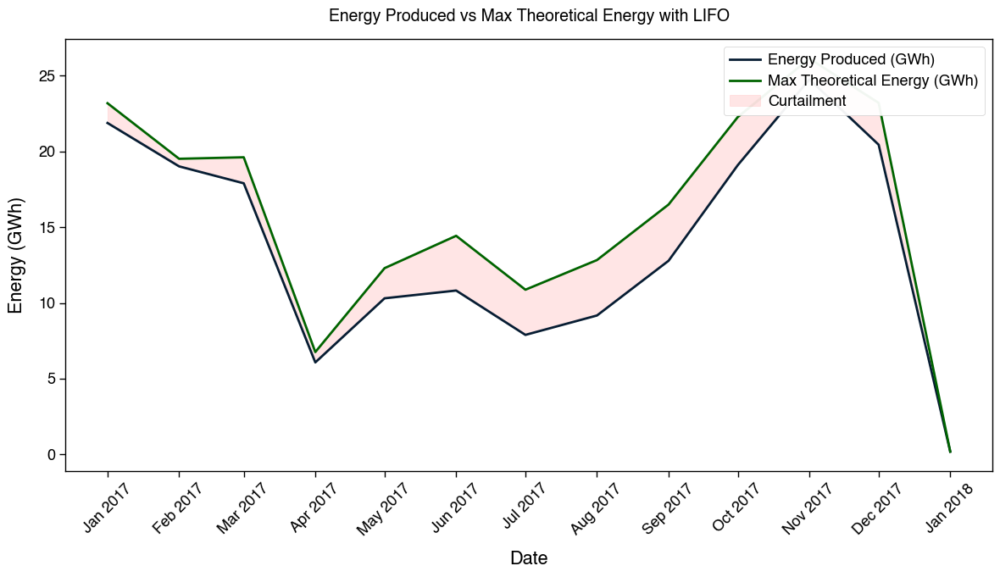

In [177]:
# Plot energy produced and max theoretical energy
#resample to daily
monthly_scaled_turbine_lifo = df_scaled_turbine_lifo.resample('MS').agg({
    'turbine_energy_kwh': 'sum',
    'turbine_energy_max_kwh': 'sum',
    'curtailed_energy_kwh': 'sum'
})
# Convert to GWh
monthly_scaled_turbine_lifo = monthly_scaled_turbine_lifo / 10**6

plt.figure(figsize=(12, 7))
plt.plot(monthly_scaled_turbine_lifo.index, monthly_scaled_turbine_lifo['turbine_energy_kwh'], label='Energy Produced (GWh)')
plt.plot(monthly_scaled_turbine_lifo.index, monthly_scaled_turbine_lifo['turbine_energy_max_kwh'], label='Max Theoretical Energy (GWh)', color='darkgreen')
# shade curtailment area
plt.fill_between(
    monthly_scaled_turbine_lifo.index,
    monthly_scaled_turbine_lifo['turbine_energy_max_kwh'],
    monthly_scaled_turbine_lifo['turbine_energy_kwh'],
    color='red',
    alpha=0.1,
    label='Curtailment'
)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))  # e.g., Jan 2017
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.xticks(rotation=45)

plt.title('Energy Produced vs Max Theoretical Energy with LIFO')
plt.xlabel('Date')
plt.ylabel('Energy (GWh)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_2-8-1.png', dpi=300)
plt.show()

<Figure size 1200x700 with 0 Axes>

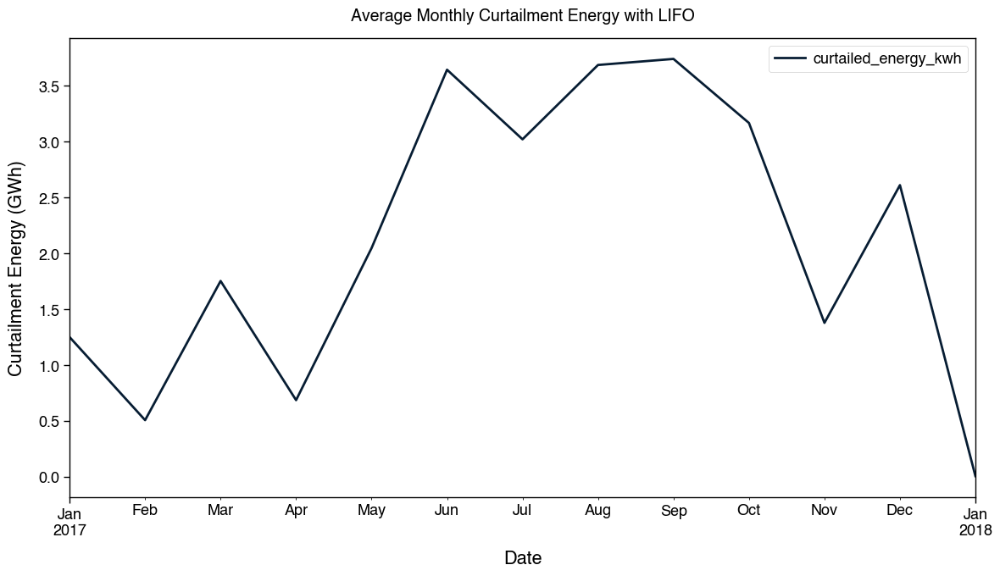

In [90]:
df_scaled_merge_lifo = df_scaled_turbine_lifo.groupby(df_scaled_turbine_lifo.index).sum()

# plot curtailment energy resampled to monthly for df_scaled_merge_lifo
monthly_scaled_curtailment_lifo = df_scaled_merge_lifo.resample('MS').agg({
    'curtailed_energy_kwh': 'sum',
    'turbine_energy_kwh': 'sum',
    'turbine_energy_max_kwh': 'sum'
})
# Convert to GWh
monthly_scaled_curtailment_lifo = monthly_scaled_curtailment_lifo / 10**6
plt.figure(figsize=(12, 7))
monthly_scaled_curtailment_lifo.plot(
    y='curtailed_energy_kwh',
    use_index=True,
    figsize=(12, 7),
    title='Average Monthly Curtailment Energy with LIFO'
)
plt.xlabel('Date')
plt.ylabel('Curtailment Energy (GWh)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()



In [91]:
# put season, month, year, date into the df_scaled_merge_lifo using ts_tt_30min
df_scaled_merge_lifo = df_scaled_merge_lifo.join(ts_tt_30min[['hour', 'month','season', 'year', 'date']], how='left')
df_scaled_merge_lifo.head()

,turbine_power_kw,turbine_setpoint_kw,turbine_power_max_kw,turbine_energy_kwh,turbine_energy_max_kwh,curtailed_energy_kwh,curtailed_power_kw,turbine_ic,turbine_name,hour,month,season,year,date
Timestamp,,,,,,,,,,,,,,
2017-01-01 00:00:00,47633.064548,49460.6,47440.812888,23816.532274,23720.406444,0.0,0.0,44740.3,Thorfinn Wind Farm Dalesp...,0,1,Winter,2017,2017-01-01
2017-01-01 00:30:00,49289.804147,49460.6,49280.120170,24644.902074,24640.060085,0.0,0.0,44740.3,"Mount Pleasant, Haybrake Road South Ronaldsay ...",0,1,Winter,2017,2017-01-01
2017-01-01 01:00:00,49365.914534,49460.6,49333.579231,24682.957267,24666.789616,0.0,0.0,44740.3,Burgar Hill Wind Farm - A Towerh...,1,1,Winter,2017,2017-01-01
2017-01-01 01:30:00,49466.861798,49460.6,49412.475946,24733.430899,24706.237973,0.0,0.0,44740.3,"Wasbister, South Ronaldsay Mount P...",1,1,Winter,2017,2017-01-01
2017-01-01 02:00:00,49440.504451,49460.6,49388.610732,24720.252226,24694.305366,0.0,0.0,44740.3,Dalespot Hill Kingar...,2,1,Winter,2017,2017-01-01


<a id="appendix-3-1"></a>
### Appendix 3.1 – Time Series Analysis



In [179]:
# load residential demand data
df_rd = pd.read_csv(RAW_DATASET_PATH / 'Residential_demand.csv')

# rename columns
df_rd = df_rd.rename(columns={
    'Demand_mean_kw': 'res_power_mean_kw',
    'N_households': 'res_sampled_households'
})

df_rd['Timestamp'] = pd.to_datetime(df_rd['Timestamp'])
df_rd['date'] = pd.to_datetime(df_rd['Timestamp']).dt.date
df_rd['hour'] = pd.to_datetime(df_rd['Timestamp']).dt.hour
df_rd['month'] = pd.to_datetime(df_rd['Timestamp']).dt.month
df_rd['year'] = pd.to_datetime(df_rd['Timestamp']).dt.year
df_rd['season'] = pd.to_datetime(df_rd['Timestamp']).dt.month % 12 // 3 + 1

# rename season to Winter, Spring, Summer, Autumn
df_rd['season'] = df_rd['season'].replace({
    1: 'Winter',
    2: 'Spring',
    3: 'Summer',
    4: 'Autumn'
})

ts_rd = df_rd.set_index('Timestamp').copy()

display(ts_rd.head())

print(f"Start date: {ts_rd.index.min()}")
print(f"End date: {ts_rd.index.max()}")

,res_power_mean_kw,res_sampled_households,date,hour,month,year,season
Timestamp,,,,,,,
2017-01-01 00:00:00,0.220106,5428,2017-01-01,0,1,2017,Winter
2017-01-01 00:30:00,0.205945,5429,2017-01-01,0,1,2017,Winter
2017-01-01 01:00:00,0.189090,5429,2017-01-01,1,1,2017,Winter
2017-01-01 01:30:00,0.173118,5429,2017-01-01,1,1,2017,Winter
2017-01-01 02:00:00,0.159051,5429,2017-01-01,2,1,2017,Winter


Start date: 2017-01-01 00:00:00
End date: 2018-01-01 23:30:00


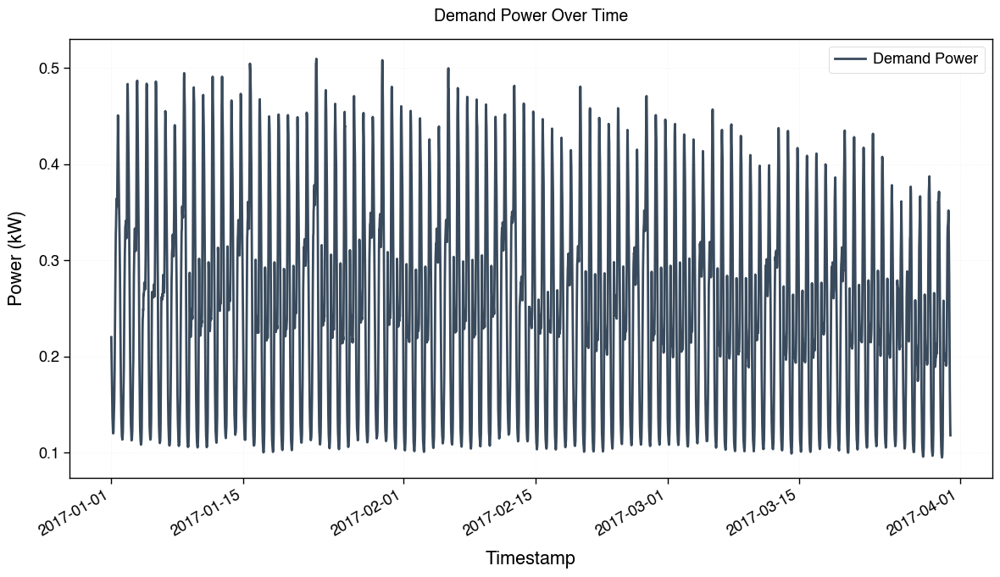

In [ ]:
ts_rd_zoom = ts_rd[(ts_rd.index >= '2017-01-01') & (ts_rd.index <= '2017-03-31')]

fig, ax = plt.subplots(figsize=(12, 7))
ax.plot(ts_rd_zoom.index, ts_rd_zoom['res_power_mean_kw'], label='Demand Power', alpha=0.8)
ax.set_title('Demand Power Over Time')
ax.set_xlabel('Timestamp')
ax.set_ylabel('Power (kW)')
ax.legend()
ax.grid(True)
fig.autofmt_xdate()
plt.tight_layout()
# plt.savefig(FIGURES_PATH / 'figure_3-1.png', dpi=300)
plt.show()

<a id="appendix-5-1-1"></a>
### Appendix 3.1.1 – Seasonal Decomposition



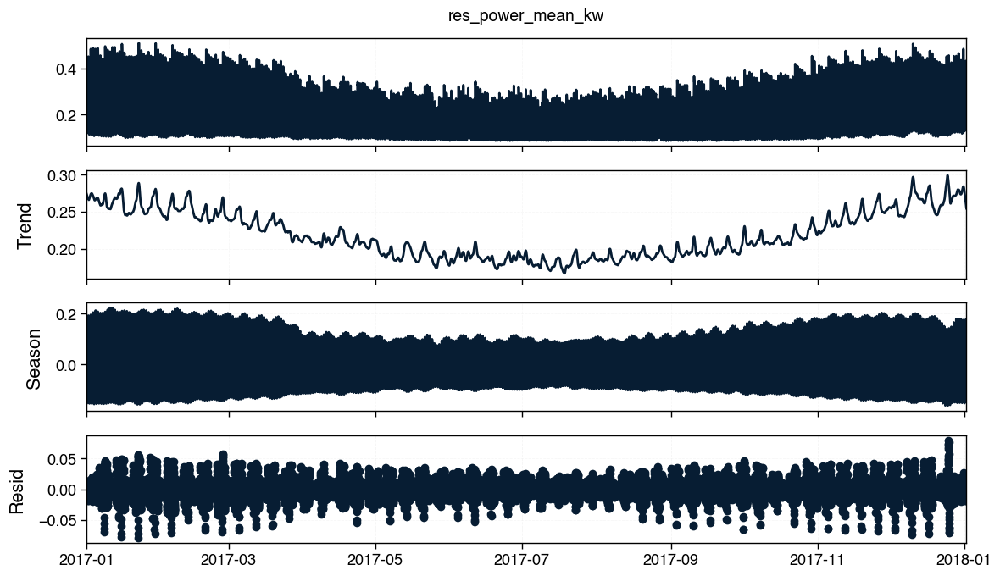

In [181]:
from statsmodels.tsa.seasonal import STL


stl = STL(ts_rd['res_power_mean_kw'], period=48)  # data is in 30-minute intervals, so period=48 for daily seasonality
res = stl.fit()

# Plot with custom size and layout
fig = res.plot()
fig.set_size_inches(12, 7)  # width, height in inches
plt.tight_layout()
plt.grid(True, axis='x', linestyle='--', alpha=0.4)
plt.savefig(FIGURES_PATH / 'figure_3-1-1.png', dpi=300, bbox_inches='tight')
plt.show()


Since the data is from Orkney, Scotland, the pattern starts to make a lot more sense. Orkney has a cool and often windy climate, with long daylight hours in the summer and short, dark days in the winter. A lot of homes rely on electricity for heating and lighting, especially in rural areas where other energy options might be limited.

The increase demand around September probably marks the start of colder weather. People begin using electric heaters, lights, and maybe cooking indoors more often as the days get shorter.

The daily pattern also becomes more extreme later in the year. That’s likely because people use more electricity in the mornings and evenings when it's darker and colder outside. So the bigger daily swings in the seasonal component match what you’d expect for Orkney’s winter life—lights on earlier, heaters running longer, and more indoor activity overall.

<a id="appendix-5-1-2"></a>
### Appendix 5.1.2 – Seasonal Decomposition by Season



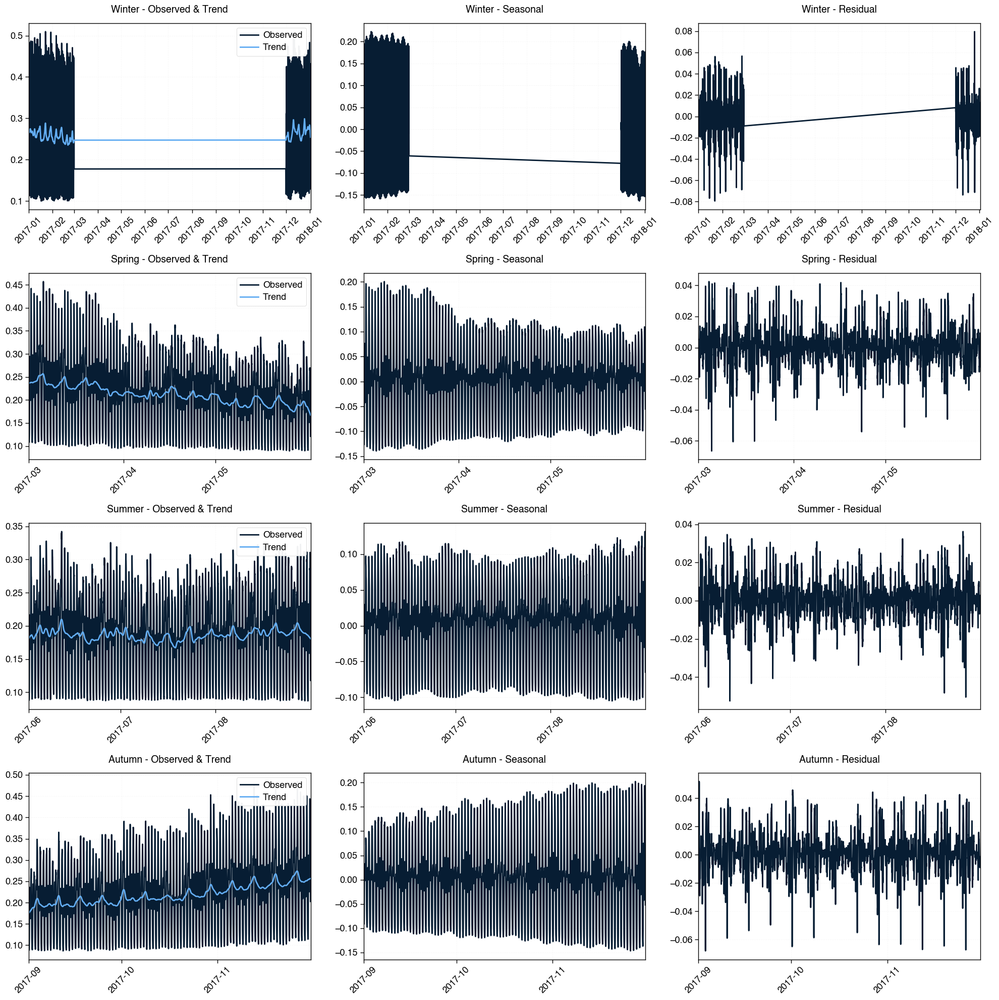

In [183]:
import matplotlib.dates as mdates

seasons = ts_rd['season'].unique()
fig, axs = plt.subplots(len(seasons), 3, figsize=(20, 20), sharex=False)

for i, season in enumerate(seasons):
    seasonal_df = ts_rd[ts_rd['season'] == season]
    stl = STL(seasonal_df['res_power_mean_kw'], period=48)
    res = stl.fit()

    # Get start and end for consistent x-axis
    x_start = seasonal_df.index.min()
    x_end = seasonal_df.index.max()

    # Observed + trend
    axs[i, 0].plot(seasonal_df.index, seasonal_df['res_power_mean_kw'], label='Observed')
    axs[i, 0].plot(seasonal_df.index, res.trend, label='Trend')
    axs[i, 0].set_title(f'{season} - Observed & Trend')
    axs[i, 0].legend()

    # Seasonal
    axs[i, 1].plot(seasonal_df.index, res.seasonal)
    axs[i, 1].set_title(f'{season} - Seasonal')

    # Residual
    axs[i, 2].plot(seasonal_df.index, res.resid)
    axs[i, 2].set_title(f'{season} - Residual')

    # Format x-axis for all three
    for ax in axs[i]:
        ax.set_xlim([x_start, x_end])
        ax.xaxis.set_major_locator(mdates.MonthLocator())
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
        ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_3-1-2.png', dpi=300, bbox_inches='tight')
plt.show()

Looking at the STL plots for each season, we can see clear changes in how people use electricity throughout the year. In winter, demand stays pretty steady at first, then shoots up toward the end of the season. The trend line backs that up, showing a big rise in overall usage most likely because it’s colder and darker, so people are using more heating and lights. The seasonal pattern doesn’t really kick in until later in the winter, which could mean more consistent daily routines or heavier use during mornings and evenings. The residuals in winter are a bit all over the place, especially as demand ramps up, suggesting there might have been some unusual events or just more unpredictable usage.

Spring demand decreases slowly as the season ended, this mark the end of spring where weather is getting warmer day by day. We can see it clearly in the seasonal graph.

Summer looks more stable than any other season. the trend doesnt deviate that much as well as the seasonal aspect. This is also suggested by the residual plot where we can see it is between 0.4 and -0.4 where as other season might jump to -0.6 to -0.8.

Autum is the opposite of spring, demand started low and increases towards the end of the season

<a id="appendix-3-2-1"></a>
### Appendix 3.2.1 – Average Demand by Season


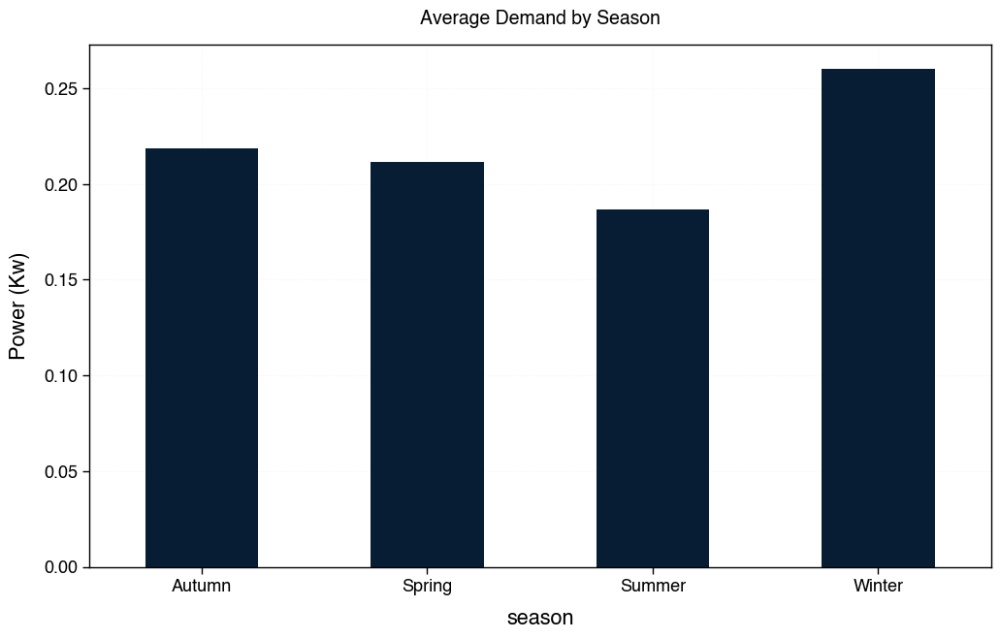

In [186]:
plt.figure(figsize=(12, 7))
ts_rd.groupby('season')['res_power_mean_kw'].mean().plot(kind='bar', title='Average Demand by Season')
plt.ylabel('Power (Kw)')
#rotate x-axis labels for better readability
plt.xticks(rotation=0)
plt.savefig(FIGURES_PATH / 'figure_3-2-1.png', dpi=300, bbox_inches='tight')
plt.show()

<a id="appendix-3-2-2"></a>
### Appendix 3.2.2 – Average Demand by Month



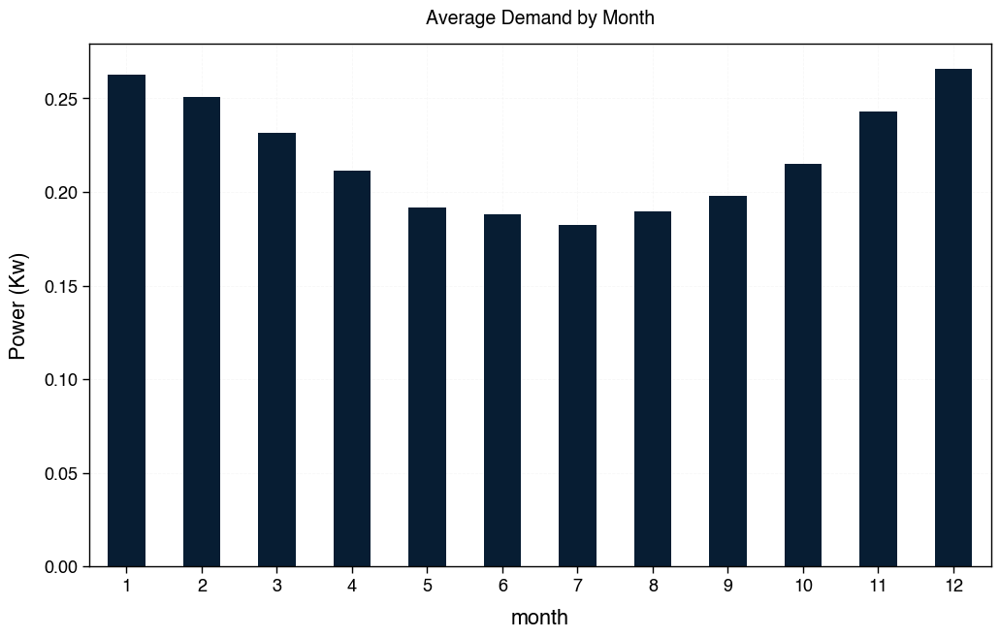

In [189]:
plt.figure(figsize=(12, 7))
ts_rd.groupby('month')['res_power_mean_kw'].mean().plot(kind='bar', title='Average Demand by Month')
plt.ylabel('Power (Kw)')
#rotate x-axis labels for better readability
plt.xticks(rotation=0)
plt.savefig(FIGURES_PATH / 'figure_3-2-2.png', dpi=300, bbox_inches='tight')
plt.show()

<a id="appendix-3-2-3"></a>
### Appendix 3.2.3 – Hourly Usage



Mean: 0.22 kW


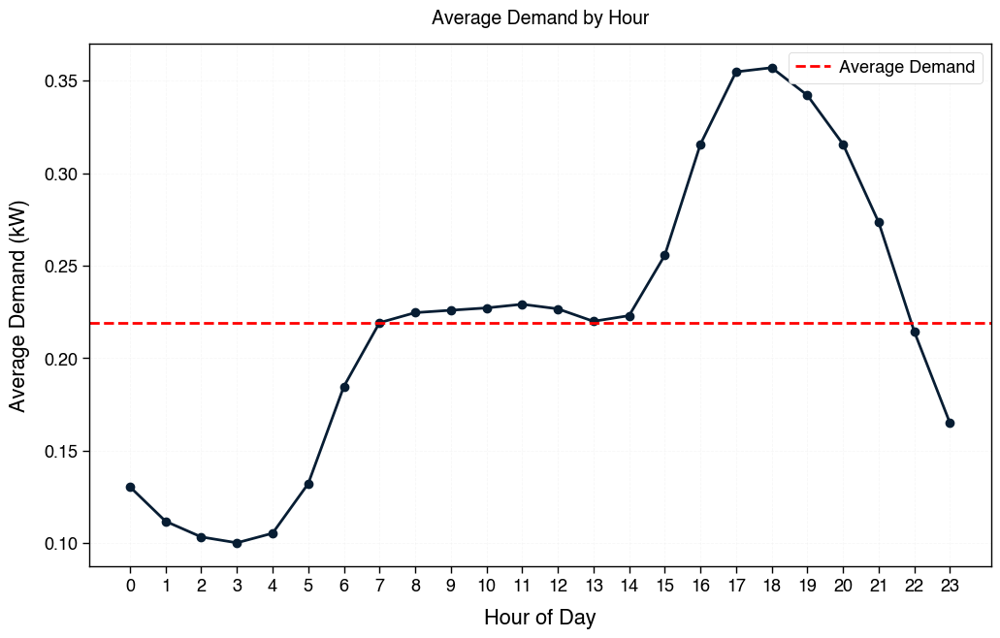

In [192]:
hourly_avg = ts_rd.groupby('hour')['res_power_mean_kw'].mean().reset_index()

print(f'Mean: {hourly_avg["res_power_mean_kw"].mean():.2f} kW')

plt.figure(figsize=(12, 7))
plt.plot(hourly_avg['hour'], hourly_avg['res_power_mean_kw'], marker='o')
# plot mean line
plt.axhline(y=hourly_avg['res_power_mean_kw'].mean(), color='r', linestyle='--', label='Average Demand')
plt.title("Average Demand by Hour")
plt.legend()
plt.xlabel("Hour of Day")
plt.ylabel("Average Demand (kW)")
plt.grid(True)
plt.xticks(range(0, 24))
plt.savefig(FIGURES_PATH / 'figure_3-2-3.png', dpi=300, bbox_inches='tight')
plt.show()

<a id="appendix-3-3"></a>
### Appendix 3.3 – Energy Conversion



In [198]:
ts_rd['res_energy_kwh'] = ts_rd['res_power_mean_kw'] * 0.5

ts_rd['res_total_power_kw'] = ts_rd['res_power_mean_kw'] * 10358
ts_rd['res_total_energy_kwh'] = ts_rd['res_total_power_kw'] * 0.5

ts_rd.tail()

,res_power_mean_kw,date,hour,month,year,season,res_energy_kwh,res_total_energy_kwh,res_total_power_kw
Timestamp,,,,,,,,,
2018-01-01 21:30:00,0.305905,2018-01-01,21,1,2018,Winter,0.152953,1584.282164,3168.564328
2018-01-01 22:00:00,0.282975,2018-01-01,22,1,2018,Winter,0.141488,1465.529588,2931.059176
2018-01-01 22:30:00,0.256498,2018-01-01,22,1,2018,Winter,0.128249,1328.404089,2656.808178
2018-01-01 23:00:00,0.245829,2018-01-01,23,1,2018,Winter,0.122914,1273.147426,2546.294852
2018-01-01 23:30:00,0.218793,2018-01-01,23,1,2018,Winter,0.109397,1133.129100,2266.258200


<a id="appendix-4-1"></a>
### Appendix 4.1 – System Overview



<a id="appendix-4-2"></a>
### Appendix 4.2 – Simulation Design & Operating Logic



In [131]:
EPSILON = 1e-6  # tolerance for floating point comparison

def simulate_qheater_absorption(
    df,
    q_heater,
    season_factors,
    heater_mix,
    qheater_adoption_rate,
    total_households = 10358,
    heating_periods = list(range(5, 10)) + list(range(16, 23)),
    curtailment_flag = True,
    offpeak_charging = False,
    offpeak_charging_periods = list(range(0, 7))
):

    n_adopted_households = total_households * qheater_adoption_rate

    qheater_max_storage_capacity = sum(q_heater[size]['max_storage_capacity'] for size in heater_mix) * 0.5
    qheater_max_output = sum(q_heater[size]['output_rating'] for size in heater_mix)
    qheater_half_hour_usage = qheater_max_output * 0.5
    qheater_max_input_rating = sum(q_heater[size]['input_rating'] for size in heater_mix)
    qheater_max_energy_draw_per_interval = qheater_max_input_rating * 0.5

    depletion = {s: qheater_half_hour_usage * f for s, f in season_factors.items()}

    ts_model = pd.DataFrame(index=df.index)
    ts_model['season'] = df['season']
    ts_model['hour'] = df['hour']
    ts_model['date'] = df['date']
    ts_model['curtailment_energy_kwh'] = df['curtailed_energy_kwh']

    ts_model['is_heating_active'] = ts_model['hour'].isin(heating_periods)
    ts_model['season_factor'] = ts_model['season'].map(season_factors)
    ts_model['seasonal_max_storage_kwh'] = qheater_max_storage_capacity * ts_model['season_factor'] * n_adopted_households
    ts_model['storage_threshold_kwh'] = 0.5 * ts_model['seasonal_max_storage_kwh']
    ts_model['max_draw_kwh'] = qheater_max_energy_draw_per_interval * n_adopted_households
    ts_model['expected_depletion_kwh'] = np.where(
    ts_model['is_heating_active'],
    ts_model['season'].map(depletion) * n_adopted_households,
    0
)

    n = len(ts_model)
    charging_energy = np.zeros(n)
    depleted_energy = np.zeros(n)
    storage_energy = np.zeros(n)
    absorption_ratio = np.zeros(n)
    curtailment_unabsorbed = np.zeros(n)


    # previous_storage_kwh = 0.0 # set initial storage as 0.2 of max storage
    previous_storage_kwh = qheater_max_storage_capacity * 0.2 * n_adopted_households
    charging_enabled = True

    for i in tqdm.tqdm(range(n)):
        is_active = ts_model['is_heating_active'].iat[i]
        curtailment = ts_model['curtailment_energy_kwh'].iat[i]
        seasonal_max = ts_model['seasonal_max_storage_kwh'].iat[i]
        expected_depletion_kwh = ts_model['expected_depletion_kwh'].iat[i] if is_active else 0.0
        if is_active:
            expected_depletion_kwh = ts_model['expected_depletion_kwh'].iat[i]
        elif charging_enabled:
            expected_depletion_kwh = 0.0
        else:
            expected_depletion_kwh = -0.1 # when not active and not charging, we assume a small loss
        depletion_kwh = min(previous_storage_kwh, expected_depletion_kwh)
        available_storage = max(0, seasonal_max - previous_storage_kwh)
        max_draw = ts_model['max_draw_kwh'].iat[i]
        storage_threshold = ts_model['storage_threshold_kwh'].iat[i]
        # res_energy_available = df['demand_total_energy_kwh'].iat[i]
        
        if offpeak_charging:
            if charging_enabled and ts_model['hour'].iat[i] in offpeak_charging_periods:
                # charge_kwh = min(max_draw, available_storage, curtailment, res_energy_available) if curtailment_flag else min(max_draw, available_storage)
                charge_kwh = min(max_draw, available_storage, curtailment) if curtailment_flag else min(max_draw, available_storage)
            else:
                charge_kwh = 0.0
        else:
            if charging_enabled:
                # charge_kwh = min(max_draw, available_storage, curtailment, res_energy_available) if curtailment_flag else min(max_draw, available_storage)
                charge_kwh = min(max_draw, available_storage, curtailment) if curtailment_flag else min(max_draw, available_storage)
            else:
                charge_kwh = 0.0
            

        # Apply hysteresis
        if charging_enabled and previous_storage_kwh + charge_kwh >= seasonal_max - EPSILON:
            charging_enabled = False
        elif not charging_enabled and previous_storage_kwh < storage_threshold + EPSILON:
            charging_enabled = True

        new_storage = previous_storage_kwh + charge_kwh - depletion_kwh
        new_storage = max(0.0, min(new_storage, seasonal_max))

        charging_energy[i] = charge_kwh
        depleted_energy[i] = depletion_kwh
        storage_energy[i] = new_storage
        absorption_ratio[i] = charge_kwh / curtailment if curtailment > 0 else 0.0
        curtailment_unabsorbed[i] = max(curtailment - charge_kwh, 0.0)

        previous_storage_kwh = new_storage

    ts_model['qheater_charging_energy_kwh'] = charging_energy
    ts_model['qheater_depleted_energy_kwh'] = depleted_energy
    ts_model['qheater_storage_energy_kwh'] = storage_energy
    ts_model['qheater_curtailment_absorption_ratio'] = absorption_ratio
    ts_model['curtailment_unabsorbed_energy_kwh'] = curtailment_unabsorbed

    return ts_model

q_heater = {
    500:  {'input_rating': 1.02, 'output_rating': 0.50, 'boost_mode_rating': 0.34, 'max_storage_capacity': 7.14},
    700:  {'input_rating': 1.56, 'output_rating': 0.70, 'boost_mode_rating': 0.52, 'max_storage_capacity': 10.92},
    1000: {'input_rating': 2.22, 'output_rating': 1.00, 'boost_mode_rating': 0.74, 'max_storage_capacity': 15.54},
    1250: {'input_rating': 2.76, 'output_rating': 1.25, 'boost_mode_rating': 0.92, 'max_storage_capacity': 19.32},
    1500: {'input_rating': 3.30, 'output_rating': 1.50, 'boost_mode_rating': 1.10, 'max_storage_capacity': 23.10}
}

season_factors = {
    'Winter': 0.95,
    'Autumn': 0.7,
    'Spring': 0.7,
    'Summer': 0.10
}

heater_mix = [1500]

qheater_adoption_rate = 0.05

offpeak_charging = list(np.arange(0,7,1))

# theoretical_heater_demand = simulate_qheater_absorption(
#     df_scaled_merge_lifo,
#     q_heater,
#     season_factors,
#     heater_mix,
#     qheater_adoption_rate,
#     curtailment_flag=False
# )

offpeak_heater_demand = simulate_qheater_absorption(
    df_scaled_merge_lifo,
    q_heater,
    season_factors,
    heater_mix,
    qheater_adoption_rate,
    curtailment_flag=False,
    offpeak_charging = True,
    offpeak_charging_periods=offpeak_charging
)

curtailment_heater_demand = simulate_qheater_absorption(
    df_scaled_merge_lifo,
    q_heater,
    season_factors,
    heater_mix,
    qheater_adoption_rate,
    curtailment_flag=True
)


100%|██████████| 17568/17568 [00:00<00:00, 23974.88it/s]


<a id="appendix-6-3"></a>
### Appendix 6.3 – Charging Profile Analysis



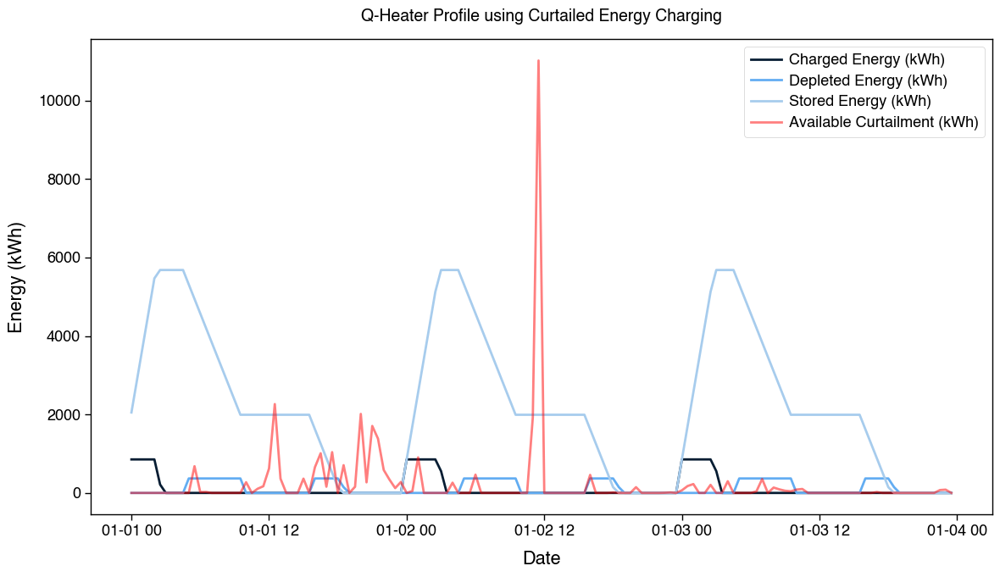

In [200]:
day_2_curtailment = offpeak_heater_demand.head(48*3)
day_2_available_curtailment = df_scaled_merge_lifo.head(48*3)

plt.figure(figsize=(12, 7))
plt.plot(day_2_curtailment.index, day_2_curtailment['qheater_charging_energy_kwh'], label='Charged Energy (kWh)')
plt.plot(day_2_curtailment.index, day_2_curtailment['qheater_depleted_energy_kwh'], label='Depleted Energy (kWh)')
plt.plot(day_2_curtailment.index, day_2_curtailment['qheater_storage_energy_kwh'], label='Stored Energy (kWh)')
plt.plot(day_2_available_curtailment.index, day_2_available_curtailment['curtailed_energy_kwh'], label='Available Curtailment (kWh)', color='red', alpha=0.5)
# plt.plot(day_2_curtailment.index, day_2_curtailment['expected_depletion_kwh'], label='Expected Depletion (kWh)', color='orange', alpha=0.01)
plt.title('Q-Heater Profile using Curtailed Energy Charging')
plt.xlabel('Date')
plt.ylabel('Energy (kWh)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig(FIGURES_PATH / 'figure_4-3.png', dpi=300, bbox_inches='tight')
plt.show()

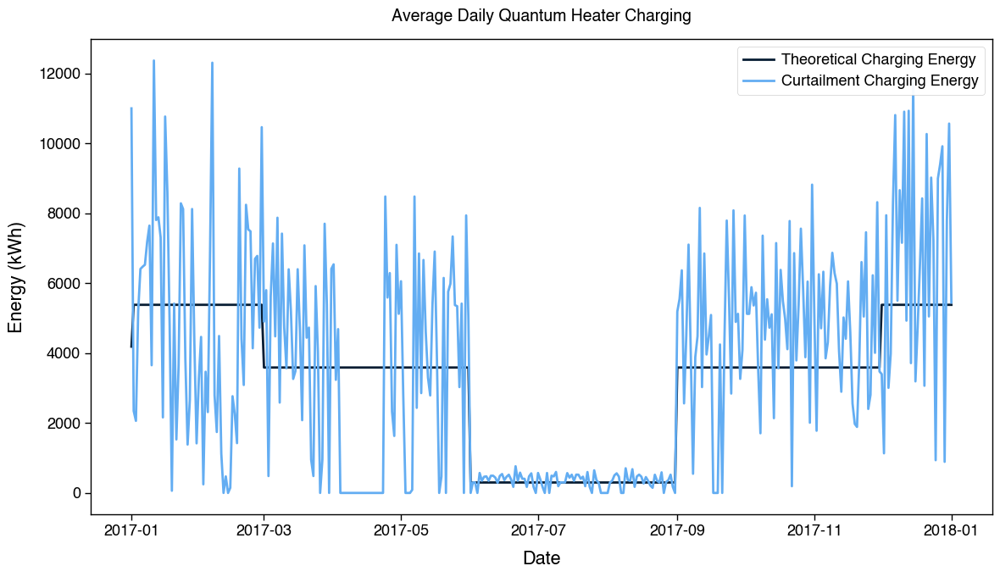

In [129]:
# check how many periods (count) of qheater_chargin_energy_kwh is greater than 0 in a day 
offpeak_daily_charging = (
    offpeak_heater_demand
    .groupby([offpeak_heater_demand.index.date, offpeak_heater_demand.season])
    .agg(
        curtailment_energy_kwh=('curtailment_energy_kwh', 'sum'),
        hours_charging=('qheater_charging_energy_kwh', lambda x: (x > 0).sum() / 2),
        total_charging_energy_kwh=('qheater_charging_energy_kwh', 'sum')
    )
    .reset_index()
    .rename(columns={'level_0': 'date'})
)
curtailment_daily_charging = (
    curtailment_heater_demand
    .groupby([curtailment_heater_demand.index.date, curtailment_heater_demand.season])
    .agg(
        curtailment_energy_kwh=('curtailment_energy_kwh', 'sum'),
        hours_charging=('qheater_charging_energy_kwh', lambda x: (x > 0).sum() / 2),
        total_charging_energy_kwh=('qheater_charging_energy_kwh', 'sum')
    )
    .reset_index()
    .rename(columns={'level_0': 'date'})
)

plt.figure(figsize=(12, 7))
plt.plot(
    offpeak_daily_charging['date'],
    offpeak_daily_charging['total_charging_energy_kwh'],
    label='Theoretical Charging Energy'
)
plt.plot(
    curtailment_daily_charging['date'],
    curtailment_daily_charging['total_charging_energy_kwh'],
    label='Curtailment Charging Energy'
)
plt.title('Average Daily Quantum Heater Charging')
plt.xlabel('Date')
plt.ylabel('Energy (kWh)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

<a id="appendix-4-4"></a>
### Appendix 4.4 – Daily and Annual Impact

In [203]:
heater_charge = ((curtailment_heater_demand['qheater_charging_energy_kwh'].sum() / (10358*qheater_adoption_rate)))
max_heater_charge = ((offpeak_heater_demand['qheater_charging_energy_kwh'].sum() / (10358*qheater_adoption_rate)))

print("Annual heater energy consumption per household using curtailment energy (kWh):", heater_charge)
print("Annual maximum heater energy consumption per household (kWh):", max_heater_charge)

heater_charge_per_day = heater_charge / 365
print("Average daily heater energy consumption per household using curtailment energy (kWh):", heater_charge_per_day)

simulation_summary = pd.DataFrame({
    'Parameter': [
        'Annual heater energy consumption per household using curtailment energy (kWh)',
        'Daily average heater energy consumption per household using curtailment energy (kWh)',
    ],
    'Value': [
        heater_charge,
        heater_charge_per_day
    ]
}).set_index('Parameter')

simulation_summary.to_pickle(TABLES_PATH / 'table_6-4.pkl')
display(simulation_summary)

Annual heater energy consumption per household using curtailment energy (kWh): 2745.6182517637144
Annual maximum heater energy consumption per household (kWh): 2582.0025000000005
Average daily heater energy consumption per household using curtailment energy (kWh): 7.522241785654012


,Value
Parameter,
Annual heater energy consumption per household using curtailment energy (kWh),2745.618252
Daily average heater energy consumption per household using curtailment energy (kWh),7.522242


In [117]:
# Check depleted vs expected depletion
expected_depletion = curtailment_heater_demand['expected_depletion_kwh'].sum()
depleted_energy = curtailment_heater_demand['qheater_depleted_energy_kwh'].sum()
print(f"Expected heating energy need: {expected_depletion:.2f} kWh")
print(f"Realised heating energy: {depleted_energy:.2f} kWh")
print(f"Proportion of heating achieved only by curtailment energy: {(depleted_energy/expected_depletion)*100:.2f}%")

Expected heating energy need: 1829947.86 kWh
Realised heating energy: 1309851.39 kWh
Proportion of heating achieved only by curtailment energy: 71.58%


In [313]:
unrealised_heating_demand_curtailment = (curtailment_heater_demand['expected_depletion_kwh'].sum() - curtailment_heater_demand['qheater_charging_energy_kwh'].sum())

print(f"Annual unrealised heating demand using curtailment (kWh): {unrealised_heating_demand_curtailment:.2f} kWh\n")

unrealsed_heating_demand_curtailment_per_household = unrealised_heating_demand_curtailment / (qheater_adoption_rate * 10358)
print(f"Annual unrealised heating demand using curtailment per household (kWh): {unrealsed_heating_demand_curtailment_per_household:.2f} kWh\n")

Annual unrealised heating demand using curtailment (kWh): 438351.39 kWh

Annual unrealised heating demand using curtailment per household (kWh): 846.40 kWh



<a id="appendix-4-5"></a>
### Appendix 4.5 – Sensitivity Analysis

In [205]:
from joblib import Parallel, delayed
import os

from pandas import DataFrame

os.environ["PYDEVD_DISABLE_FILE_VALIDATION"] = "1"

def simulate_and_label(rate):
    df = simulate_qheater_absorption(
        df_scaled_merge_lifo,
        q_heater,
        season_factors,
        heater_mix,
        rate
    )
    df: DataFrame = df.copy()
    df['adoption_rate'] = rate
    return df

adoption_rate = list(np.round(np.arange(0.00, 1.01, 0.05),2))

# Parallel execution using joblib
results = Parallel(n_jobs=6)(delayed(simulate_and_label)(rate) for rate in adoption_rate)

# Concatenate results into one DataFrame
sensitivity_results = pd.concat(results)

100%|██████████| 17568/17568 [00:00<00:00, 21411.05it/s]


In [206]:
# calculate the total charging energy for each adoption rate
((sensitivity_results.groupby('adoption_rate')['qheater_charging_energy_kwh'].sum())/10**6).reset_index().rename(columns={'qheater_charging_energy_kwh': 'total_charging_energy_gwh'})

,adoption_rate,total_charging_energy_gwh
0,0.00,0.000000
1,0.05,1.421956
2,0.10,2.403950
3,0.15,3.109482
4,0.20,3.682036
5,0.25,4.174852
6,0.30,4.637667
7,0.35,5.074010
8,0.40,5.493548
9,0.45,5.878191


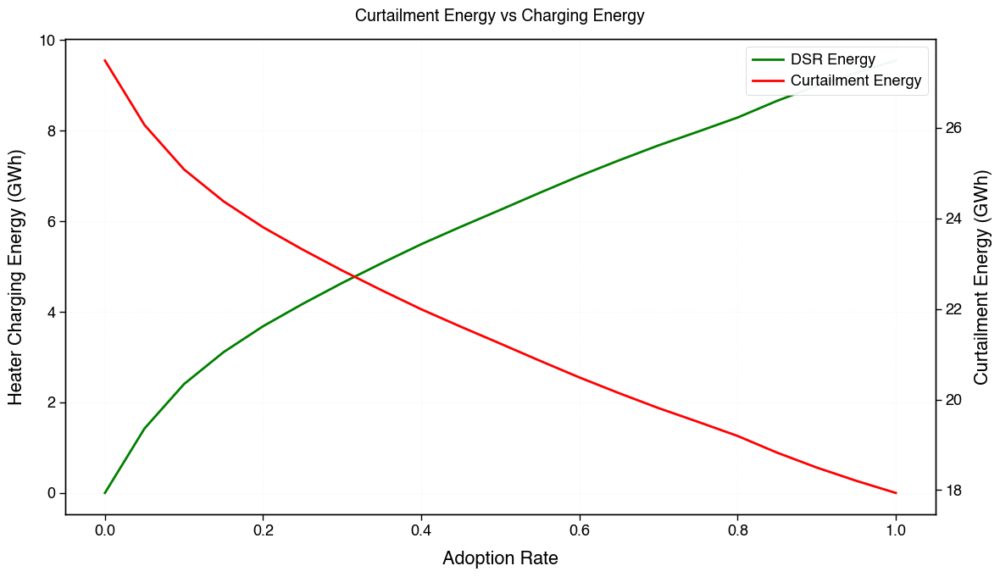

In [209]:
# Precompute the values
adoption_rate = sensitivity_results['adoption_rate'].unique()
adoption_rate.sort()
charging_energy = (
    sensitivity_results.groupby('adoption_rate')['qheater_charging_energy_kwh'].sum()
) / 10**6  # GWh
curtailment_energy = (
    sensitivity_results.groupby('adoption_rate')['curtailment_unabsorbed_energy_kwh'].sum()
) / 10**6  # GWh

# Plotting
fig, ax1 = plt.subplots(figsize=(12, 7))


ax1.set_xlabel('Adoption Rate')
ax1.set_ylabel('Heater Charging Energy (GWh)')
line1, = ax1.plot(adoption_rate, charging_energy, color='green', label='DSR Energy')
ax1.tick_params(axis='y')

# Create a second y-axis sharing the same x-axis
ax2 = ax1.twinx()
ax2.set_ylabel('Curtailment Energy (GWh)')
line2, = ax2.plot(adoption_rate, curtailment_energy, color='red', label='Curtailment Energy')
ax2.tick_params(axis='y')

# Combine both legends
lines = [line1, line2]
labels = [line.get_label() for line in lines]
ax1.legend(lines, labels, loc='upper right')

# Title and layout
plt.title('Curtailment Energy vs Charging Energy')
fig.tight_layout()
plt.grid()
plt.savefig(FIGURES_PATH / 'figure_6-5.png', dpi=300, bbox_inches='tight')
plt.show()